<a href="https://colab.research.google.com/github/RachelRamirez/CIFAR-10/blob/main/CombiningGroups_CIFAR10.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Last changed 11/11 13:09
Reminder to self, please save over AllRuns.ipynb in github/rr/cifar10/collectionoftests

Description:  batches are mixing well, but horrible accuracy for certain images, maybe thats a "good" test result?  About to pass all the groups through the augmentation, maybe 1 hour * 10 groups?  

Still need to do the CSV output

### Imports

In [ ]:
 # I don't want to accidentally restart my notebook so I have a break here. 
# I'm only working from the last part of the notebook where I import the results


#@title import libraries set time
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import copy
import os
import PIL
import PIL.Image
from tensorflow import keras 
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
# import keras.utils -- dont do this!! it causes problems, 
from tensorflow.keras.utils import to_categorical  #do this instead!!
import random
import sklearn
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
import time
import pickle
from google.colab import files
import datetime # to display the current time hh:mm:ss



tic = time.time()  # Start the timer
initial_run = 0

AUTOTUNE = tf.data.experimental.AUTOTUNE
np.set_printoptions(precision=4)

#### Set Random Seeds

In [ ]:
#@title
seed = 42
random.seed(seed)
tf.random.set_seed(seed)
np.random.seed()  # https://stackoverflow.com/questions/11526975/set-random-seed-programwide-in-python
shuffle_seed = seed

# Possibly Need IMGAUG to set seed in ALbumentations
# GitHub Issue: https://github.com/albumentations-team/albumentations/issues/93
import imgaug
imgaug.seed(123)


## ------------------

Set Logic-Values


In [ ]:
run_model = False  #When Im looking at augmentations, I don't want to keep refitting a model, I want to just get the database of images loaded

Make Image Datasets

One of my biggest learning curves was learning how to load  the dataset with tdfs.load() and then filter on images by label.  

The second biggest was using the created model to make predictions on the test set.   

Current but "skipped" problem is trying to view misclassifeid images of results.


Another area of problems is rerunning when you've already specified a batch on your dataset creates another "batch" split so it can cause problems to rerun a cell that says how to define a dataset.  Unbatch may be needed first.    

# **1. Create All DataSets**

### Load Dataset

In [ ]:
#@title


# A weird problem happened where it said the toronto website cant be reached, if that ever happens again make sure to go to SO for this advice https://stackoverflow.com/questions/36805640/this-error-while-downloading-datasets-valueerror-i-o-operation-on-closed-file

# How do I set IDs on: read_config.add_tfds_id = True
read_config = tfds.ReadConfig(shuffle_seed=seed) 
read_config.add_tfds_id = True  ## This didnt update ReadConfig 

dataset, info = tfds.load('cifar10', as_supervised=True, with_info=True, read_config=read_config)
x_test =  dataset["test"]
dataset  = dataset["train"]
assert isinstance(x_test, tf.data.Dataset)
#x_test = [(example.numpy(), label.numpy()) for example, label in x_test]
# once broken into numpy arrays, my model still doesn't handle it, it seems to be expecting a tensor
# So i think i have to break it into two tensors?  test_x, test_y?
# x_test[0][0]
# x_test[0][1]
# x_test = pd.DataFrame(x_test, columns=['example', 'label'])
# x_test = tf.data.Dataset.from_generator(lambda: x_test, (tf.int64, tf.int16))
# x_list = list(x_test.as_numpy_iterator())  # Crashes Google Colab!
# print(x_list[:5])


#  I got this from stack-overflow.  Need this code to define y_test, the labels of testset

def get_labels_from_tfdataset(tfdataset, batched=False):
    labels = list(map(lambda x: x[1], tfdataset)) # Get labels 
    if not batched:
        return tf.concat(labels, axis=0) # concat the list of batched labels
    return labels
y_test = get_labels_from_tfdataset(x_test)

# tfds.as_dataframe(dataset.take(5), info)  #does not display image ID :-( )

dataset_airplanes   = dataset.filter(lambda img, label: label == 0)
dataset_automobiles = dataset.filter(lambda img, label: label == 1)
dataset_birds       = dataset.filter(lambda img, label: label == 2)
dataset_cats        = dataset.filter(lambda img, label: label == 3)
dataset_deers       = dataset.filter(lambda img, label: label == 4)
dataset_dogs        = dataset.filter(lambda img, label: label == 5)
dataset_frogs       = dataset.filter(lambda img, label: label == 6)
dataset_horses      = dataset.filter(lambda img, label: label == 7)
dataset_ships       = dataset.filter(lambda img, label: label == 8)
dataset_trucks      = dataset.filter(lambda img, label: label == 9)

##  Ways to count the number of images in the sets:
print("There are ways to count and verify the number per training set which i have hidden because they are costly")
print("Entire Training Dataset was originally cardinality:", tf.data.experimental.cardinality(dataset).numpy()) #   prints 50,000, correct
print("Entire Airplane Training Dataset was originally cardinality:", tf.data.experimental.cardinality(dataset_airplanes).numpy()) #   prints -2 this is a "feature" in tf when a set takes too long to count
# print(dataset_airplanes.reduce(np.int64(0), lambda x,_ : x + 1).numpy()) #prints 5000, correct

##  This is a way of asserting that all the images have the same label in a set
# for img, label in dataset_dogs:
#   assert label == 5
 

There are ways to count and verify the number per training set which i have hidden because they are costly
Entire Training Dataset was originally cardinality: 50000
Entire Airplane Training Dataset was originally cardinality: -2


### Show Examples in the Three Train/Val/Test Sets.  Count CIFAR 10 Functions

In [ ]:
#@title 'count_cifar10_class' { form-width: "1px" }
# define a fuction to count the numbre of each class
# I'm not going to worry about it now, but if i had time to cleanup code I would 
# Try to use this type of if/zip structure  https://stackoverflow.com/questions/57784643/if-statement-and-zip



 
def count_cifar10_class(datasetpassed):
  # takes the datasetpassed and returns the number of each category as a ten-tupple
  num_airplanes, num_automobiles, num_birds, num_cats, num_deers = 0,0,0,0,0
  num_dogs, num_frogs, num_horses, num_ships, num_trucks= 0, 0, 0,0,0


  # print("Unbatched?" , check_if_unbatched(datasetpassed))
  # print("Take?", check_if_take(datasetpassed))
  # print("Unbatched or Take?", ( check_if_unbatched(datasetpassed) or  check_if_take(datasetpassed)))

  if ( check_if_unbatched(datasetpassed) or  check_if_take(datasetpassed)):
    if check_if_take(datasetpassed):
      datasetpassed = make_unbatched(datasetpassed)

    for img, label in datasetpassed:
      if label == 0:
        num_airplanes += 1

      if label == 1:
        num_automobiles += 1

      if label == 2:
        num_birds +=1

      if label == 3:
        num_cats +=1

      if label ==4: 
        num_deers += 1

      if label == 5:
        num_dogs += 1 

      if label == 6:
          num_frogs += 1

      if label == 7:
        num_horses += 1

      if label == 8:
        num_ships +=1 

      if label == 9: 
        num_trucks +=1
    
    return num_airplanes, num_automobiles, num_birds, num_cats, num_deers, num_dogs, num_frogs, num_horses, num_ships, num_trucks 
  # else if the dataset is not batched or if one batch from take is being passed, proceed to counting thing below 
  else:
    print(" ** Dataset is batched, please pass 1 batch at a time to cifar10 to see metrics ** ")



  




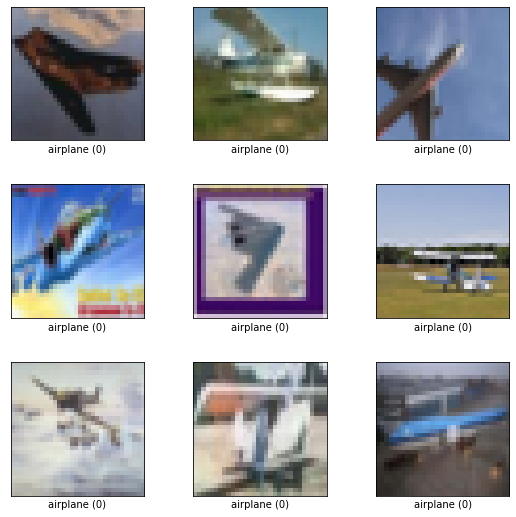

In [ ]:
#@title ShowExamplesofDatasetAirplanes
## Tfds.show_examples is a matplotlib funnction that only works on image ds's, and you have to pass it the "info" for some reason
fig = tfds.show_examples(dataset_airplanes, info)

How to display one picture of a dataset using `next(iter(dataset)`

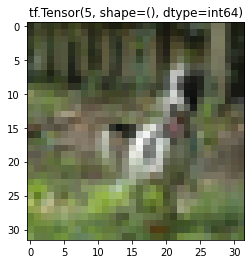

In [ ]:
#@title ShowExampleofOneIterations of DatasetDogs { form-width: "20px" }
# I wish I could display ID!!

img, label = next(iter(dataset_dogs))
plt.title(str(label))
plt.imshow(img)

#0x7f6e309eff10?


## Create validation set of 10,000 images

In [ ]:
#@title
# I want 10 un replicated samples from dataset_airplanes + dataset_automobiles... dataset_trucks.

# There are 5000 images of each Class 
# I want 10 equal sets A, B, C, D, ... J plus a validation set
# I want 10,000 total images in the validation set with 1000 of each class
# and I want 10 sets of training images  4000 total images, so 400 images in each class

N = 1000
dataset_airplanes_val   = dataset_airplanes.take(N)
dataset_automobiles_val  = dataset_automobiles.take(N)
dataset_birds_val       = dataset_birds.take(N)  
dataset_cats_val        = dataset_cats.take(N)
dataset_deers_val       = dataset_deers.take(N)
dataset_dogs_val        = dataset_dogs.take(N)
dataset_frogs_val       = dataset_frogs.take(N)
dataset_horses_val      = dataset_horses.take(N)
dataset_ships_val       = dataset_ships.take(N)
dataset_trucks_val      = dataset_trucks.take(N)


# Make sure to skip the next 1000 images in each data set before making training set
dataset_airplanes   = dataset_airplanes.skip(N)
dataset_automobiles  = dataset_automobiles.skip(N)
dataset_birds      = dataset_birds.skip(N)  
dataset_cats        = dataset_cats.skip(N)
dataset_deers       = dataset_deers.skip(N)
dataset_dogs        = dataset_dogs.skip(N)
dataset_frogs       = dataset_frogs.skip(N)
dataset_horses      = dataset_horses.skip(N)
dataset_ships       = dataset_ships.skip(N)
dataset_trucks      = dataset_trucks.skip(N)

# # Check that remaining dataset does not have validation data
# fig = tfds.show_examples(dataset_ships, info)
# fig = tfds.show_examples(dataset_ships_val, info)
# # I checked and they dont.


# NOW, How do I combine my val sets?

# Hint1 its not this... 
# val = dataset_airplanes_val + dataset_automobile_val + dataset_birds_val

# #  Hint2 its also not this implementation of zip because the info file doesn't match it
# val = tf.data.Dataset.zip((dataset_airplanes_val,
#                     dataset_automobile_val,
#                     dataset_birds_val,
#                     dataset_cats_val,
#                     dataset_deers_val,
#                     dataset_dogs_val,
#                     dataset_frogs_val,
#                     dataset_horses_val,
#                     dataset_ships_val,
#                     dataset_trucks_val ))
 
# fig = tfds.show_examples(val, info)   # Returns a warning that the info file is not compatible


# is it concatenate? YESSSSSSSSSSSSSSSSSSSSSS
val = dataset_airplanes_val.concatenate(dataset_automobiles_val)
# This is how I checked that it worked
# fig = tfds.show_examples(val.skip(999), info)    # shows 1 airplane and then 8 automobiles

val = val.concatenate(dataset_birds_val)
val = val.concatenate(dataset_cats_val)
val = val.concatenate(dataset_deers_val)
val = val.concatenate(dataset_dogs_val)
val = val.concatenate(dataset_frogs_val)
val = val.concatenate(dataset_horses_val)
val = val.concatenate(dataset_ships_val)
val = val.concatenate(dataset_trucks_val)
  
# print(val.reduce(np.int32(0), lambda x,_ : x + 1))  # this shows 10000! Thank goodness! :-)



## Create smaller training groups of each CIFAR Class sets (set Shard)

After removing the 10,000 validation set from the training-data, the remaining set has 40,000 images, 4000 images of each class.  To create smaller training-datasets of similar sizes, shard the dataset into equal pieces.

For the initial days of testing I decided on **250 images** per class for my first couple runs, which equates to 16 shards (40,000/16 = 250) .  When I wanted to study what was going on more beneath the hood for my augmentations, I decided to make the training set even more tiny so I could view all the images per training set I decided to try 1 image per class so I could easily view all the images augmeted and not augmented.  This meant I needed **4000 shards!** for troubleshooting.



In [ ]:
SHARDS=16

 Airplanes (airplanes_A, ... airplanes_P)

In [ ]:
#@title
# https://www.tensorflow.org/api_docs/python/tf/data/Dataset#shard

# Check that each of the remaining 10 datasets has only 4000 images 
# print(dataset_airplanes.reduce(np.int32(0), lambda x,_ : x + 1))  # 4000 check!

# Shard each of the remaining 10 datasets into 16 smaller groups
airplanes_A = dataset_airplanes.shard(num_shards=SHARDS, index = 0)
airplanes_B = dataset_airplanes.shard(num_shards=SHARDS, index = 1)
airplanes_C = dataset_airplanes.shard(num_shards=SHARDS, index = 2)
airplanes_D = dataset_airplanes.shard(num_shards=SHARDS, index = 3)
airplanes_E = dataset_airplanes.shard(num_shards=SHARDS, index = 4)
airplanes_F = dataset_airplanes.shard(num_shards=SHARDS, index = 5)
airplanes_G = dataset_airplanes.shard(num_shards=SHARDS, index = 6)
airplanes_H = dataset_airplanes.shard(num_shards=SHARDS, index = 7)
airplanes_I = dataset_airplanes.shard(num_shards=SHARDS, index = 8)
airplanes_J = dataset_airplanes.shard(num_shards=SHARDS, index = 9)
airplanes_K = dataset_airplanes.shard(num_shards=SHARDS, index = 10)
airplanes_L = dataset_airplanes.shard(num_shards=SHARDS, index = 11)
airplanes_M = dataset_airplanes.shard(num_shards=SHARDS, index = 12)
airplanes_N = dataset_airplanes.shard(num_shards=SHARDS, index = 13)
airplanes_O = dataset_airplanes.shard(num_shards=SHARDS, index = 14)
airplanes_P = dataset_airplanes.shard(num_shards=SHARDS, index = 15)

#check that a random airplane dataset only has 250 images
# print(airplanes_M.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!


 Automobiles

In [ ]:
#@title
# dataset_automobile

# Check that each of the remaining 10 datasets has only 4000 images 
# print(dataset_automobile.reduce(np.int32(0), lambda x,_ : x + 1))  # 4000 check!

# Shard each of the remaining 10 datasets into 16 smaller groups
automobiles_A = dataset_automobiles.shard(num_shards=SHARDS, index = 0)
automobiles_B = dataset_automobiles.shard(num_shards=SHARDS, index = 1)
automobiles_C = dataset_automobiles.shard(num_shards=SHARDS, index = 2)
automobiles_D = dataset_automobiles.shard(num_shards=SHARDS, index = 3)
automobiles_E = dataset_automobiles.shard(num_shards=SHARDS, index = 4)
automobiles_F = dataset_automobiles.shard(num_shards=SHARDS, index = 5)
automobiles_G = dataset_automobiles.shard(num_shards=SHARDS, index = 6)
automobiles_H = dataset_automobiles.shard(num_shards=SHARDS, index = 7)
automobiles_I = dataset_automobiles.shard(num_shards=SHARDS, index = 8)
automobiles_J = dataset_automobiles.shard(num_shards=SHARDS, index = 9)
automobiles_K = dataset_automobiles.shard(num_shards=SHARDS, index = 10)
automobiles_L = dataset_automobiles.shard(num_shards=SHARDS, index = 11)
automobiles_M = dataset_automobiles.shard(num_shards=SHARDS, index = 12)
automobiles_N = dataset_automobiles.shard(num_shards=SHARDS, index = 13)
automobiles_O = dataset_automobiles.shard(num_shards=SHARDS, index = 14)
automobiles_P = dataset_automobiles.shard(num_shards=SHARDS, index = 15)


#check that a random airplane dataset only has 250 images
# print(airplanes_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

 Birds

In [ ]:
#@title
# dataset_birds

# Shard each of the remaining 10 datasets into 16 smaller groups
birds_A = dataset_birds.shard(num_shards=SHARDS, index = 0)
birds_B = dataset_birds.shard(num_shards=SHARDS, index = 1)
birds_C = dataset_birds.shard(num_shards=SHARDS, index = 2)
birds_D = dataset_birds.shard(num_shards=SHARDS, index = 3)
birds_E = dataset_birds.shard(num_shards=SHARDS, index = 4)
birds_F = dataset_birds.shard(num_shards=SHARDS, index = 5)
birds_G = dataset_birds.shard(num_shards=SHARDS, index = 6)
birds_H = dataset_birds.shard(num_shards=SHARDS, index = 7)
birds_I = dataset_birds.shard(num_shards=SHARDS, index = 8)
birds_J = dataset_birds.shard(num_shards=SHARDS, index = 9)
birds_K = dataset_birds.shard(num_shards=SHARDS, index = 10)
birds_L = dataset_birds.shard(num_shards=SHARDS, index = 11)
birds_M = dataset_birds.shard(num_shards=SHARDS, index = 12)
birds_N = dataset_birds.shard(num_shards=SHARDS, index = 13)
birds_O = dataset_birds.shard(num_shards=SHARDS, index = 14)
birds_P = dataset_birds.shard(num_shards=SHARDS, index = 15)

#check that a random airplane dataset only has 250 images
# print(airplanes_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

 Cats

In [ ]:
#@title
# dataset_cats

# Shard each of the remaining 10 datasets into 16 smaller groups
cats_A = dataset_cats.shard(num_shards=SHARDS, index = 0)
cats_B = dataset_cats.shard(num_shards=SHARDS, index = 1)
cats_C = dataset_cats.shard(num_shards=SHARDS, index = 2)
cats_D = dataset_cats.shard(num_shards=SHARDS, index = 3)
cats_E = dataset_cats.shard(num_shards=SHARDS, index = 4)
cats_F = dataset_cats.shard(num_shards=SHARDS, index = 5)
cats_G = dataset_cats.shard(num_shards=SHARDS, index = 6)
cats_H = dataset_cats.shard(num_shards=SHARDS, index = 7)
cats_I = dataset_cats.shard(num_shards=SHARDS, index = 8)
cats_J = dataset_cats.shard(num_shards=SHARDS, index = 9)
cats_K = dataset_cats.shard(num_shards=SHARDS, index = 10)
cats_L = dataset_cats.shard(num_shards=SHARDS, index = 11)
cats_M = dataset_cats.shard(num_shards=SHARDS, index = 12)
cats_N = dataset_cats.shard(num_shards=SHARDS, index = 13)
cats_O = dataset_cats.shard(num_shards=SHARDS, index = 14)
cats_P = dataset_cats.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(cats_P.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

 Deer(s)

In [ ]:
#@title
# dataset_deers
# Shard each of the remaining 10 datasets into 16 smaller groups
deers_A = dataset_deers.shard(num_shards=SHARDS, index = 0)
deers_B = dataset_deers.shard(num_shards=SHARDS, index = 1)
deers_C = dataset_deers.shard(num_shards=SHARDS, index = 2)
deers_D = dataset_deers.shard(num_shards=SHARDS, index = 3)
deers_E = dataset_deers.shard(num_shards=SHARDS, index = 4)
deers_F = dataset_deers.shard(num_shards=SHARDS, index = 5)
deers_G = dataset_deers.shard(num_shards=SHARDS, index = 6)
deers_H = dataset_deers.shard(num_shards=SHARDS, index = 7)
deers_I = dataset_deers.shard(num_shards=SHARDS, index = 8)
deers_J = dataset_deers.shard(num_shards=SHARDS, index = 9)
deers_K = dataset_deers.shard(num_shards=SHARDS, index = 10)
deers_L = dataset_deers.shard(num_shards=SHARDS, index = 11)
deers_M = dataset_deers.shard(num_shards=SHARDS, index = 12)
deers_N = dataset_deers.shard(num_shards=SHARDS, index = 13)
deers_O = dataset_deers.shard(num_shards=SHARDS, index = 14)
deers_P = dataset_deers.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(deers_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

 Dogs

In [ ]:
#@title
# dataset_dogs
# Shard each of the remaining 10 datasets into 16 smaller groups
dogs_A = dataset_dogs.shard(num_shards=SHARDS, index = 0)
dogs_B = dataset_dogs.shard(num_shards=SHARDS, index = 1)
dogs_C = dataset_dogs.shard(num_shards=SHARDS, index = 2)
dogs_D = dataset_dogs.shard(num_shards=SHARDS, index = 3)
dogs_E = dataset_dogs.shard(num_shards=SHARDS, index = 4)
dogs_F = dataset_dogs.shard(num_shards=SHARDS, index = 5)
dogs_G = dataset_dogs.shard(num_shards=SHARDS, index = 6)
dogs_H = dataset_dogs.shard(num_shards=SHARDS, index = 7)
dogs_I = dataset_dogs.shard(num_shards=SHARDS, index = 8)
dogs_J = dataset_dogs.shard(num_shards=SHARDS, index = 9)
dogs_K = dataset_dogs.shard(num_shards=SHARDS, index = 10)
dogs_L = dataset_dogs.shard(num_shards=SHARDS, index = 11)
dogs_M = dataset_dogs.shard(num_shards=SHARDS, index = 12)
dogs_N = dataset_dogs.shard(num_shards=SHARDS, index = 13)
dogs_O = dataset_dogs.shard(num_shards=SHARDS, index = 14)
dogs_P = dataset_dogs.shard(num_shards=SHARDS, index = 15)

#check that a random airplane dataset only has 250 images
# print(dogs_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!


 Frogs

In [ ]:
#@title
# dataset_frogs
# Shard each of the remaining 10 datasets into 16 smaller groups
frogs_A = dataset_frogs.shard(num_shards=SHARDS, index = 0)
frogs_B = dataset_frogs.shard(num_shards=SHARDS, index = 1)
frogs_C = dataset_frogs.shard(num_shards=SHARDS, index = 2)
frogs_D = dataset_frogs.shard(num_shards=SHARDS, index = 3)
frogs_E = dataset_frogs.shard(num_shards=SHARDS, index = 4)
frogs_F = dataset_frogs.shard(num_shards=SHARDS, index = 5)
frogs_G = dataset_frogs.shard(num_shards=SHARDS, index = 6)
frogs_H = dataset_frogs.shard(num_shards=SHARDS, index = 7)
frogs_I = dataset_frogs.shard(num_shards=SHARDS, index = 8)
frogs_J = dataset_frogs.shard(num_shards=SHARDS, index = 9)
frogs_K = dataset_frogs.shard(num_shards=SHARDS, index = 10)
frogs_L = dataset_frogs.shard(num_shards=SHARDS, index = 11)
frogs_M = dataset_frogs.shard(num_shards=SHARDS, index = 12)
frogs_N = dataset_frogs.shard(num_shards=SHARDS, index = 13)
frogs_O = dataset_frogs.shard(num_shards=SHARDS, index = 14)
frogs_P = dataset_frogs.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(frogs_A.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

 Horses

In [ ]:
#@title
# dataset_horses
# Shard each of the remaining 10 datasets into 16 smaller groups
horses_A = dataset_horses.shard(num_shards=SHARDS, index = 0)
horses_B = dataset_horses.shard(num_shards=SHARDS, index = 1)
horses_C = dataset_horses.shard(num_shards=SHARDS, index = 2)
horses_D = dataset_horses.shard(num_shards=SHARDS, index = 3)
horses_E = dataset_horses.shard(num_shards=SHARDS, index = 4)
horses_F = dataset_horses.shard(num_shards=SHARDS, index = 5)
horses_G = dataset_horses.shard(num_shards=SHARDS, index = 6)
horses_H = dataset_horses.shard(num_shards=SHARDS, index = 7)
horses_I = dataset_horses.shard(num_shards=SHARDS, index = 8)
horses_J = dataset_horses.shard(num_shards=SHARDS, index = 9)
horses_K = dataset_horses.shard(num_shards=SHARDS, index = 10)
horses_L = dataset_horses.shard(num_shards=SHARDS, index = 11)
horses_M = dataset_horses.shard(num_shards=SHARDS, index = 12)
horses_N = dataset_horses.shard(num_shards=SHARDS, index = 13)
horses_O = dataset_horses.shard(num_shards=SHARDS, index = 14)
horses_P = dataset_horses.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(horses_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

 Ships

In [ ]:
#@title
# dataset_ships
# Shard each of the remaining 10 datasets into 16 smaller groups
ships_A = dataset_ships.shard(num_shards=SHARDS, index = 0)
ships_B = dataset_ships.shard(num_shards=SHARDS, index = 1)
ships_C = dataset_ships.shard(num_shards=SHARDS, index = 2)
ships_D = dataset_ships.shard(num_shards=SHARDS, index = 3)
ships_E = dataset_ships.shard(num_shards=SHARDS, index = 4)
ships_F = dataset_ships.shard(num_shards=SHARDS, index = 5)
ships_G = dataset_ships.shard(num_shards=SHARDS, index = 6)
ships_H = dataset_ships.shard(num_shards=SHARDS, index = 7)
ships_I = dataset_ships.shard(num_shards=SHARDS, index = 8)
ships_J = dataset_ships.shard(num_shards=SHARDS, index = 9)
ships_K = dataset_ships.shard(num_shards=SHARDS, index = 10)
ships_L = dataset_ships.shard(num_shards=SHARDS, index = 11)
ships_M = dataset_ships.shard(num_shards=SHARDS, index = 12)
ships_N = dataset_ships.shard(num_shards=SHARDS, index = 13)
ships_O = dataset_ships.shard(num_shards=SHARDS, index = 14)
ships_P = dataset_ships.shard(num_shards=SHARDS, index = 15)
#check that a random airplane dataset only has 250 images
# print(ships_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!

 Trucks


In [ ]:
#@title
# dataset_trucks
# Shard each of the remaining 10 datasets into 16 smaller groups
trucks_A = dataset_trucks.shard(num_shards=SHARDS, index = 0)
trucks_B = dataset_trucks.shard(num_shards=SHARDS, index = 1)
trucks_C = dataset_trucks.shard(num_shards=SHARDS, index = 2)
trucks_D = dataset_trucks.shard(num_shards=SHARDS, index = 3)
trucks_E = dataset_trucks.shard(num_shards=SHARDS, index = 4)
trucks_F = dataset_trucks.shard(num_shards=SHARDS, index = 5)
trucks_G = dataset_trucks.shard(num_shards=SHARDS, index = 6)
trucks_H = dataset_trucks.shard(num_shards=SHARDS, index = 7)
trucks_I = dataset_trucks.shard(num_shards=SHARDS, index = 8)
trucks_J = dataset_trucks.shard(num_shards=SHARDS, index = 9)
trucks_K = dataset_trucks.shard(num_shards=SHARDS, index = 10)
trucks_L = dataset_trucks.shard(num_shards=SHARDS, index = 11)
trucks_M = dataset_trucks.shard(num_shards=SHARDS, index = 12)
trucks_N = dataset_trucks.shard(num_shards=SHARDS, index = 13)
trucks_O = dataset_trucks.shard(num_shards=SHARDS, index = 14)
trucks_P = dataset_trucks.shard(num_shards=SHARDS, index = 15)


#check that a random airplane dataset only has 250 images
# print(trucks_H.reduce(np.int32(0), lambda x,_ : x + 1))  # 250 check!


### New Groups: A (trainA)
I discovered a better way to zip, batch, my training sets.


#### Admin functions

In [ ]:
#@title
# #@title admin fxs to print out code  / future users wont need to rerun
# # here i create text that i can copy and paste into code-cells
# from itertools import cycle
# #https://stackoverflow.com/questions/19686533/how-to-zip-two-differently-sized-lists

# letter="A"
# def printoutlistofsubsets(letter):
#   listofobjects  = ("airplanes_", "automobiles_", "birds_", "cats_", "deers_", 
#                     "dogs_", "frogs_", "horses_", "ships_", "trucks_")
#   print("train", letter, "_subsets = ("   ,sep="" , end = "")
#   counter=0
#   for i in listofobjects:
#     counter+=1
#     if counter<10:
#       print( i,letter, ", " ,sep="", end="")
#     else:
#       print(i,letter , sep="", end=" ")
#   print(")"    )

# for i in list(["A", "B", "C", "D", "E", "F", "G", "H", "I", "J"]):
#   printoutlistofsubsets(i) #I  manually copy/paste the output to run as future code

Define Zip Function

it's defined as zip_9 below need to move it up here

In [ ]:
 #@title def zip_9_sets()
def zip_9_sets(tuple_of_9_subsets_to_zip, opttext="9 Sets Zipped and Concatenated"):
  combined = tf.data.Dataset.zip((tuple_of_9_subsets_to_zip)).flat_map(
    lambda x0, x1, x2, x3, x4, x5,x6,x7,x8,x9:
     tf.data.Dataset.from_tensors(x0).concatenate(
        tf.data.Dataset.from_tensors(x1).concatenate(
            tf.data.Dataset.from_tensors(x2).concatenate(
                tf.data.Dataset.from_tensors(x3).concatenate(
                     tf.data.Dataset.from_tensors(x4).concatenate(
                          tf.data.Dataset.from_tensors(x5).concatenate(
                               tf.data.Dataset.from_tensors(x6).concatenate(
                                    tf.data.Dataset.from_tensors(x7).concatenate(
                                         tf.data.Dataset.from_tensors(x8).concatenate(
                                              tf.data.Dataset.from_tensors(x9))
                               )
                          )
                     )
                )
            )
          )
      )
    ))
  print(opttext)
  return combined



Define Zip2 Sets so I can Zip Together Alb+ No_Alb

In [ ]:
#@title def zip_2_sets()
def zip_2_sets(tuple_of_2_subsets_to_zip, opttext="Two Sets Zipped and Concatenated"):
  combined = tf.data.Dataset.zip((tuple_of_2_subsets_to_zip)).flat_map(
    lambda x0, x1:
     tf.data.Dataset.from_tensors(x0).concatenate(
        tf.data.Dataset.from_tensors(x1)))
  
  print(opttext)
  return combined

In [ ]:
# #@title admin fxs to print out code2  / future users wont need to rerun
# def printoutzip9sets(letter):
#   print("train", letter, " = zip_9_sets(train", letter, "_subsets,", " opttext= \"train", letter, " defined \" )",sep="" )
   
# for i in list(["A", "B", "C", "D", "E", "F", "G", "H", "I", "J"]):
#   printoutzip9sets(i) #I  manually copy/paste the output to run as future code



### Create subset tuples

In [ ]:
trainA_subsets = (airplanes_A, automobiles_A, birds_A, cats_A, deers_A, dogs_A, frogs_A, horses_A, ships_A, trucks_A )
trainB_subsets = (airplanes_B, automobiles_B, birds_B, cats_B, deers_B, dogs_B, frogs_B, horses_B, ships_B, trucks_B )
trainC_subsets = (airplanes_C, automobiles_C, birds_C, cats_C, deers_C, dogs_C, frogs_C, horses_C, ships_C, trucks_C )
trainD_subsets = (airplanes_D, automobiles_D, birds_D, cats_D, deers_D, dogs_D, frogs_D, horses_D, ships_D, trucks_D )
trainE_subsets = (airplanes_E, automobiles_E, birds_E, cats_E, deers_E, dogs_E, frogs_E, horses_E, ships_E, trucks_E )
trainF_subsets = (airplanes_F, automobiles_F, birds_F, cats_F, deers_F, dogs_F, frogs_F, horses_F, ships_F, trucks_F )
trainG_subsets = (airplanes_G, automobiles_G, birds_G, cats_G, deers_G, dogs_G, frogs_G, horses_G, ships_G, trucks_G )
trainH_subsets = (airplanes_H, automobiles_H, birds_H, cats_H, deers_H, dogs_H, frogs_H, horses_H, ships_H, trucks_H )
trainI_subsets = (airplanes_I, automobiles_I, birds_I, cats_I, deers_I, dogs_I, frogs_I, horses_I, ships_I, trucks_I )
trainJ_subsets = (airplanes_J, automobiles_J, birds_J, cats_J, deers_J, dogs_J, frogs_J, horses_J, ships_J, trucks_J )

## Create Training Sets A through J, and AB, CD, EF, GH, ABCD, EFGH, ABCDEFGH

In [ ]:
trainA = zip_9_sets(trainA_subsets, opttext= "trainA defined " )
trainB = zip_9_sets(trainB_subsets, opttext= "trainB defined " )
trainC = zip_9_sets(trainC_subsets, opttext= "trainC defined " )
trainD = zip_9_sets(trainD_subsets, opttext= "trainD defined " )
trainE = zip_9_sets(trainE_subsets, opttext= "trainE defined " )
trainF = zip_9_sets(trainF_subsets, opttext= "trainF defined " )
trainG = zip_9_sets(trainG_subsets, opttext= "trainG defined " )
trainH = zip_9_sets(trainH_subsets, opttext= "trainH defined " )
# trainI = zip_9_sets(trainI_subsets, opttext= "trainI defined " )
# trainJ = zip_9_sets(trainJ_subsets, opttext= "trainJ defined " )

#I decided I don' want to zip,  I rather concatenate, otherwise I'm going to be seeing the same image over and over again... plus its faster

trainAB = trainA.concatenate(trainB)
trainCD = trainC.concatenate(trainD)
trainEF = trainE.concatenate(trainF)
trainGH = trainG.concatenate(trainH)

# trainCD = zip_2_sets((trainC, trainD), opttext="trainCD defined")
# trainEF = zip_2_sets((trainE, trainF), opttext="trainEF defined")
# trainGH = zip_2_sets((trainG, trainH), opttext="trainGH defined")
# # trainIJ = zip_2_sets((trainI, trainJ), opttext="trainIJ defined")

trainABCD = trainAB.concatenate(trainCD)
trainEFGH = trainEF.concatenate(trainGH)

# trainABCD = zip_2_sets((trainAB, trainCD), opttext="trainABCD defined")
# trainEFGH = zip_2_sets((trainEF, trainGH), opttext="trainEFGH defined")

trainABCDEFGH = trainABCD.concatenate(trainEFGH)
# trainABCDEFGH = zip_2_sets((trainABCD, trainEFGH), opttext="trainABCDEFGH defined")



# trainAB = zip_2_sets((trainA, trainB), opttext="trainAB defined")
# trainCD = zip_2_sets((trainC, trainD), opttext="trainCD defined")
# trainEF = zip_2_sets((trainE, trainF), opttext="trainEF defined")
# trainGH = zip_2_sets((trainG, trainH), opttext="trainGH defined")
# # trainIJ = zip_2_sets((trainI, trainJ), opttext="trainIJ defined")

# trainABCD = zip_2_sets((trainAB, trainCD), opttext="trainABCD defined")
# trainEFGH = zip_2_sets((trainEF, trainGH), opttext="trainEFGH defined")

# trainABCDEFGH = zip_2_sets((trainABCD, trainEFGH), opttext="trainABCDEFGH defined")

<ConcatenateDataset shapes: ((32, 32, 3), ()), types: (tf.uint8, tf.int64)>

Testing out whether I can see IDs again...

I added some code before the lines to load dataset, they are as follows#
from https://www.tensorflow.org/datasets/api_docs/python/tfds/load#args
and https://www.tensorflow.org/datasets/determinism



> read_config code added


```
read_config = tfds.ReadConfig(shuffle_seed=seed) 
read_config.add_tfds_id = True
dataset, info = tfds.load('cifar10', as_supervised=True, with_info=True, read_config=read_config)
```


I want to make sure the rest of my scripts run fine before any more tinkering!

In [ ]:
# # I believe I need to define the shuffle number for the Train_A set by using the total number of images in it, not just an arbitrarily large number?
# # count = count_images(trainA)
# # unbatch_trainA = (tf.data.Dataset.unbatch(trainA))
# # count = count_images(unbatch_trainA)

# #this changes everytime i run it

# # for id, img, label in unbatch_trainA:
# #   print(label)  # this appears to be the labels of the image in unbatchtrainA (7, 6, 4, 2, 1, 3, 9, 5, 8, 0)
# #   #print(img)  # these are each of the images 32*32*3
# #   print(id)
 
# tfds.as_dataframe(dataset.take(5), info)  #it doesn't look like IDS is being returned in info

# print(info)


The result of running `print(info)`:

> CIFAR10 Info
```
tfds.core.DatasetInfo(    
    name='cifar10',
    version=3.0.2,    
    description='The CIFAR-10 dataset consists of 60000 32x32 colour images in 10 classes, with 6000 images per class. There are 50000 training images and 10000 test images.',   
    homepage='https://www.cs.toronto.edu/~kriz/cifar.html',   
    features=FeaturesDict({   
        'id': Text(shape=(), dtype=tf.string),   
        'image': Image(shape=(32, 32, 3), dtype=tf.uint8),   
        'label': ClassLabel(shape=(), dtype=tf.int64, num_classes=10),   
    }),   
    total_num_examples=60000,   
    splits={   
        'test': 10000,   
        'train': 50000,   
    },   
    supervised_keys=('image', 'label'),   
    citation="""@TECHREPORT{Krizhevsky09learningmultiple,   
        author = {Alex Krizhevsky},   
        title = {Learning multiple layers of features from tiny images},   
        institution = {},  
        year = {2009}   
    }""",   
    redistribution_info=,   
)
```
 




## Define dataset functions to make (view_image(ds) function work

In [ ]:
#@title define CLASSES
# The augmented data returns floats between 0 and 1
# The unaugmented data is integers uint8 between 0 and 255 
CLASSES = info.features['label'].names

# This may help mm one day with trying to get into the ID of each batch/mislabelled image
# info.features['id']


In [ ]:
#@title def check_if_unbatched(ds): { form-width: "20px" }
def check_if_unbatched(ds):
  if (ds.__class__.__name__ !='BatchDataset') and (ds._input_dataset.__class__.__name__ != 'BatchDataset') :
     return True
  else:
    return False

In [ ]:
#@title def check_if_batched(ds): { form-width: "20px" }
def check_if_batched(ds):
  if (ds.__class__.__name__ =='BatchDataset') or (ds._input_dataset.__class__.__name__ == 'BatchDataset')  :
     # the above statement will evaluate to True if three subsets of the original ds are not batched
      return True
  else:
    return False

In [ ]:
#@title def check_if_take(ds): { form-width: "20px" }

def check_if_take(ds):
  if  (ds.__class__.__name__ =='TakeDataset'):
    return True
  else:
    return False

In [ ]:
#@title def inprogress check_if_zipped(ds): { form-width: "20px" }

def check_if_zipped(ds):
  if  (ds.__class__.__name__ =='ZippedDataset'):
    return True
  else:
    return False
 

In [ ]:
#@title def make_batched(ds, batchnum): { form-width: "20px" }

def make_batched(ds, batchnum):
  if check_if_unbatched(ds):
    # the above statement will evaluate to True if three subsets of the original ds are not batched
    return ds.batch(batchnum)
  else:
    return ds

In [ ]:
#@title def unbatch_ds(batchedDataset): { form-width: "20px" }

def unbatch_ds(batchedDataset):
  unbatch_ds = (tf.data.Dataset.unbatch(batchedDataset))
  return unbatch_ds



In [ ]:
#@title def make_unbatched(ds): { form-width: "20px" }
def make_unbatched(ds):
  if  check_if_batched(ds):
      # the above statement will evaluate to True if any of the three subsets are batched
      return unbatch_ds(ds)
  else:
    return ds

In [ ]:
#@title def make_zipped_batched(ds, batchnum): { form-width: "20px" }
def make_zipped_batched(ds, batchnum):
  return ds.batch(batchnum)

In [ ]:
#@title def count_images(ds, opttext)
def count_images(ds, opttext = ""):
  # The number of images present in the new trainA_alb set is equal to the original set
  num_images = ds.reduce(np.int64(0), lambda x,_ : x + 1).numpy()  # returns 10 bc no batches
  print(" There are ** ", num_images, "** total images in " ,  opttext)
  return num_images

## Define view_image functions

In [ ]:
#@title def view_image(ds, opttext = ""):

def view_image(ds, opttext = ""):
# this function takes the dataset and automatically displays 10 figures
# the dataset has to be batched to see the images
  
    temp_ds  = make_batched(ds, 10)


    image, label = next(iter(temp_ds)) # extract 1 batch from the dataset
    image = image.numpy().astype("uint8")  #??  #if theres a better way to do this I'm all ears because it's costly
    label = label.numpy()   
    

    fig = plt.figure(figsize=(16, 16))
    for i in range(10):
      if i == 1:
          print("*"*20, " "*10, opttext, " "*10,  "*"*20)
      ax = fig.add_subplot(1, 10, i+1, xticks=[], yticks=[])
      ax.imshow(image[i])
      ax.set_title(f"Label: {label[i]}")
      if i == 9:
        plt.pause(0.05)  # heck yea

  


# view_image(val, opttext = "First 10 Validation Images")
# view_image(x_test, opttext = "First 10 Test Images")
# view_image(trainA, opttext = "First 10 Training Images from Group A / not yet batched or mixed")


To integrate `albumentations` into our tensorflow pipeline we can create two functions :  
- Pipeline to apply `augmentation`.
- a function that calls the above function and pass in our data through the pipeline.
We can then wrap our 2nd Function under `tf.numpy_function` .

#1 Pretty

In [ ]:
#@title def pretty_display_of_dataset(ds, dstitle = "Dataset title", opttext = ""):  { form-width: "20px" }
 
def pretty_display_of_dataset(ds, dstitle = "Dataset title", opttext = "", troubleshooting=False):
  """ pretty_display_of_dataset counts number of entries,  displays first 10 images or first 5 batches 
  also counts the number of each class in each batch """
  if not(troubleshooting):
    num = ds.reduce(np.int64(0), lambda x,_ : x + 1).numpy()  # returns 25, but 25*100batches = 2500
    print("num:", num)  

    # view_image(ds, "Whole dataset first 10 images (not batched)") 

    # print("Total: ", num, " images in this dataset", opttext )
    # print("Total Class Count:", count_cifar10_class(ds), "\n")

    if check_if_batched(ds):
      print("Total: ", num, " batches in this dataset:", dstitle )

      if num > 5:
        num = 5
        print("Showing first 10 images of the first five batches of ", dstitle)
      
      batch1 = ds.take(1)
       
      view_image(batch1, str("Batch1 of "+dstitle)) 
      print("Batch ",1, "Class Count:", count_cifar10_class(batch1), "\n")  

      for i in range(2,num+1):      
        batch2 = ds.skip(i-1).take(1)
      
        name_of_batch = str("Batch" + str(i) +" of "+ dstitle)
        view_image(batch2, name_of_batch )


        print("Batch ", i, "Class Count:", count_cifar10_class(batch2), "\n")
        # do I need to clear out batch2 here?
    if check_if_unbatched(ds):
      ds_batch = make_batched(ds, 10)
      batch1 = ds_batch.take(1)
      view_image(batch1, str("First 10 pics of unbatched "+dstitle)) 
      batch2 = ds_batch.skip(10).take(1)
      view_image(batch2, str("Skip 10 batches/images, Showing next 10 pics of unbatched "+dstitle)) 


    print("**********************************************************************************************")

  else:
    num = ds.reduce(np.int64(0), lambda x,_ : x + 1).numpy()  # returns 25, but 25*100batches = 2500
    print("num:", num)  
    # batch1 = ds.take(1)
    # view_image(batch1, str("Batch1 of "+dstitle)) 
    # print("Batch ",1, "Class Count:", count_cifar10_class(batch1), "\n")
    view_40_images(make_unbatched(ds))


 

In [ ]:
#@title def view_40_images(ds, num = 40): { form-width: "20px" }
# I don't know why the images looks so small 

def view_40_images(ds, num = 40):

  temp_ds = make_zipped_batched(ds, batchnum = num)

  # temp_ds = make_batched(ds, batchnum = num)

  image, label = next(iter(temp_ds)) # extract 1 batch from the dataset
  image = image.numpy().astype("uint8")  #??  #if theres a better way to do this I'm all ears because it's costly
  label = label.numpy()   
  
  fig =  plt.figure(figsize=(100, 100))
  fig2 = plt.figure(figsize=(100, 100))

  #if i want to display 40 pictures in 4 rows 10 columns i need a subplot(2,10,i)

 

  for i in range(num):
    if i <= 19:
      ax = fig.add_subplot(1, num, i+1, xticks=[], yticks=[])
      ax.imshow(image[i])
      ax.set_title(f"{CLASSES[label[i]][0:4]}")
    if i > 19 :
      new_i = i-10
      ax = fig2.add_subplot(1, num, new_i+1, xticks=[], yticks=[])
      # fig2.tight_layout()
      ax.imshow(image[i])
      ax.set_title(f"{CLASSES[label[i]][0:4]}")


# view_40_images(trainB, )

## Prepare the Google Colab environment for Albumentations



#### Install the latest version of Albumentations

Google Colab has an outdated version of Albumentations so we will install the latest stable version from PyPi.

In [ ]:
#@title  instal augmentations
# !pip install -q -U albumentations
# !echo "$(pip freeze | grep albumentations) is successfully installed"

!pip install -U git+https://github.com/albumentations-team/albumentations -q
# necessary imports
from functools import partial
import albumentations as A
import cv2 as cv2

import tensorflow as tf
AUTOTUNE = tf.data.experimental.AUTOTUNE


## Define Augmentation Factors' Order and Levels

The following are 21 factors: 20 data-augmentation techniques and one regularization factor "*Dropout*" Percent Level, to compare with.  The order is what seemed to give each factor the most opportunity to add to the image, and more "destructive" factors were ordered later, like "ToGray" and Crop or ZoomIn since they take away image data permanently.  Zoom Out was order 11 because I wanted to make sure noise, blur, zoom, sharpen, contrast, did not have a over-magnified effect if after ZoomOut.  FlipHorizontal and FlipVertical are at the bottom not because they are destructive, but because I wanted to keep the categorical variables grouped as much as possible for consistent coding practices.

|Order | Factors | Role | Low | High |
| -: | :- | :-: | :-: | :-: |
1|*dropout*|Continuous|0.4  |0.6
2|shiftX|Continuous|0 | 0.1
3|shiftY|Continuous|0|  0.1
4|noise|Continuous|0  |24
5|blur|Continuous|0 | 7**
6|sharpen|Continuous|0 | 0.1
7|contrast|Continuous|0 | 0.2
8|brighten|Continuous|0|  0.2
9|darken (negative brightness)|Continuous|0 | -0.2 *
10|gamma|Continuous|100|  120
11|zoomOut (negative zoomin) |Continuous| 0 | -0.16*
12|rotate|Continuous|0|  14
13|crop|Continuous|32* | 24*
14|zoomin|Continuous|0  |0.16
15|flipH|Categorical|0 | 1
16|flipV|Categorical|0 | 1
17|fancyPCA|Categorical|0 | 1
18|equalize|Categorical|0 | 1
19|channelShuffle|Categorical|0 | 1
20|elasticTransform|Categorical|0 | 1
21|togray|Categorical|0 | 1

* Values with asterisks are for emphasis since they seem counterintuitive

** Blur values can only be odd so a center point will be rounded down from 3.5 to 3 - four center points were changed

A 50-run definitive screening design with 2 blocks is used to see which main effects are most important.  The JMP Metrics for this design are below:

 | Definitive Screening Design Diagnostics  | | 
| --- | --- | 
 | D Efficiency| 92.46019| 
| G Efficiency | 81.68744 | 
| A Efficiency | 91.32396 | 
| Average Variance of Prediction	 | 0.298038 |


##  Batches, Buffers, Shuffles and Caches to Val, and Test, but not TrainX yet

The following is necessary to run the datasets through the CNN models  Do not run the following more than once because it'll try to make an additional "batch" dimension in your datasets

In [ ]:

if initial_run == 0: 
    
  # AUTOTUNE = tf.data.AUTOTUNE # results in -1 which i think is code for the whole database
  # trainA = trainA.cache().prefetch(buffer_size=AUTOTUNE)
  # trainA = trainA.shuffle(trainA_shuffle_num, reshuffle_each_iteration=False)  #, seed=seed)
  # trainA = trainA.batch(tran_A_batch_num)  
  val = val.batch(10)
  val = val.shuffle(10000)  #shuffle one time
  val = unbatch_ds(val)
  val = val.cache().prefetch(buffer_size=AUTOTUNE)
  val = val.batch(500)

  x_test = x_test.cache().prefetch(AUTOTUNE)
  x_test = x_test.batch(500)

else:
  pass

initial_run = initial_run+1

In [ ]:
# look at some pictures
 

## Time required to create datasets:  294 seconds

it used to take 23 seconds, i guess zipping is more computationally expensive then concatenating

In [ ]:
#@title

toc = time.time()  
print(f"Made datasets in {toc - tic:0.4f} seconds")
!mkdir -p saved_model


Made datasets in 14.9769 seconds


#  **2. Build Vanilla CNN**

## Define the makemodel and trainmodel functions   

 




In [ ]:
#@title def makemodel(DROPOUT):{ form-width: "20px" }
# Make a Vanilla CNN
# One thing I'd like to add is residual connections, as Cholet mentions that is a standard practice in computer vision


def makemodel(DROPOUT):  #returns model
  num_classes = 10
  input_shape = (32, 32, 3)

  # For Reference these are the defaults
  # kernel_initializer="glorot_uniform",
  # bias_initializer="zeros",
  # padding="valid",  #valid = no padding
  # kernel_regularizer=None,
  # bias_regularizer=None,
  # activity_regularizer=None,

  initializer = tf.keras.initializers.HeUniform(seed)  #this alows the model to start from the same weights each time

  model = tf.keras.Sequential(
  [
      #keras.Input(),
      tf.keras.Input(shape=input_shape),

      layers.experimental.preprocessing.Rescaling(1./255),
      #data_augmentation,   
      layers.Conv2D(32, kernel_size=(3, 3), activation="relu", kernel_initializer=initializer, name="ConvLayer1"),
      layers.MaxPooling2D(pool_size=(2, 2), name="MaxPool1"),
      layers.BatchNormalization(name="BN1"),
   
      layers.Conv2D(64, kernel_size=(3, 3), activation="relu", kernel_initializer=initializer, name="ConvLayer2"),
      layers.MaxPooling2D(pool_size=(2, 2), name="MaxPool2"),
      layers.BatchNormalization(name="BN2"),
   
      layers.Conv2D(128, kernel_size=(3, 3), activation="relu", kernel_initializer=initializer, name="ConvLayer3"),
      layers.MaxPooling2D(pool_size=(2, 2), name="MaxPool3"),
      layers.BatchNormalization(name="BN3"),
   
      layers.Flatten(),
      layers.Dropout(DROPOUT),
      layers.Dense(512, activation="relu", kernel_initializer=initializer),
      layers.Dropout(DROPOUT),
      layers.Dense(num_classes, activation="softmax")

  ])


  model.compile(
    optimizer='adam',
    loss=tf.losses.SparseCategoricalCrossentropy(),
    metrics=['accuracy'])  #changed, added to val_accuracy
  
  print(" ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ ")
  print("Dropout:  ", DROPOUT)
  model.save_weights('saved_model/blank_model')  # Enables a fresh-restart between runs
  model.load_weights('saved_model/blank_model')

  return model

# -----------------------------------------
# I need to understand tf.function better 
# @tf.function


In [ ]:
#@title def trainmodel(MODEL, TRAININGDATA):{ form-width: "20px" }

def trainmodel(MODEL, TRAININGDATA):   # returns TRAINEDMODEL

  history = MODEL.fit(
    TRAININGDATA,
    validation_data=(val),
    epochs=100,
    callbacks = keras.callbacks.EarlyStopping(monitor= 'val_loss', patience=15, restore_best_weights=True), 
    verbose=0# 
  )

  # summarize history for loss
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('model loss')
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['train', 'val'], loc='upper left')
  plt.show()
  
  plt.plot(history.history['accuracy'])
  plt.plot(history.history['val_accuracy'])
  plt.title('model accuracy')
  plt.ylabel('accuracy')
  plt.xlabel('epoch')
  plt.legend(['train', 'val'], loc='upper left')
  plt.show()

  val_acc_array = history.history['val_accuracy']
  val_loss_array = history.history['val_loss']

  n_epochs_best = np.argmax(val_acc_array)
  n_epochs_bestloss = np.argmin(val_loss_array)
  print("Early-Stop is on Val-Loss with patience = 15")

  
  
  print("Early Stop Epoch was: ", n_epochs_bestloss, "when  Val Loss was: ", np.min(val_loss_array), ", and Val Acc happened to be", val_acc_array[n_epochs_bestloss])
  print("Additionally, the best val acc epoch happened to be ", n_epochs_best, "when val acc was: ",  val_acc_array[n_epochs_best], "and Val Loss happened to be ",  val_loss_array[n_epochs_best] )
  if (n_epochs_bestloss > 90) or (n_epochs_best >90 ) :
    print("This is a pretty high epoch number! ********************************")

  # model.save('saved_model/my_model')




  return MODEL  #important for evaluate and predict



In [ ]:
#@title show_confusion_matrix_wo_diagonal { form-width: "2px" }
def show_confusion_matrix_wo_diagonal(test_labels, predictions, CLASSES, run=999):
    """Compute confusion matrix without diagonal."""
    confusion = sklearn.metrics.confusion_matrix(test_labels, predictions,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

    confusion_matrix_wo_diagonal= np.array(confusion)-np.identity(confusion.shape[0])*np.diag(confusion)

    axis_labels = CLASSES

    ax = sns.heatmap(
        confusion_matrix_wo_diagonal, xticklabels=axis_labels, yticklabels=axis_labels, 
        cmap='Blues', annot=True, square=True, fmt='.0f', cbar = False)

    plt.title(str("Confusion Matrix without Diagonal of Run " + str(run)))
    plt.ylabel("True label")
    plt.xlabel("Predicted label")
    plt.show()
    print("Summing down the rows, for Predictions of each Class that were wrong: ", confusion_matrix_wo_diagonal.sum(axis=0))

    # for i in range(10):
    print("For example, the model predicted a  label 4 (deer) on a true  ", np.argmax(confusion_matrix_wo_diagonal[:,4])," a total of ", max(confusion_matrix_wo_diagonal[:,4]), "times")

    print("Summing across the columns, for total number of that True Class misidentified: ", confusion_matrix_wo_diagonal.sum(axis=1))
    
    print("For example, the model misclassified true 4's (deer) as label  ", np.argmax(confusion_matrix_wo_diagonal[4,:]), CLASSES[np.argmax(confusion_matrix_wo_diagonal[4,:])], " a total of ", max(confusion_matrix_wo_diagonal[4,:]), "times")





#   **3. Augmentations**  


In [ ]:
#@title Start Augmentations Timer
start_augmentations = time.time()

## Define Albumentations transforms 

In [ ]:
#@title def augmentfunction(df_experimentalruns, run): { form-width: "20px" }
IMG_SIZE = 32

def augmentfunction(df_experimentalruns, run):
    
  # Instantiate augments

  cat_probability = 1
  cont_probability = 1
  random.seed(42)

  # Assign Continuous Factors Levels by Run -------------------------

  shift_limit_x_left =  df_experimentalruns.loc[run,"shiftX"]
  shift_limit_x_right = df_experimentalruns.loc[run,"shiftX"]  
  assert shift_limit_x_right >= shift_limit_x_left
  assert shift_limit_x_right <= 1  #more than one is damaging
  print("Shift X:  (", shift_limit_x_left, ",", shift_limit_x_right, ") or (",-shift_limit_x_right, ",", -shift_limit_x_left, ")" )

  shift_limit_y_left = df_experimentalruns.loc[run,"shiftY"]
  shift_limit_y_right = df_experimentalruns.loc[run,"shiftY"]  
  assert shift_limit_y_right >= shift_limit_y_left
  assert shift_limit_y_right < 1  #more than one is damaging
  print("Shift Y:  (", shift_limit_y_left, ",", shift_limit_y_right, ")or (", -shift_limit_y_right, ",", -shift_limit_y_left, ")")


  gamma_left =  df_experimentalruns.loc[run,"gamma"]     
  gamma_right = df_experimentalruns.loc[run,"gamma"]  
  assert gamma_right >= gamma_left
  print("Gamma:    (", gamma_left, ",", gamma_right, ")")

  zoom_out_left = -df_experimentalruns.loc[run,"zoomOut"]  
  zoom_out_right = -df_experimentalruns.loc[run,"zoomOut"] 
  assert zoom_out_right >= zoom_out_left
  print("ZoomOut:  (", zoom_out_left, ",", zoom_out_right, ")")


  zoom_in_left = df_experimentalruns.loc[run,"zoomin"]
  zoom_in_right = df_experimentalruns.loc[run,"zoomin"]
  assert zoom_in_right >= zoom_in_left
  assert zoom_in_right < 1.0
  print("ZoomIn:   (", zoom_in_left, ",", zoom_in_right, ")")



  noise_left = df_experimentalruns.loc[run,"noise"]             # df_factors["Noise"][df_experimentalruns.loc[run,"Noise"]])
  noise_right = df_experimentalruns.loc[run,"noise"]         #  need to change noise to larger number
  assert noise_right >= noise_left
  print("Noise:    (", noise_left, ",", noise_right, ")")


  ## Is blur of 7 too high? :-\ 
  if df_experimentalruns.loc[run,"blur"] == 0:
    blur_probability = 0
    # print("blur is 0")
    blur_left = 0
    blur_right = 0+1
  else:
    # print("blur is not 0")
    blur_probability = 1
    blur_left = df_experimentalruns.loc[run,"blur"]
    blur_right = df_experimentalruns.loc[run,"blur"]
  assert blur_right >= blur_left
  assert blur_right > 0  # must be an integer  #I can't see a dfference using 7 and 9!
  print("blur:     (", blur_left, ",", blur_right, ")")


  # Need to add Sharp to the menu of options
  sharp_left = df_experimentalruns.loc[run,"sharpen"]
  sharp_right = df_experimentalruns.loc[run,"sharpen"]
  assert sharp_right >= sharp_left
  print("sharp:    (", sharp_left, ",", sharp_right, ")")


  contrast_limit_left = df_experimentalruns.loc[run,"contrast"]
  contrast_limit_right = df_experimentalruns.loc[run,"contrast"]
  assert contrast_limit_right >= contrast_limit_left
  print("Contrast: (", contrast_limit_left, ",", contrast_limit_right, ")")


  brightness_limit_left = df_experimentalruns.loc[run,"brighten"]
  brightness_limit_right = df_experimentalruns.loc[run,"brighten"] 
  assert brightness_limit_right >= brightness_limit_left
  print("Bright:   (", brightness_limit_left, ",", brightness_limit_right, ")")

  darkness_limit_left = -df_experimentalruns.loc[run,"darken"] 
  darkness_limit_right = -df_experimentalruns.loc[run,"darken"]
  assert darkness_limit_right >= darkness_limit_left
  print("Darken:   (", darkness_limit_left, ",", darkness_limit_right, ")")


  rotate_left  = df_experimentalruns.loc[run,"rotate"]
  rotate_right = df_experimentalruns.loc[run,"rotate"]
  assert rotate_right >= rotate_left
  print("Rotate:   (", rotate_left, ",", rotate_right, ") or (",-rotate_right, ",", -rotate_left, ")" )


  crop_value = 32-df_experimentalruns.loc[run,"crop"]


  # Assign Categorical Factors Probabilities to make "on" or "off" -------------------------
  pHorizontalFlip =   df_experimentalruns.loc[run,"flipH"]
  print("pHorizontalFlip:   ", pHorizontalFlip)

  pVerticalFlip =     df_experimentalruns.loc[run,"flipV"]
  print("pVerticalFlip:     ", pVerticalFlip)

  pEqualize =          df_experimentalruns.loc[run,"equalize"]
  print("pEqualize:         ", pEqualize)

  pFancyPCA =          df_experimentalruns.loc[run,"fancyPCA"]
  print("pFancyPCA:         ", pFancyPCA)

  pChannelShuffle =   df_experimentalruns.loc[run,"channelShuffle"]
  print("pChannelShuffle:   ", pChannelShuffle)

  pElasticTransform =  df_experimentalruns.loc[run,"elasticTransform"]
  print("pElasticTransform: ", pElasticTransform)

  pToGray =            df_experimentalruns.loc[run,"togray"]
  print("pToGray:           ", pToGray)

  background_value = 0


  print(" ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ \n\n")


  #transforms = A.Compose([
  list_of_transforms = [


      #1. Shift Horizontally Right or Shift Horizontally Left
      A.OneOf([
                A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=0, 
                                                  shift_limit_x=(shift_limit_x_left,shift_limit_x_right), 
                                                  scale_limit=0, border_mode=cv2.BORDER_CONSTANT, value=background_value),    
                A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=0, 
                                                  shift_limit_x=(-shift_limit_x_right,-shift_limit_x_left), 
                                                  scale_limit=0, border_mode=cv2.BORDER_CONSTANT, value=background_value)], 
              p=cont_probability),
      
      
      # 2 Shift VERTICALLY  up or down 
      A.OneOf([
                A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=(shift_limit_y_left,shift_limit_y_right), shift_limit_x=0, scale_limit=0, border_mode=cv2.BORDER_CONSTANT, value=background_value),   
                A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=(-shift_limit_y_right, -shift_limit_y_left), shift_limit_x=0, scale_limit=0, border_mode=cv2.BORDER_CONSTANT, value=background_value)], 
              p =cont_probability),
      
      #3 NOISE ---------------------------------
      A.transforms.GaussNoise(var_limit=(noise_left,noise_right), p=cont_probability),  

      #4 BLUR
      A.transforms.GaussianBlur(blur_limit=(blur_left,blur_right), sigma_limit=(0.5,0.05), p=blur_probability),  #Blur
      
      #5 Sharpen 
      A.transforms.Sharpen(alpha=(sharp_left,sharp_right), lightness=(0.0, 0.0), p=cont_probability),  #AntiBlur keep lightness constant at 0?
        
      #6 Contrast
      A.transforms.RandomBrightnessContrast(brightness_limit=(0,0), contrast_limit=(contrast_limit_left,contrast_limit_right), p=cont_probability),       

      #7 Brightness
      A.transforms.RandomBrightnessContrast(brightness_limit=(brightness_limit_left,brightness_limit_right), contrast_limit=(0,0), p=cont_probability),      
      
      #8 Darkness
      A.transforms.RandomBrightnessContrast(brightness_limit=(darkness_limit_left,darkness_limit_right), contrast_limit=(0,0), p=cont_probability),  #darkness

      #9 GAMMA
      A.transforms.RandomGamma(gamma_limit=(gamma_left,gamma_right), p=cont_probability),  
      

      #10 Zoom Out
      A.geometric.ShiftScaleRotate(rotate_limit=0,  shift_limit_y=0, shift_limit_x=0, scale_limit=(zoom_out_left,zoom_out_right), border_mode=cv2.BORDER_CONSTANT, value=background_value, p=cont_probability),    #Zoom Out safe: scale_limit=(-0.15,-0.1)

      #11  Rotate CW or CCW
      A.OneOf([
                    A.geometric.SafeRotate(limit=(rotate_left,rotate_right), border_mode=cv2.BORDER_CONSTANT, value=background_value),
                    A.geometric.SafeRotate(limit=(-rotate_right,-rotate_left), border_mode=cv2.BORDER_CONSTANT, value=background_value)], p=1),
      
      #12  Crop then Pad
      A.crops.transforms.CenterCrop(height=crop_value, width=crop_value,  p=cont_probability),       # Crop 24,24 is the extreme
      A.transforms.PadIfNeeded(min_height=32, min_width=32,  border_mode=cv2.BORDER_CONSTANT, value=background_value, p=1),

      # 13 ZoomIn
      A.geometric.ShiftScaleRotate(rotate_limit=0, shift_limit_y=0, shift_limit_x=0,
                                    scale_limit=(zoom_in_left,zoom_in_right), border_mode=cv2.BORDER_CONSTANT, value=background_value, p=cont_probability),  

      # 14 FlipH
      A.HorizontalFlip(p=pHorizontalFlip),
      
      # 15 FlipVert
      A.VerticalFlip(p=pVerticalFlip),
      
      #16 FANCY PCA
      A.transforms.FancyPCA(alpha=0.1, p=pFancyPCA),                    # FancyPCA Amount to perturn eigenvalues not Categorical
      
      #17 Elastic Transform
      A.geometric.ElasticTransform(alpha=0.1, sigma=0.001, alpha_affine=0.001, 
                                    same_dxdy=True, border_mode=cv2.BORDER_CONSTANT, 
                                    value=background_value, p=pElasticTransform),    #Seems more like a blur than a transform?
      
      # #Resize to 32x32 for crop
      # A.geometric.Resize(height=32, width=32, p=1),

      #18 Histogram Equalizer
      A.transforms.Equalize(p=pEqualize),  

      #19 CHANNELSHUFFLE
      A.transforms.ChannelShuffle(p=pChannelShuffle),  #this is prob going to ruin accuracy


      #20 Turn Everything Gray
      A.transforms.ToGray(p=pToGray)

    ] 
    
  return list_of_transforms

global no_transforms 

no_transforms = A.Compose([
         A.transforms.NoOp()
])

In [ ]:
#@title aug_fn(image, img_size ):

#this function is being referenced a lot

def aug_fn(image, img_size ):
    data = {"image":image}
    
    aug_data = transforms(**data)
    
    aug_img = aug_data["image"]
    # aug_img = tf.cast(aug_img/255.0, tf.float32)
    # aug_img = tf.cast(aug_img/1.0, tf.float32)    #attempt
    aug_img = tf.image.resize(aug_img, size=[img_size, img_size])
    # aug_img = tf.cast(aug_img*255.0, tf.float32)

    return aug_img



In [ ]:
#@title no_aug_fn(image, img_size ):

def no_aug_fn(image, img_size):
    data = {"image":image}

    aug_data = no_transforms(**data)

    aug_img = aug_data["image"]
    # aug_img = tf.cast(img/255.0, tf.float32)  
    # aug_img = tf.cast(img/1.0, tf.float32)      #new attempt
    aug_img = tf.image.resize(aug_img, size=[img_size, img_size])
    # aug_img = tf.cast(aug_img*255.0, tf.float32)
    return aug_img

In [ ]:
#@title process_data { form-width: "20px" }
def process_data(image, label, img_size,):
    aug_img = tf.numpy_function(func=aug_fn, inp=[image, img_size], Tout=tf.float32)  # was tf.float32
    return aug_img, label


In [ ]:
#@title no_process_data { form-width: "20px" }
def no_process_data(image, label, img_size,):
    no_aug_img = tf.numpy_function(func=no_aug_fn, inp=[image, img_size], Tout=tf.float32)   # was tf.float32
    return no_aug_img, label
    

 Restoring dataset shapes. \\
 
The datasets loses its shape after applying a tf.numpy_function, so this is necessary for the sequential model and when inheriting from the model class.

In [ ]:
#@title def set_shapes { form-width: "20px" }
IMG_SIZE = 32
def set_shapes(img, label, img_shape=(IMG_SIZE,IMG_SIZE,3)):
    img.set_shape(img_shape)
    label.set_shape([])
    return img, label

`Note`: 
Some `API's` of `tensorflow.keras.Model` might not work, if you dont map the dataset with the set_shapes function.

In [ ]:
#@title def augment_data(dataset, process, dataset_text=""): { form-width: "20px" }
def augment_data(dataset, process, dataset_text=""):
  dataset_new = dataset.map(partial(process, img_size=IMG_SIZE,))
  dataset_new = dataset_new.map(set_shapes)
  # dataset_new = dataset_new.batch(batchsize)
  # get_min_max(dataset,      text= dataset_text)
  # get_min_max(dataset_new,  text=str("New" + dataset_text))
  return dataset_new



## Create New Training Group Data by Merging Un-Augmented with Augmented Data


In [ ]:
 
# trainA_noalb = augment_data(dataset = unbatch_trainA, 
#                              process= no_process_data,
#                             #  batchsize=100,
#                              dataset_text = "trainA_noalb")

# #@title View No Augmentation Dataset { form-width: "20%" }
# trainB_noalb = augment_data(dataset = make_unbatched(trainB), 
#                              process= no_process_data,
#                             #  batchsize=100,
#                              dataset_text = "trainA_noalb")
# pretty_display_of_dataset(trainB_noalb)


## Function that creates the dataset when the two datasets are combined.

I need to examine this further since my understanding of reshuffle_each_iteration True versus False and the other parameters in .shuffle and its relation with other variables is sometimes shaky.  Also Prefetch and Cache, how does that effect batch order?

This was my original code when running allRuns successfully the first time.  
 


```
Review my Code:  
def minibatch_shuffle_unbatch_cache_prefetch_bigbatch(train_tf, SHUFFLE=5000, batch = 0, SEED = 42):
    # I choose to shuffle the entire deck, which probably adds time, but I want to ensure mixed unaugmented and augmented
    train_tf = train_tf.shuffle(SHUFFLE, reshuffle_each_iteration=False)  # I took out seed=seed to get variety with each reshuffle
    # as of 11/10/21 9 pm I changed reshuffle_each_iteration to False, because I think that will ensure I get at least all of the dataset images in a batch
    # as of 11/11/21 4 Am I changed reshuffle_each_iteration back to True, because train_B imagesdidnt look sufficiently shuffled in a batch

    train_tf = train_tf.cache().prefetch(buffer_size=AUTOTUNE)
    if batch != 0:
      train_tf = train_tf.batch(batch)  # ??moved Batch to inside ModelTraining loop to prevent Double-Batching-Weirdness
    return train_tf 
```



#### Defining minibatch_shuffle_unbatch_cache_prefetch_bigbatch 

In [ ]:
#@title mb_s_u_c_p_bb(train_tf, groupnum,  batch = 0, SEED = 42, zip=True):{ form-width: "4px" }
# The long name is to help clarify the order of things


def minibatch_shuffle_unbatch_cache_prefetch_bigbatch(train_tf, groupnum,  batch = 100, SEED = 42, zip=True):
    # I choose to shuffle the entire deck, which probably adds time, but I want to ensure mixed unaugmented and augmented
    assert groupnum == 1 or 2 or 4 or 8 #GroupNum must be 1 for single, 2 for double, 4 for quadruple, or 8 for full trainingset
  
    if groupnum==1:
      #Single group parameters ----
      SHUFFLE = 5000  #2500unaugmented+2500augmented
      batchnumSMALL = 10   #to get one of each class in the small dataset
      batchnumBIG =  batch
      assert batchnumBIG%batchnumSMALL ==0  

    if groupnum==2:
      #AB, CD, EF, GH parameters ----
      SHUFFLE = 10000  #5000unaugmented+5000augmented
      batchnumSMALL = 10   #to get one of each class in the small dataset
      batchnumBIG =  batch
      assert batchnumBIG%batchnumSMALL ==0   

    if groupnum==4:
        #ABCD, EFGH parameters ----
        SHUFFLE = 20000  #5000unaugmented+5000augmented
        batchnumSMALL = 10   #to get one of each class in the small dataset
        batchnumBIG =  batch
        assert batchnumBIG%batchnumSMALL ==0

    if  groupnum==8:
        #ABCDEFGH parameters ----
        SHUFFLE = 40000  #5000unaugmented+5000augmented
        batchnumSMALL = 10   #to get one of each class in the small dataset
        batchnumBIG =  batch
        assert batchnumBIG%batchnumSMALL ==0   



    if zip:
      train_tf = make_zipped_batched(train_tf, batchnum= batchnumSMALL)
      train_tf = train_tf.shuffle(SHUFFLE, reshuffle_each_iteration=True, seed=seed )  # I took out seed=seed to get variety with each reshuffle
      train_tf = make_unbatched(train_tf)
      train_tf = train_tf.cache().prefetch(buffer_size=AUTOTUNE)
      train_tf = make_zipped_batched(train_tf, batchnum= batchnumBIG)
      return train_tf
    # as of 11/10/21 9 pm I changed reshuffle_each_iteration to False, because I think that will ensure I get at least all of the dataset images in a batch
    # as of 11/11/21 4 Am I changed reshuffle_each_iteration back to True, because train_B imagesdidnt look sufficiently shuffled in a batch

    # train_tf = train_tf.cache().prefetch(buffer_size=AUTOTUNE)
    if batch != 0:
      train_tf = train_tf.shuffle(SHUFFLE, reshuffle_each_iteration=True, seed=seed )  # I took out seed=seed to get variety with each reshuffle
      train_tf = train_tf.cache().prefetch(buffer_size=AUTOTUNE)
      train_tf = train_tf.batch(batch)  # ??moved Batch to inside ModelTraining loop to prevent Double-Batching-Weirdness
    
    return train_tf 

# #test with a zipped batch
# trainB_cacheprefetchshufflebatch_test = minibatch_shuffle_unbatch_cache_prefetch_bigbatch(trainB, groupnum=1, batch = 100)
# view_image(trainB_cacheprefetchshufflebatch_test )


#### Make Sorted Test Accuracy Dictionary  Functions

In [ ]:
#@title def make_accuracy_dictionary(cm_norm)
# define function to print out all the labels amd accuracies on the diagonal of the confusion matrix
def make_accuracy_dictionary(cm_norm):
  dictionary = {}
  for i in range(10):
    dictionary[CLASSES[i]] = cm_norm[i,i]
    
  # sort the values - ty SO https://stackoverflow.com/questions/613183/how-do-i-sort-a-dictionary-by-value/613218#613218
  for w in sorted(dictionary, key=dictionary.get, reverse=True):
    print(w, dictionary[w])
  return dictionary 


Get min-max values of dataset to see whata the range is

In [ ]:

def get_min_max(tfdata, text):
  print(str(text), "is ", tfdata)
  image, _ = next(iter(tfdata))
  print("test")
  print(np.min(image[0]), np.max(image[0]), "\n")


# I've decided to hide the following code, which was merely to let me see what the range of the pixel values were, and it was usually around 2-253 or so
# get_min_max(trainA, "trainA")
# get_min_max(x_test, "x_test")
# get_min_max(val, "val")



# **4. Experiment**

## Display Randomized Definitive Screening Design 

**Block 1**
 
 xRun|Block|dropout|shiftX|shiftY|noise|blur|sharpen|contrast|brighten|darken|gamma|zoomOut|rotate|crop|zoomin|flipH|flipV|fancyPCA|equalize|channelShuffle|elasticTransform|togray
:-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-
1|1|0.4|0.1|0|24|7|0.1|0.2|0.2|-0.2|100|-0.08|14|24|0.16|1|1|0|1|0|1|0
2|1|0.4|0.1|0|24|7|0|0|0|0|100|-0.16|0|32|0|1|1|1|1|1|1|0
3|1|0.5|0|0|24|7|0.1|0|0.2|-0.2|100|-0.16|14|32|0.16|0|0|0|0|1|0|1
4|1|0.4|0|0.1|24|3|0.1|0|0|-0.2|100|0|0|32|0|1|1|0|0|0|1|1
5|1|0.6|0|0|0|0|0|0.2|0.2|-0.2|100|0|0|32|0.16|1|1|1|0|1|0|0
6|1|0.6|0.1|0|24|0|0.1|0.2|0|-0.2|120|-0.16|0|24|0.08|1|0|1|0|0|1|1
7|1|0.4|0|0|0|7|0|0.2|0.2|0|120|0|7|24|0|0|1|0|0|0|1|1
8|1|0.4|0.1|0.1|0|0|0.1|0.2|0.2|-0.2|100|0|0|32|0|0|0|1|1|1|1|1
9|1|0.6|0|0|24|7|0|0|0|0|120|-0.16|14|24|0.16|1|1|0|0|0|0|0
10|1|0.5|0.05|0.05|12|3|0.05|0.1|0.1|-0.1|110|-0.08|7|28|0.08|0|0|0|0|0|0|0
11|1|0.4|0|0|24|7|0.1|0.2|0.1|-0.2|120|0|0|24|0|0|0|1|1|1|0|0
12|1|0.4|0.1|0.1|24|0|0|0.2|0.2|-0.2|120|-0.16|0|32|0.16|0|1|0|1|0|0|0
13|1|0.6|0|0|0|7|0.1|0|0|0|100|0|14|24|0|1|0|1|0|1|1|1
14|1|0.6|0.05|0.1|24|7|0.1|0.2|0.2|0|120|0|14|32|0.16|1|1|1|1|1|1|1
15|1|0.4|0|0|0|7|0|0|0.2|-0.2|120|-0.16|0|32|0.16|1|0|1|1|0|1|1
16|1|0.4|0.05|0|0|0|0|0|0|-0.2|100|-0.16|0|24|0|0|0|0|0|0|0|0
17|1|0.4|0.1|0.1|24|7|0.1|0|0|0|120|-0.16|14|24|0|0|0|0|1|0|1|1
18|1|0.6|0.1|0.1|24|0|0.1|0|0|-0.2|100|-0.16|7|32|0.16|1|0|1|1|1|0|0
19|1|0.6|0|0.1|0|0|0|0|0|0|120|-0.08|0|32|0|0|0|1|0|1|0|1
20|1|0.6|0|0.1|0|0|0.1|0.2|0.2|-0.2|120|0|14|24|0.16|0|0|0|0|0|0|1
21|1|0.6|0.1|0.1|0|0|0|0|0.1|0|100|-0.16|14|32|0.16|1|1|0|0|0|1|1
22|1|0.5|0.05|0.05|12|3|0.05|0.1|0.1|-0.1|110|-0.08|7|28|0.08|1|1|1|1|1|1|1
23|1|0.6|0.1|0.1|24|0|0.1|0.2|0|0|100|0|14|24|0|0|1|0|0|1|0|0
24|1|0.6|0.1|0|0|3|0|0.2|0.2|0|120|-0.16|14|24|0.16|0|0|1|1|1|0|0
25|1|0.5|0.1|0.1|0|0|0|0.2|0|0|120|0|0|24|0|1|1|1|1|0|1|0
26|1|0.4|0|0.1|0|7|0|0|0.2|0|100|0|14|32|0.08|0|1|0|1|1|0|0


**Block 2**

xRun|Block|dropout|shiftX|shiftY|noise|blur|sharpen|contrast|brighten|darken|gamma|zoomOut|rotate|crop|zoomin|flipH|flipV|fancyPCA|equalize|channelShuffle|elasticTransform|togray
:-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-| :-
27|2|0.6|0.1|0|12|6|0.1|0.2|0.2|0|100|-0.16|0|32|0|0|1|1|0|0|0|1
28|2|0.6|0.1|0|0|6|0|0.2|0|-0.2|100|0|14|32|0|1|0|0|1|0|0|1
29|2|0.4|0|0|24|0|0.05|0.2|0|0|100|0|14|32|0.16|0|0|1|0|0|1|0
30|2|0.6|0.1|0|24|0|0|0|0.2|0|100|0|0|24|0.16|0|0|0|1|1|1|1
31|2|0.6|0|0.1|24|6|0|0.2|0.2|-0.1|100|-0.16|0|24|0|1|0|0|0|1|1|0
32|2|0.6|0|0.1|24|6|0|0.1|0|-0.2|100|0|0|24|0.16|0|1|1|1|0|0|1
33|2|0.4|0.1|0.1|0|6|0|0.2|0|-0.2|100|-0.16|14|24|0.16|0|1|1|0|1|1|1
34|2|0.4|0|0.1|0|6|0.1|0.2|0|-0.2|120|-0.16|14|32|0|1|1|1|0|0|0|0
35|2|0.4|0.1|0.05|24|6|0|0.2|0|0|120|0|0|32|0.16|1|0|0|0|1|0|1
36|2|0.6|0|0|24|0|0.1|0|0.2|0|120|0|0|32|0|1|0|0|1|0|0|0
37|2|0.6|0.1|0.1|24|6|0|0|0.2|-0.2|120|0|14|32|0|0|0|1|0|0|1|0
38|2|0.6|0|0.1|0|6|0.1|0.2|0|0|110|-0.16|0|32|0.16|0|0|0|1|0|1|0
39|2|0.6|0|0.05|0|0|0.1|0|0.2|-0.2|100|-0.16|14|24|0|0|1|1|1|0|1|0
40|2|0.4|0|0.1|12|0|0|0|0|-0.2|120|0|14|24|0.16|1|0|0|1|1|1|0
41|2|0.6|0.1|0.1|0|6|0.05|0|0.2|-0.2|120|-0.16|0|24|0|1|1|0|1|1|0|1
42|2|0.4|0|0.1|24|0|0.1|0|0.2|0|120|-0.16|0|24|0.16|0|1|1|0|1|1|0
43|2|0.4|0.1|0|0|0|0.1|0.1|0.2|0|120|-0.16|14|32|0|1|0|0|0|1|1|0
44|2|0.4|0|0|0|0|0.1|0.2|0|0|100|-0.16|0|24|0.16|1|1|0|1|1|0|1
45|2|0.4|0.1|0|0|0|0.1|0|0|-0.1|120|0|14|32|0.16|0|1|1|1|0|0|1
46|2|0.4|0.1|0.1|0|6|0.1|0|0.2|0|100|0|0|24|0.16|1|0|1|0|0|0|0
47|2|0.4|0|0.1|24|0|0|0.2|0.2|0|100|-0.16|14|28|0|1|0|1|1|0|0|1
48|2|0.4|0.1|0|24|0|0|0|0.2|-0.2|110|0|14|24|0|1|1|1|0|1|0|1
49|2|0.6|0.1|0|0|6|0.1|0|0|-0.2|120|0|0|28|0.16|0|1|0|0|1|1|0
50|2|0.6|0|0|24|0|0|0.2|0|-0.2|120|-0.16|14|32|0|0|1|0|1|1|1|1

## Define Randomized Definitive Screening Design Experimental Run Order DataFrame (51 rows)

In [ ]:
#@title create run dataframe 
ls_all_factors = ['xRun', 'Block', 'dropout', 'shiftX', 'shiftY', 'noise', 'blur', 'sharpen', 'contrast', 'brighten', 'darken', 'gamma', 'zoomOut', 'rotate', 'crop', 'zoomin', 'flipH', 'flipV', 'fancyPCA', 'equalize', 'channelShuffle', 'elasticTransform', 'togray']

#because i added a do-nothing run, the runs really do start at index zero now, so i have delete some lines in  my for loops about run=run+1


df_experimentalruns = pd.DataFrame(	[
[0, 1, 0.5, 0, 0, 0, 0, 0, 0, 0, 0.0, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], # do nothing run, watch out for mild Gamma effect
[1, 1, 0.6, 0, 0, 24, 7, 0, 0, 0, 0.2, 120, 0, 14, 0, 0.16, 1, 1, 0, 0, 0, 0, 0],
[2, 1, 0.6, 0.1, 0, 0, 3, 0, 0.2, 0.2, 0.2, 120, 0, 14, 0, 0.16, 0, 0, 1, 1, 1, 0, 0],
[3, 1, 0.4, 0.1, 0.1, 0, 0, 0.1, 0.2, 0.2, 0, 100, 0.16, 0, 8, 0, 0, 0, 1, 1, 1, 1, 1],
[4, 1, 0.5, 0.05, 0.05, 12, 3, 0.05, 0.1, 0.1, 0.1, 110, 0.08, 7, 4, 0.08, 1, 1, 1, 1, 1, 1, 1],
[5, 1, 0.4, 0, 0.1, 0, 7, 0, 0, 0.2, 0.2, 100, 0.16, 14, 8, 0.08, 0, 1, 0, 1, 1, 0, 0],
[6, 1, 0.4, 0.1, 0.1, 24, 7, 0.1, 0, 0, 0.2, 120, 0, 14, 0, 0, 0, 0, 0, 1, 0, 1, 1],
[7, 1, 0.6, 0.1, 0.1, 24, 0, 0.1, 0, 0, 0, 100, 0, 7, 8, 0.16, 1, 0, 1, 1, 1, 0, 0],
[8, 1, 0.4, 0.1, 0, 24, 7, 0, 0, 0, 0.2, 100, 0, 0, 8, 0, 1, 1, 1, 1, 1, 1, 0],
[9, 1, 0.5, 0.05, 0.05, 12, 3, 0.05, 0.1, 0.1, 0.1, 110, 0.08, 7, 4, 0.08, 0, 0, 0, 0, 0, 0, 0],
[10, 1, 0.5, 0, 0, 24, 7, 0.1, 0, 0.2, 0, 100, 0, 14, 8, 0.16, 0, 0, 0, 0, 1, 0, 1],
[11, 1, 0.6, 0, 0, 0, 7, 0.1, 0, 0, 0.2, 100, 0.16, 14, 0, 0, 1, 0, 1, 0, 1, 1, 1],
[12, 1, 0.4, 0.1, 0, 24, 7, 0.1, 0.2, 0.2, 0, 100, 0.08, 14, 0, 0.16, 1, 1, 0, 1, 0, 1, 0],
[13, 1, 0.6, 0, 0.1, 0, 0, 0, 0, 0, 0.2, 120, 0.08, 0, 8, 0, 0, 0, 1, 0, 1, 0, 1],
[14, 1, 0.4, 0.05, 0, 0, 0, 0, 0, 0, 0, 100, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
[15, 1, 0.6, 0.05, 0.1, 24, 7, 0.1, 0.2, 0.2, 0.2, 120, 0.16, 14, 8, 0.16, 1, 1, 1, 1, 1, 1, 1],
[16, 1, 0.4, 0, 0.1, 24, 3, 0.1, 0, 0, 0, 100, 0.16, 0, 8, 0, 1, 1, 0, 0, 0, 1, 1],
[17, 1, 0.6, 0.1, 0.1, 24, 0, 0.1, 0.2, 0, 0.2, 100, 0.16, 14, 0, 0, 0, 1, 0, 0, 1, 0, 0],
[18, 1, 0.4, 0, 0, 24, 7, 0.1, 0.2, 0.1, 0, 120, 0.16, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0],
[19, 1, 0.6, 0, 0.1, 0, 0, 0.1, 0.2, 0.2, 0, 120, 0.16, 14, 0, 0.16, 0, 0, 0, 0, 0, 0, 1],
[20, 1, 0.6, 0, 0, 0, 0, 0, 0.2, 0.2, 0, 100, 0.16, 0, 8, 0.16, 1, 1, 1, 0, 1, 0, 0],
[21, 1, 0.6, 0.1, 0.1, 0, 0, 0, 0, 0.1, 0.2, 100, 0, 14, 8, 0.16, 1, 1, 0, 0, 0, 1, 1],
[22, 1, 0.4, 0, 0, 0, 7, 0, 0, 0.2, 0, 120, 0, 0, 8, 0.16, 1, 0, 1, 1, 0, 1, 1],
[23, 1, 0.6, 0.1, 0, 24, 0, 0.1, 0.2, 0, 0, 120, 0, 0, 0, 0.08, 1, 0, 1, 0, 0, 1, 1],
[24, 1, 0.4, 0, 0, 0, 7, 0, 0.2, 0.2, 0.2, 120, 0.16, 7, 0, 0, 0, 1, 0, 0, 0, 1, 1],
[25, 1, 0.5, 0.1, 0.1, 0, 0, 0, 0.2, 0, 0.2, 120, 0.16, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0],
[26, 1, 0.4, 0.1, 0.1, 24, 0, 0, 0.2, 0.2, 0, 120, 0, 0, 8, 0.16, 0, 1, 0, 1, 0, 0, 0],
[27, 2, 0.6, 0, 0.1, 24, 7, 0, 0.1, 0, 0, 100, 0.16, 0, 0, 0.16, 0, 1, 1, 1, 0, 0, 1],
[28, 2, 0.6, 0.1, 0, 0, 7, 0.1, 0, 0, 0, 120, 0.16, 0, 4, 0.16, 0, 1, 0, 0, 1, 1, 0],
[29, 2, 0.4, 0, 0.1, 24, 0, 0.1, 0, 0.2, 0.2, 120, 0, 0, 0, 0.16, 0, 1, 1, 0, 1, 1, 0],
[30, 2, 0.4, 0, 0, 24, 0, 0.05, 0.2, 0, 0.2, 100, 0.16, 14, 8, 0.16, 0, 0, 1, 0, 0, 1, 0],
[31, 2, 0.6, 0.1, 0.1, 24, 7, 0, 0, 0.2, 0, 120, 0.16, 14, 8, 0, 0, 0, 1, 0, 0, 1, 0],
[32, 2, 0.4, 0.1, 0, 0, 0, 0.1, 0, 0, 0.1, 120, 0.16, 14, 8, 0.16, 0, 1, 1, 1, 0, 0, 1],
[33, 2, 0.6, 0, 0, 24, 0, 0, 0.2, 0, 0, 120, 0, 14, 8, 0, 0, 1, 0, 1, 1, 1, 1],
[34, 2, 0.6, 0, 0, 24, 0, 0.1, 0, 0.2, 0.2, 120, 0.16, 0, 8, 0, 1, 0, 0, 1, 0, 0, 0],
[35, 2, 0.4, 0, 0.1, 12, 0, 0, 0, 0, 0, 120, 0.16, 14, 0, 0.16, 1, 0, 0, 1, 1, 1, 0],
[36, 2, 0.4, 0.1, 0, 0, 0, 0.1, 0.1, 0.2, 0.2, 120, 0, 14, 8, 0, 1, 0, 0, 0, 1, 1, 0],
[37, 2, 0.6, 0.1, 0.1, 0, 7, 0.05, 0, 0.2, 0, 120, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1],
[38, 2, 0.6, 0, 0.1, 24, 7, 0, 0.2, 0.2, 0.1, 100, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0],
[39, 2, 0.4, 0, 0.1, 0, 7, 0.1, 0.2, 0, 0, 120, 0, 14, 8, 0, 1, 1, 1, 0, 0, 0, 0],
[40, 2, 0.4, 0, 0.1, 24, 0, 0, 0.2, 0.2, 0.2, 100, 0, 14, 4, 0, 1, 0, 1, 1, 0, 0, 1],
[41, 2, 0.6, 0.1, 0, 0, 7, 0, 0.2, 0, 0, 100, 0.16, 14, 8, 0, 1, 0, 0, 1, 0, 0, 1],
[42, 2, 0.4, 0.1, 0.1, 0, 7, 0.1, 0, 0.2, 0.2, 100, 0.16, 0, 0, 0.16, 1, 0, 1, 0, 0, 0, 0],
[43, 2, 0.4, 0.1, 0.1, 0, 7, 0, 0.2, 0, 0, 100, 0, 14, 0, 0.16, 0, 1, 1, 0, 1, 1, 1],
[44, 2, 0.4, 0.1, 0, 24, 0, 0, 0, 0.2, 0, 110, 0.16, 14, 0, 0, 1, 1, 1, 0, 1, 0, 1],
[45, 2, 0.4, 0, 0, 0, 0, 0.1, 0.2, 0, 0.2, 100, 0, 0, 0, 0.16, 1, 1, 0, 1, 1, 0, 1],
[46, 2, 0.6, 0.1, 0, 24, 0, 0, 0, 0.2, 0.2, 100, 0.16, 0, 0, 0.16, 0, 0, 0, 1, 1, 1, 1],
[47, 2, 0.4, 0.1, 0.05, 24, 7, 0, 0.2, 0, 0.2, 120, 0.16, 0, 8, 0.16, 1, 0, 0, 0, 1, 0, 1],
[48, 2, 0.6, 0, 0.1, 0, 7, 0.1, 0.2, 0, 0.2, 110, 0, 0, 8, 0.16, 0, 0, 0, 1, 0, 1, 0],
[49, 2, 0.6, 0.1, 0, 12, 7, 0.1, 0.2, 0.2, 0.2, 100, 0, 0, 8, 0, 0, 1, 1, 0, 0, 0, 1],
[50, 2, 0.6, 0, 0.05, 0, 0, 0.1, 0, 0.2, 0, 100, 0, 14, 0, 0, 0, 1, 1, 1, 0, 1, 0]
],

index=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50], 
columns = ls_all_factors)
	
# I had to make some changes to shift x and y values bc i noticed my images were blurry from simple shifts

df_experimentalruns.loc[df_experimentalruns["shiftX"]==0.1,"shiftX"] = 0.125  #this is 4/32
df_experimentalruns.loc[df_experimentalruns["shiftX"]==0.05,"shiftX"] = 0.0625  #this is 2/32
df_experimentalruns["shiftX"]

df_experimentalruns.loc[df_experimentalruns["shiftY"]==0.1,"shiftY"] = 0.125  #this is 4/32
df_experimentalruns.loc[df_experimentalruns["shiftY"]==0.05,"shiftY"] = 0.0625  #this is 2/32  

#  Sigh of RELIEF.  Changing the percentage to "divisible" values of 32 made it so that theres no blur happening in the pictures, yay! 

Original Working Code for Train_A before it became a function:

In [ ]:
#@title old code for just Train_A
 
# # ---------------------------------------------------------------------------
# # Create Training-Group-Specific Dictionary to collect important metrics at the end of all runs 
# # ----------------------------------------------------------------------------
# Group_A_Runs = {}   #dictionary

# # Group_A_Runs[run] = {'TestAccuracy': 0}


# # ---------------------------------------------------------------------------
# # When in troubleshooting or refining/code mode, I only run 5 experimental runs but
# # when running the full design matrix, ensure ENDRUNS = 51  (50 + baseline run)
# # the for loop will go through each run like this: df_experimentalruns.loc[run, "WhateverFactors"]:
# # ----------------------------------------------------------------------------

# ENDRUNS = 51
# # assert ENDRUNS == 50

# for run in range(0,ENDRUNS): 

#   # run = run + 1  # commented out after I added a Do-Nothing Run, I now have a real index 0 in the test-run-matrix  
#   print("\n", (str(run) + " ")*50)
#   print("\n   Begin Run: ", run)
#   print("\n", (str(run) + " ")*50)
  

#   #Use my vanilla CNN model function to build a  model with a certain dropout level
#   model = makemodel(DROPOUT=df_experimentalruns.loc[run,'dropout'])

# # ------------------------------------
# # Create Run-Specific Transformations 
# # ------------------------------------

#   # build  Albumentations list of transformations by passing each run's required parameters 
#   list_of_transforms = augmentfunction( df_experimentalruns, run )

#   # pass the list of transforms to Albumentations Compose function
#   transforms = A.Compose(transforms = list_of_transforms)
  
# # ------------------------------------
# # Create Augmented Dataset trainA_alb 
# # ------------------------------------
  
#   # Augment the unbatched Training_Group_A through the Process_Data Function to create trainA_alb (albu = albumentations/augmentations)
#   trainA_alb = augment_data(dataset = unbatch_trainA, process= process_data, dataset_text = "Augmented Dataset")
  
# # ------------------------------------
# # Print the number of total images in each unbatched dataset trainA_alb, and trainA_noalb 
# # -----------------------------------

#   # The number of images present in the new trainA_alb set is equal to the original set
#   # num_alb = count_images(trainA_alb, opttext="Augmented-train-a, before batching")
#   # print("Train_A_Alb has class count:", count_cifar10_class(trainA_alb))
#   # pretty_display_of_dataset(trainA_noalb, "Train Set A - NO Augmentations", opttext = "before batching")


#   # The number of images present in the new trainA_alb set is equal to the original set
#   # count_images(trainA_noalb, "Not-Augmented Train_A, before batching")
#   # print("Train_A_No_Augmentations has class count:", count_cifar10_class(trainA_noalb))
#   # pretty_display_of_dataset(trainA_alb, "Train Set A - Augmentations", opttext = "before batching")


#   # ------------------------------------
#   # Merge/Concatenate Augmented and Non-Augmented into dataset: NEW_TRAIN_A,  then return the total count of images 
#   # ------------------------------------
#   new_trainA = trainA_noalb.concatenate(trainA_alb)
#   # at 9pm I switched the order of these because I think I'm not seeing no_aug until the very last batches? I need to shuffle the batches....
#   #pretty_display_of_dataset(new_trainA, "New Training Set A - Merged with the Augmented, and Non-Augmented", opttext = "before batching")

# # ------------------------------------
# # Batch Consolidated Dataset  
# # ------------------------------------
#   new_trainA_batch = 250 
#   tot_new_trainA = 5000 # should be 250*10*2 = 5000

#   new_trainA = minibatch_shuffle_unbatch_cache_prefetch_bigbatch(new_trainA,  SHUFFLE=tot_new_trainA, batch=new_trainA_batch, SEED = seed)

# # ------------------------------------
# # Send Consolidated Dataset through Model & View Model Training Statistics Output 
# # ------------------------------------
#   # take the created model from passing dropout, and pass the training data through it
#   modeltrained = trainmodel(MODEL = model, TRAININGDATA= new_trainA)

# # ------------------------------------
# # See pictures that were sent through model, up to five batches
# # ------------------------------------
#   pretty_display_of_dataset(ds= new_trainA, dstitle="New Training Set A", opttext= "after Shuffling and Batching") 


# # ------------------------------------
# # Test Statistics for Model 
# # ------------------------------------
#   # Retrieve the TEst Loss and Accuracy after training is complete
#   loss, acc = modeltrained.evaluate(x_test, verbose=0) 
#   print("TestLoss: ", loss, " TestAcc:", acc)



# # ------------------------------------
# # Get Predictions from Test Set to use in Confusion Matrix
# # ------------------------------------

#   #Get the predictions of Y_hat from passing X_Test into the model
#   y_pred = modeltrained.predict(x_test)

#   # The Y_Hats are y_pred of continuous probabilities into a 1-coded label vectors
#   y_pred_1hot = np.argmax(y_pred, axis=1)
#   cm = confusion_matrix(y_true = y_test, y_pred = y_pred_1hot,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] ) 
#   cm_norm = confusion_matrix(y_true = y_test, y_pred = y_pred_1hot,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9], normalize ='true' ) 
#   # disp = ConfusionMatrixDisplay(cm, display_labels=['airplane', 'automobile','bird','cat','deer','dog','frog','horse','ship','truck']).plot()
#   make_accuracy_dictionary(cm_norm)

#   # confusion_matrix(y_true = y_test, y_pred = y_pred_1hot )
#   # show_confusion_matrix(y_test, y_pred_1hot, CLASSES = CLASSES)

# # ------------------------------------
# # Save every 10 runs and final file
# # ------------------------------------
#   Group_A_Runs[run] = {'TestAccuracy': acc, 'TestLoss': loss, 'CM': cm, 'CM_norm': cm_norm}
  
#   if run != 0:
#     if run == 50:      
# # ------------------------------------
# # Save  final file
# # ------------------------------------  
#       with open('runs_groupA_final.pkl', 'wb') as fid:
#           pickle.dump(Group_A_Runs, fid)
#           files.download('runs_groupA_final.pkl')
          
#           timetoprint = datetime.datetime.now().strftime("%a, %d %B %Y %H:%M:%S")
#           print("Final Download attempted : ", timetoprint, " (subtract 3-hours from Hour), and file is called runs_groupA_final.pkl ")
# # ------------------------------------
# # Save  intermittent files
# # ------------------------------------  

#     if run%12 == 0:  #When i =12,24,36, save/download file
#       with open('runs_groupA.pkl', 'wb') as fid:
#           pickle.dump(Group_A_Runs, fid)
#           files.download('runs_groupA.pkl')
          
#           timetoprint = datetime.datetime.now().strftime("%a, %d %B %Y %H:%M:%S")
#           print("Download attempted : ", timetoprint, " (subtract 3-hours from Hour), and file is called runs_groupA.pkl ")

 

## Defining all the no_augmentation groups before model-building-and-testing

In [ ]:
#@title define all no_augmentations groups

# I am having trouble defining no_augmentation datasets inside the for-loop so i decided to define them outside the for-loop
# ------------------------------------
# Create Non-Augmented Dataset trainA_noalb 
# ------------------------------------
# until i figure out a better way , this is my way of ensuring that the unaugmented dataset is compatible datatype with that augmented one
def make_noalb(ds, dstitle):
  trainX_noalb = augment_data(dataset = (ds), process= no_process_data, dataset_text = str("TrainingGroup" + dstitle+ "NotAugmented"),)
  print("train", dstitle, "_noalb made", sep="")
  return trainX_noalb
 



trainA_noalb = make_noalb(trainA, "A")

# troubleshooting
# view_40_images(trainA) #that works
#make_unbatched(trainA) #doesn't work because checkz zip for "batch attributes"
# unbatch_ds(trainA) # also doesn't work
augment_data(trainA, no_process_data, "A_noabl") # works

trainB_noalb = make_noalb(trainB, "B")

trainC_noalb = make_noalb(trainC, "C")
trainD_noalb = make_noalb(trainD, "D")

trainE_noalb = make_noalb(trainE, "E")
trainF_noalb = make_noalb(trainF, "F")

trainG_noalb = make_noalb(trainG, "G")
trainH_noalb = make_noalb(trainH, "H")

# trainI_noalb = make_noalb(trainI, "I")
# trainJ_noalb = make_noalb(trainJ, "J")

trainAB_noalb =  make_noalb(trainAB, "AB")
trainCD_noalb =  make_noalb(trainCD, "CD")
trainEF_noalb =  make_noalb(trainEF, "EF")
trainGH_noalb =  make_noalb(trainGH, "GH")
# trainIJ_noalb =  make_noalb(trainIJ, "IJ")







trainA_noalb made
trainB_noalb made
trainC_noalb made
trainD_noalb made
trainE_noalb made
trainF_noalb made
trainG_noalb made
trainH_noalb made
trainAB_noalb made
trainCD_noalb made
trainEF_noalb made
trainGH_noalb made


code explorations in date/time

In [ ]:
# datetime object containing current date and time
import pytz
from datetime import datetime 


date = date.today()
now = datetime.now()
dt_string = now.strftime("%m/%d/%Y %H-%M-%S")
print("utc current date and time =", dt_string)


tz_NY = pytz.timezone('America/New_York') 
datetime_NY = datetime.now(tz_NY)
datetime_NY_format =  datetime_NY.strftime("%m-%d_%H:%M")

 
import csv
toCSV = [{'name':'bob','age':25,'weight':[1,2,3,200]},
         {'name':'jim','age':31,'weight':[1,3, 2, 180]}]
header=['name','age','weight']     
try:
   with open('output_'+(datetime_NY_format)+'.csv',mode='w',encoding='utf8',newline='') as output_to_csv:
       dict_csv_writer = csv.DictWriter(output_to_csv, fieldnames=header,dialect='excel')
       dict_csv_writer.writeheader()
       dict_csv_writer.writerows(toCSV)
   print('\nData exported to csv succesfully and sample data')
except IOError as io:
    print('\n',io)


#how do i make the weight-list spread out into more columns?

utc current date and time = 11/18/2021 01-29-57

Data exported to csv succesfully and sample data


Creating a dataframe with the right amount of columns

In [ ]:
#@title The Mother of All Code { form-width: "80px" }
def run_through_runs(ds, ds_noalb, dstitle = "X", groupnum=1, showpictures=True, troubleshooting=False):
  
  # ## --- Troubleshooting!! ----
  # ds = trainAB
  # ds_noalb = trainAB_noalb
  # dstitle="AB"
  # groupnum=2
  # showpictures=True
  # ## --- Troubleshooting!! ----



  filename = "runs_Group" + dstitle
  print("filename will be: ", filename, ".pkl")
  originalfilename = filename
  # ---------------------------------------------------------------------------
  # Create Training-Group-Specific Dictionary to collect important metrics at the end of all runs 
  # ----------------------------------------------------------------------------
  # Is there any way to improve this from instead of a dictionary to maybe a dataframe to go to a CSV file easier?

  Group_X_Runs = {}   #dictionary
  header=['Group','Run','TestAccuracy','TestLoss', 'CM', 'CM_norm']

  # ---------------------------------------------------------------------------
  # For Loop of Runs
  # when running the full design matrix, ensure ENDRUNS = 51  (50 + baseline run)
  # the for loop will go through each run like this: df_experimentalruns.loc[run, "WhateverFactors"]:
  # ----------------------------------------------------------------------------

  ENDRUNS = 51
  # assert ENDRUNS == 51

  for run in range(0,ENDRUNS): 
    filename = originalfilename  #reset so you dont get Downloading "runs_GroupA.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl.pkl"


    # run = run + 1  # commented out after I added a Do-Nothing Run, I now have a real index 0 in the test-run-matrix  
    print("\n", (str(run) + " ")*50)
    print("\n   Begin Run: ", run, "on Dataset", (dstitle))
    print("\n", (str(run) + " ")*50, "\n")
    

    #Use my vanilla CNN model function to build a  model with a certain dropout level
    model = makemodel(DROPOUT=df_experimentalruns.loc[run,'dropout'])

    # ------------------------------------
    # Create Run-Specific Transformations 
    # ------------------------------------

    # build  Albumentations list of transformations by passing each run's required parameters 
    list_of_transforms = augmentfunction( df_experimentalruns, run )

    # pass the list of transforms to Albumentations Compose function
    global transforms 
    transforms = A.Compose(list_of_transforms)

    
    # ------------------------------------
    # Create Augmented Dataset trainA_alb 
    # ------------------------------------
    
    # Augment the unbatched Training_Group_A through the Process_Data Function to create trainA_alb (albu = albumentations/augmentations)
    trainX_alb = augment_data(dataset = ds, process= process_data, dataset_text = "Augmented Dataset", )
    # print("trainX_alb created")
    # title = "Augmentations for Run " + str(run) + " on Dataset " + str(dstitle)
    # pretty_display_of_dataset(trainX_alb, dstitle = dstitle,  opttext=title)
 
    # # ------------------------------------
    # # Create Non-Augmented Dataset trainA_noalb 
    # # ------------------------------------

    # moved outside of for-loop because problems

    # ------------------------------------
    # Print the number of total images in each unbatched dataset trainA_alb, and trainA_noalb 
    # -----------------------------------
    # removed because counting the items in a dataset is insanely time-expensive, unfortunately



    # ------------------------------------
    # Merge/Concatenate Augmented and Non-Augmented into dataset: NEW_TRAIN_A,  then return the total count of images 
    # ------------------------------------

    # new_trainX = ds_noalb.concatenate(trainX_alb)

    new_trainX = zip_2_sets(tuple_of_2_subsets_to_zip=(ds_noalb, trainX_alb), opttext="NoAlb+Alb")
    print("new_trainX created from noalb and alb zipped together")
    print("new_trainX type is, ", new_trainX, " a flat, non-batched ds")

    # pretty_display_of_dataset(new_trainX, "newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))") 
    # pretty_display_of_dataset(make_zipped_batched(new_trainX, batchnum=1), "newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))") 

    # at 9pm I switched the order of these because I think I'm not seeing no_aug until the very last batches? I need to shuffle the batches....
    #pretty_display_of_dataset(new_trainA, "New Training Set A - Merged with the Augmented, and Non-Augmented", opttext = "before batching")

    # ------------------------------------
    # Batch Consolidated Dataset  
    # ------------------------------------
    new_trainX_batch = 10*groupnum  # to ensure you get all 10 categories  
    tot_new_trainX =   5000*groupnum # should be 250*10*2 = 5000  #for FIRST groups but not COMBINED GROUP RUNS = 10000
    print("Batch for Grouped Alb+NoAlb=", new_trainX_batch, "and total images to shuffle is=", tot_new_trainX)
    # pretty_display_of_dataset(make_zipped_batched(new_trainX, batchnum=1), "newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))") 
    
    # new_trainX_batched = make_zipped_batched(new_trainX, batchnum=20)
    new_trainX_batched_shuffle = minibatch_shuffle_unbatch_cache_prefetch_bigbatch(
        new_trainX, batch=new_trainX_batch, groupnum=groupnum, SEED = seed)
    print("new_trainX_ds_batched_shuffle created")

    #! comment all model training --------------------------------
    # ------------------------------------
    # Send Consolidated Dataset through Model & View Model Training Statistics Output 
    # ------------------------------------
    # take the created model from passing dropout, and pass the training data through it
    print("sending new dataset through Training Model... ")
    modeltrained = trainmodel(MODEL = model, TRAININGDATA= new_trainX_batched_shuffle)

    # ------------------------------------
    # See pictures that were sent through model, up to five batches
    # ------------------------------------
    if showpictures == True:
      pretty_display_of_dataset(ds = new_trainX_batched_shuffle, dstitle=dstitle, opttext= str(("newTrainX batched and shuffled using groupnum=") + str(groupnum)), troubleshooting=troubleshooting) 


    # ------------------------------------
    # Test Statistics for Model 
    # ------------------------------------
    # Retrieve the TEst Loss and Accuracy after training is complete
    loss, acc = modeltrained.evaluate(x_test, verbose=0) 
    print("TestLoss: ", loss, " TestAcc:", acc)



    # ------------------------------------
    # Get Predictions from Test Set to use in Confusion Matrix
    # ------------------------------------

    #Get the predictions of Y_hat from passing X_Test into the model
    y_pred = modeltrained.predict(x_test)

    # The Y_Hats are y_pred of continuous probabilities into a 1-coded label vectors
    y_pred_1hot = np.argmax(y_pred, axis=1)
    cm = confusion_matrix(y_true = y_test, y_pred = y_pred_1hot,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9] ) 
    cm_norm = confusion_matrix(y_true = y_test, y_pred = y_pred_1hot,  labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9], normalize ='true' ) 
    # disp = ConfusionMatrixDisplay(cm, display_labels=['airplane', 'automobile','bird','cat','deer','dog','frog','horse','ship','truck']).plot()
    make_accuracy_dictionary(cm_norm)

    # confusion_matrix(y_true = y_test, y_pred = y_pred_1hot )
    #def show_confusion_matrix_wo_diagonal(test_labels, predictions, CLASSES):
    show_confusion_matrix_wo_diagonal(y_test, y_pred_1hot, CLASSES = CLASSES, run=run)

    # ------------------------------------
    # Save every 10 runs and final file
    # ------------------------------------
    Group_X_Runs = {'Letter': dstitle, 'Run': run, 'TestAccuracy': acc, 'TestLoss': loss, 'CM': [cm], 'CM_norm': [cm_norm]}
    
 
    # I cannot figure out why it downloads my files twice
    if run != 0:

      if run == 50: 
        # print("run == 50 is true")    
        filename = originalfilename + "_final.pkl"   
        with open(filename, 'wb') as fid:
          pickle.dump(Group_X_Runs, fid)
          files.download(filename)
          
          timetoprint = datetime.datetime.now().strftime("%a, %d %B %Y %H:%M:%S")
          print("Final Download attempted : ", timetoprint, " (subtract ~5-hours for local Hour), and file is called ", filename)
 

### Before you hit go, be sure to follow the instructions from the very helpful 2LT




1.      Go to and open the current Google Colab file you wish to run
2.      Click CTRL+SHIFT+I

        1.      The java console should open on your screen

3.      Once the console is open, copy and paste the function in the attached text file and click ENTER.

```
function ClickConnect(){
console.log("Working"); 
document
  .querySelector('#top-toolbar > colab-connect-button')
  .shadowRoot.querySelector('#connect')
  .click() 
}
setInterval(ClickConnect,60000)
```



## 4.1:  Do all experimental runs for all Single Groups A, B, C ... J: 

This is the bulk of the time spent: 51*10 = 510 runs, ~10 hours.  **bold text**

filename will be:  runs_GroupTrainA_Zipped .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0 on Dataset TrainA_Zipped

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.0 , 0.0 )
Darken:   ( -0.0 , -0.0 )
Rotate:   ( 0 , 0 ) or ( 0 , 0 )
pHorizontalFlip:    0
pVerticalFlip:      0
pEqualize:          0
pFancyPCA:          0
pChannelShuffle:    0
pElasticTransform:  0
pToGray:            0
 ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ 


NoAlb+Alb
new_trainX created from noalb and alb zipped together
new_trainX type is,  <FlatMapDataset sha

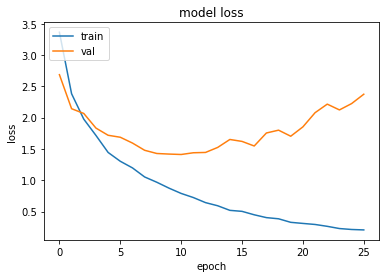

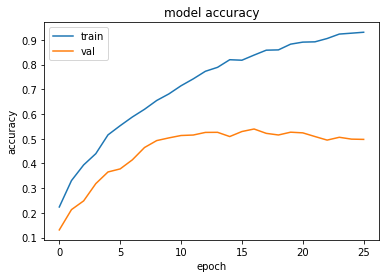

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.411516547203064 , and Val Acc happened to be 0.5128999948501587
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.5392000079154968 and Val Loss happened to be  1.547240972518921
num: 50
TestLoss:  1.3912427425384521  TestAcc: 0.5205000042915344
frog 0.694
ship 0.675
automobile 0.624
airplane 0.532
bird 0.514
horse 0.508
truck 0.483
dog 0.482
deer 0.436
cat 0.257


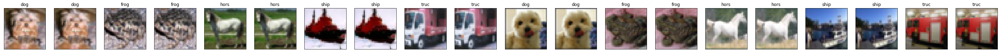

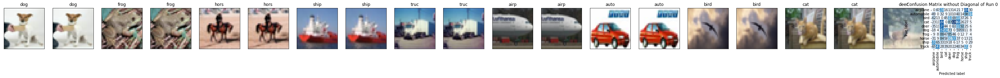

Summing down the rows, for Predictions of each Class that were wrong:  [425. 315. 914. 411. 521. 581. 609. 286. 513. 220.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  113.0 times
Summing across the columns, for total number of that True Class misidentified:  [468. 376. 486. 743. 564. 518. 306. 492. 325. 517.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  173.0 times


NameError: ignored

In [ ]:
run_through_runs(ds=trainA, ds_noalb=trainA_noalb, dstitle = "TrainA_Zipped", showpictures=True, troubleshooting=True)

filename will be:  runs_GroupTrainB_Zipped .pkl

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 

   Begin Run:  0 on Dataset TrainB_Zipped

 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 0.0 )
Bright:   ( 0.0 , 0.0 )
Darken:   ( -0.0 , -0.0 )
Rotate:   ( 0 , 0 ) or ( 0 , 0 )
pHorizontalFlip:    0
pVerticalFlip:      0
pEqualize:          0
pFancyPCA:          0
pChannelShuffle:    0
pElasticTransform:  0
pToGray:            0
 ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ ~ 


NoAlb+Alb
new_trainX created
<FlatMapDataset shapes: ((32, 32, 3), ()), types: (tf.float32, tf.int64)>
B

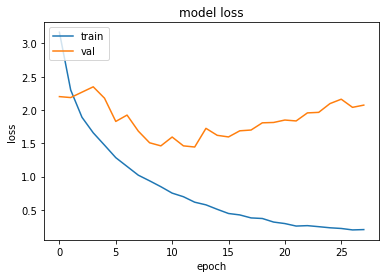

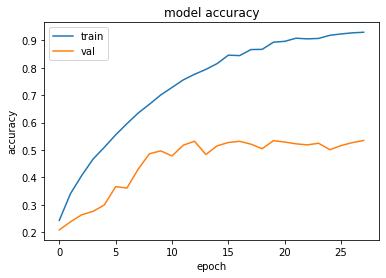

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.4450435638427734 , and Val Acc happened to be 0.5318999886512756
Additionally, the best val acc epoch happened to be  27 when val acc was:  0.534600019454956 and Val Loss happened to be  2.0743165016174316
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


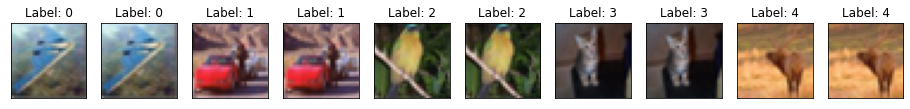

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


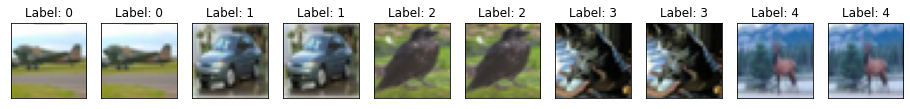

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


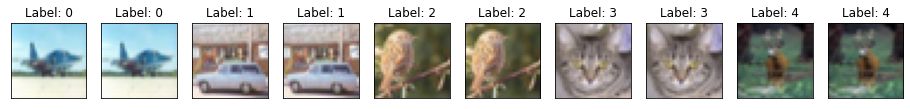

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


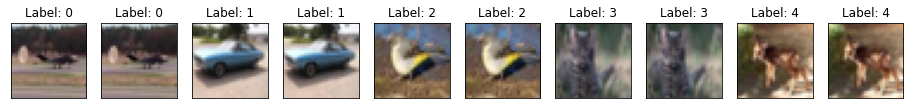

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


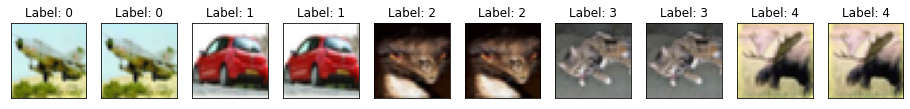

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3985576629638672  TestAcc: 0.5354999899864197
truck 0.673
ship 0.657
frog 0.648
horse 0.588
automobile 0.56
airplane 0.548
deer 0.528
dog 0.488
bird 0.35
cat 0.315


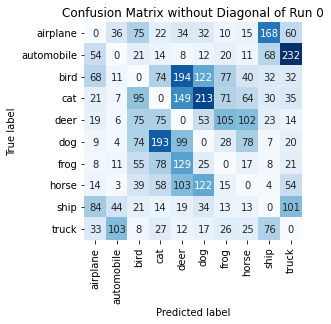

Summing down the rows, for Predictions of each Class that were wrong:  [310. 225. 463. 555. 747. 630. 365. 365. 416. 569.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  194.0 times
Summing across the columns, for total number of that True Class misidentified:  [452. 440. 650. 685. 472. 512. 352. 412. 343. 327.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  105.0 times

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

   Begin Run:  1 on Dataset TrainB_Zipped

 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 0.0 , 

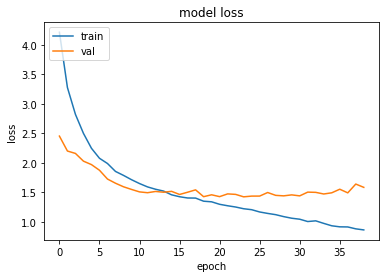

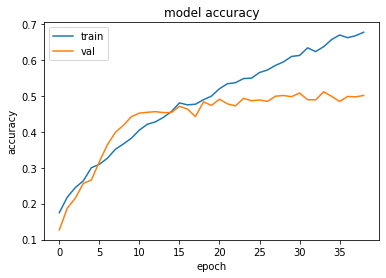

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.424728274345398 , and Val Acc happened to be 0.49309998750686646
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.5113000273704529 and Val Loss happened to be  1.4729112386703491
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


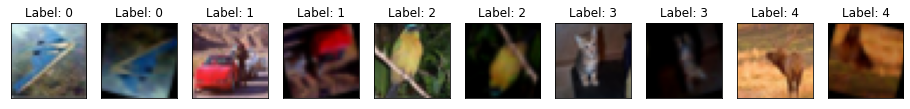

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


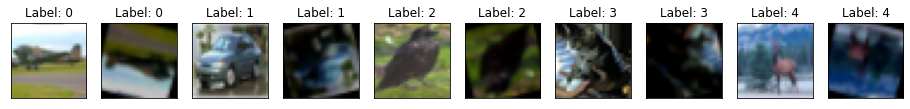

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


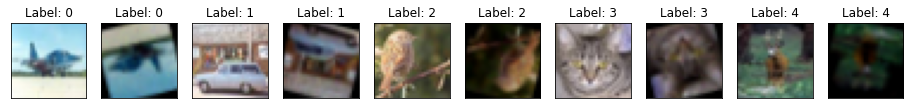

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


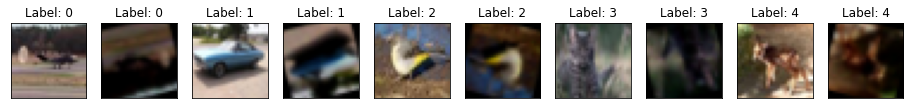

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


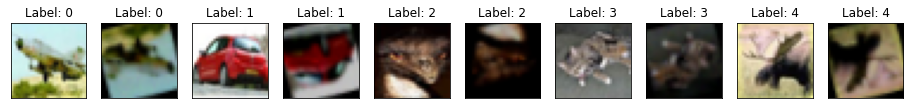

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.385819435119629  TestAcc: 0.5016000270843506
automobile 0.73
horse 0.66
airplane 0.649
frog 0.62
truck 0.536
dog 0.47
deer 0.396
bird 0.393
ship 0.298
cat 0.264


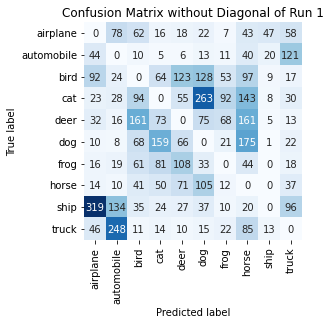

Summing down the rows, for Predictions of each Class that were wrong:  [596. 565. 543. 486. 484. 691. 296. 808. 103. 412.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  123.0 times
Summing across the columns, for total number of that True Class misidentified:  [351. 270. 607. 736. 604. 530. 380. 340. 702. 464.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  161.0 times

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 

   Begin Run:  2 on Dataset TrainB_Zipped

 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 0 , 0 )
blur:     ( 3 , 3 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 

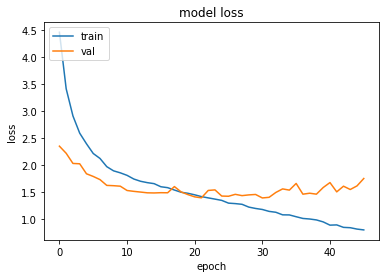

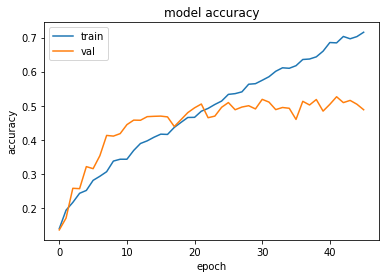

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  30 when  Val Loss was:  1.3901963233947754 , and Val Acc happened to be 0.5185999870300293
Additionally, the best val acc epoch happened to be  41 when val acc was:  0.526199996471405 and Val Loss happened to be  1.5027636289596558
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


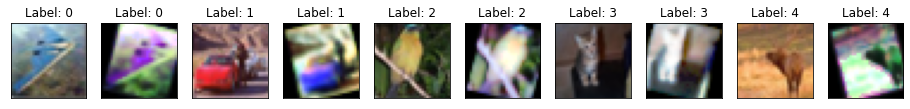

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


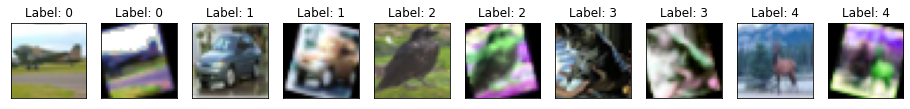

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


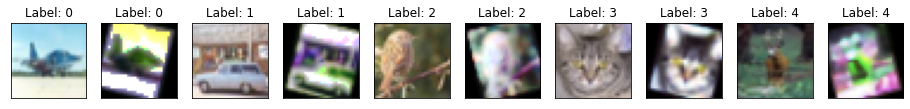

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


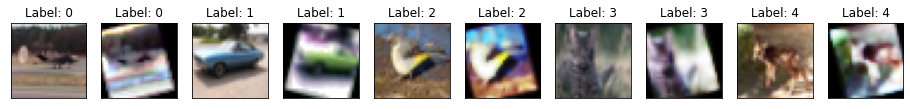

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


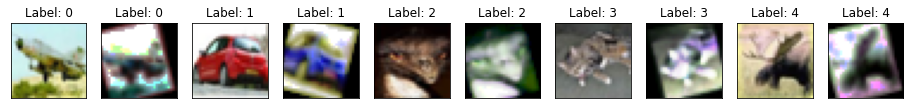

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.370301604270935  TestAcc: 0.5228000283241272
automobile 0.748
ship 0.631
airplane 0.625
horse 0.57
truck 0.563
frog 0.562
deer 0.494
dog 0.469
cat 0.344
bird 0.222


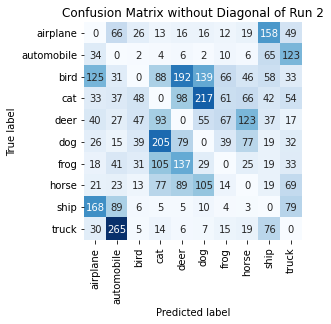

Summing down the rows, for Predictions of each Class that were wrong:  [495. 594. 217. 604. 628. 580. 288. 384. 493. 489.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  192.0 times
Summing across the columns, for total number of that True Class misidentified:  [375. 252. 778. 656. 506. 531. 438. 430. 369. 437.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  123.0 times

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 

   Begin Run:  3 on Dataset TrainB_Zipped

 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 0 , 0 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 , 0.1 )
Con

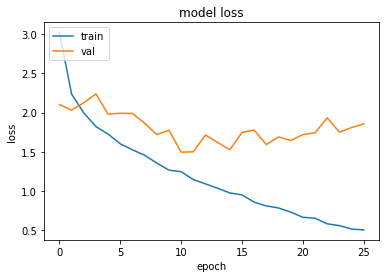

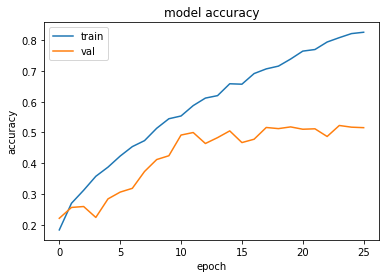

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.4931573867797852 , and Val Acc happened to be 0.49160000681877136
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.5227000117301941 and Val Loss happened to be  1.7491717338562012
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


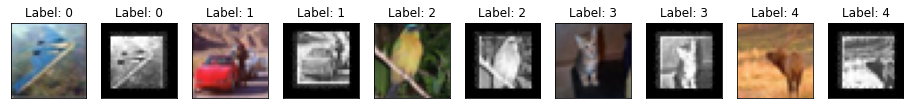

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


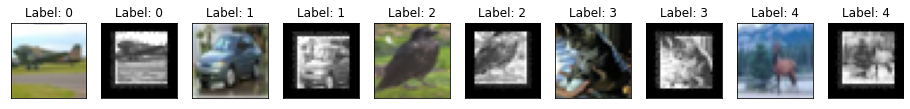

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


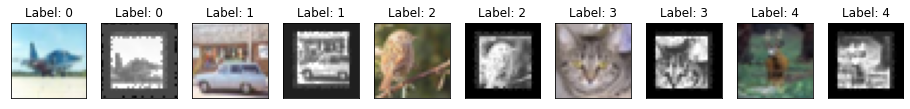

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


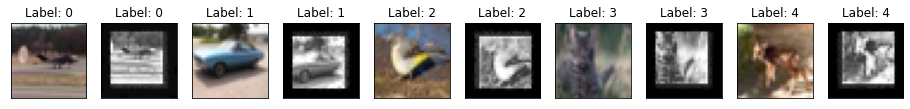

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


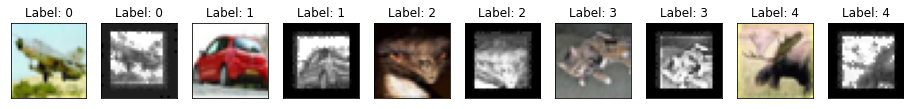

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4383364915847778  TestAcc: 0.4959000051021576
frog 0.709
deer 0.565
truck 0.563
automobile 0.558
ship 0.511
horse 0.504
airplane 0.457
dog 0.387
bird 0.364
cat 0.341


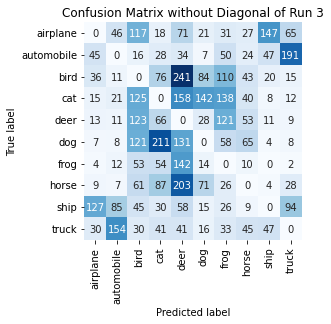

Summing down the rows, for Predictions of each Class that were wrong:  [ 286.  355.  691.  611. 1079.  398.  593.  316.  288.  424.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  241.0 times
Summing across the columns, for total number of that True Class misidentified:  [543. 442. 636. 659. 435. 613. 291. 496. 489. 437.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  123.0 times

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 

   Begin Run:  4 on Dataset TrainB_Zipped

 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp:

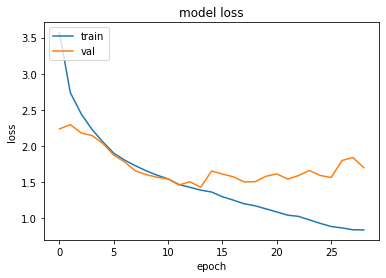

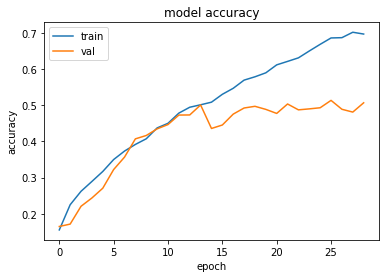

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.427323579788208 , and Val Acc happened to be 0.5006999969482422
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.5134000182151794 and Val Loss happened to be  1.5623143911361694
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


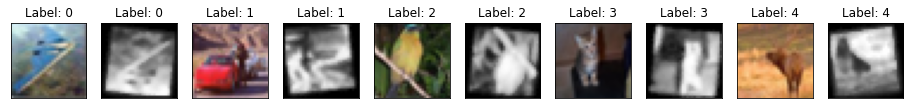

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


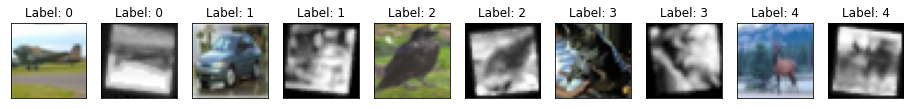

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


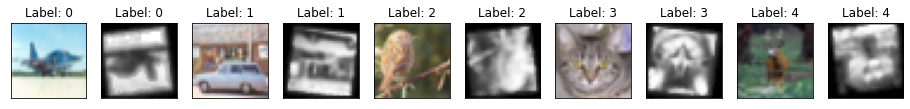

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


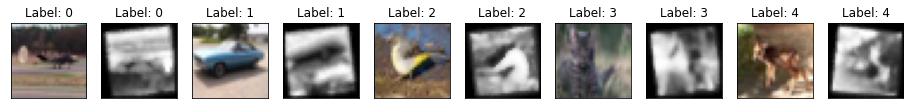

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


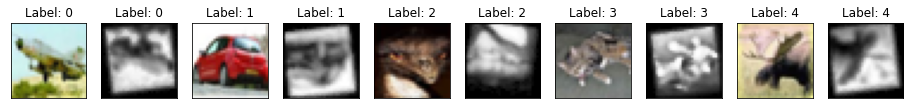

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3894164562225342  TestAcc: 0.5002999901771545
airplane 0.651
frog 0.625
automobile 0.566
truck 0.56
ship 0.534
horse 0.48
dog 0.446
deer 0.416
cat 0.382
bird 0.343


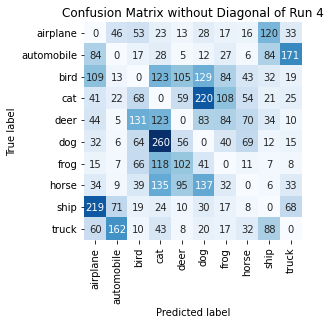

Summing down the rows, for Predictions of each Class that were wrong:  [638. 341. 467. 877. 453. 700. 426. 309. 404. 382.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  105.0 times
Summing across the columns, for total number of that True Class misidentified:  [349. 434. 657. 618. 584. 554. 375. 520. 466. 440.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  131.0 times

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 

   Begin Run:  5 on Dataset TrainB_Zipped

 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 0 , 0 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: 

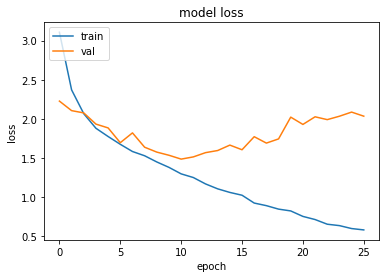

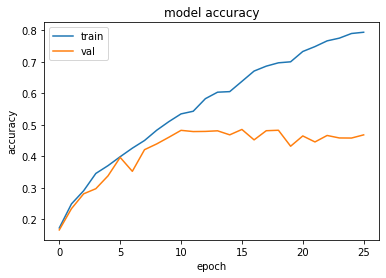

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.483311653137207 , and Val Acc happened to be 0.48249998688697815
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.4853000044822693 and Val Loss happened to be  1.6031594276428223
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


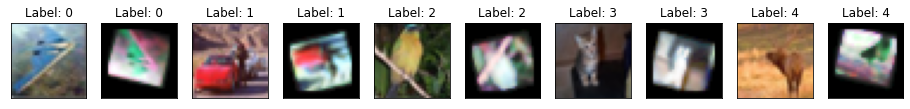

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


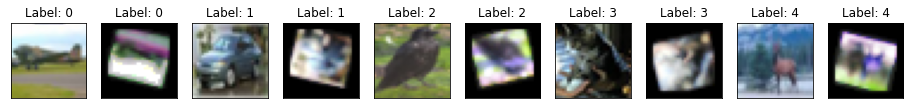

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


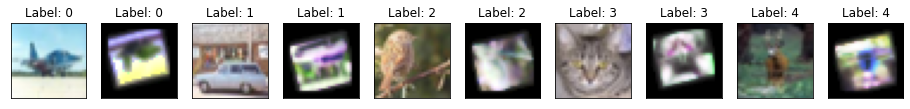

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


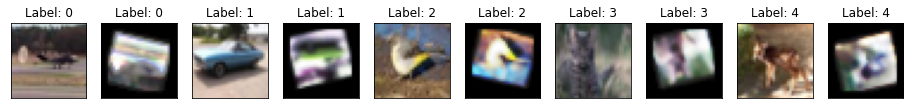

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


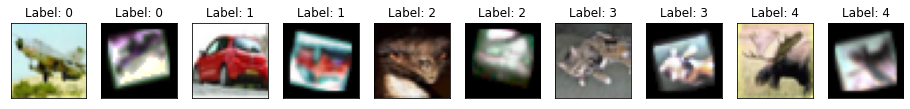

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4333385229110718  TestAcc: 0.49380001425743103
frog 0.758
truck 0.607
airplane 0.575
dog 0.558
automobile 0.539
horse 0.508
deer 0.404
ship 0.388
bird 0.309
cat 0.292


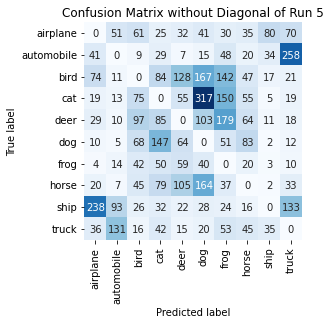

Summing down the rows, for Predictions of each Class that were wrong:  [471. 335. 439. 573. 487. 895. 714. 385. 189. 574.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  128.0 times
Summing across the columns, for total number of that True Class misidentified:  [425. 461. 691. 708. 596. 442. 242. 492. 612. 393.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  179.0 times

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 

   Begin Run:  6 on Dataset TrainB_Zipped

 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6 6  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.1 , 0.1 )
Cont

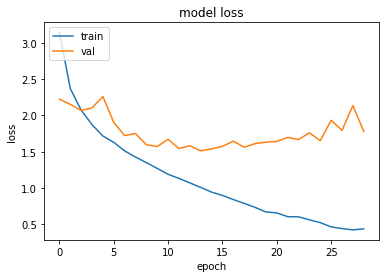

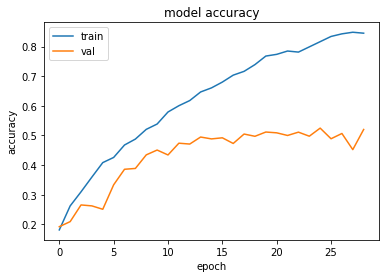

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.5126768350601196 , and Val Acc happened to be 0.49470001459121704
Additionally, the best val acc epoch happened to be  24 when val acc was:  0.5248000025749207 and Val Loss happened to be  1.6529388427734375
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


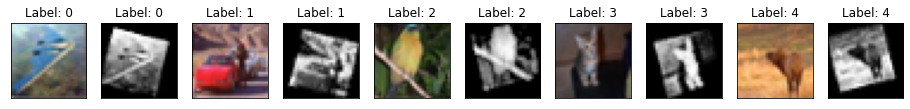

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


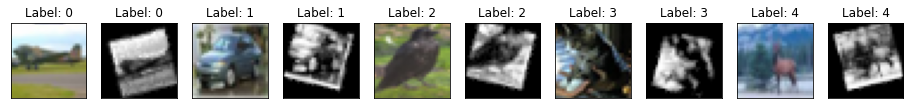

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


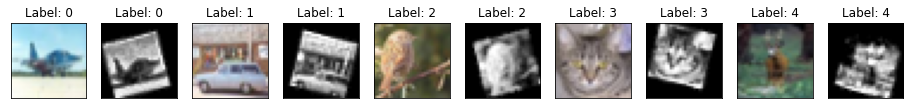

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


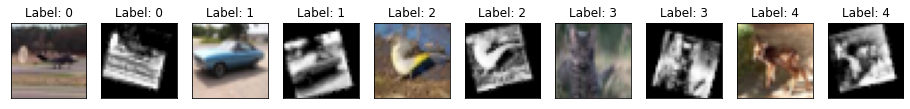

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


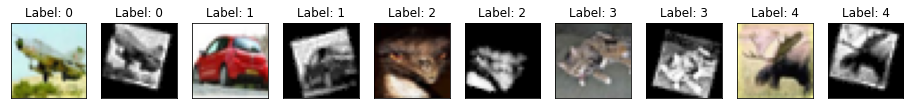

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.487862467765808  TestAcc: 0.5005999803543091
automobile 0.723
frog 0.68
ship 0.629
truck 0.595
horse 0.526
cat 0.514
deer 0.482
airplane 0.376
dog 0.281
bird 0.2


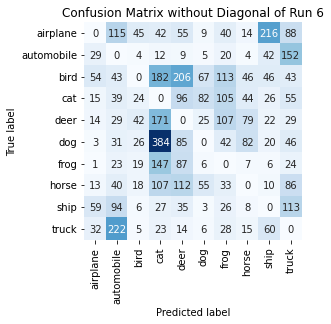

Summing down the rows, for Predictions of each Class that were wrong:  [ 220.  636.  189. 1095.  699.  258.  514.  299.  448.  636.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  206.0 times
Summing across the columns, for total number of that True Class misidentified:  [624. 277. 800. 486. 518. 719. 320. 474. 371. 405.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  171.0 times

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 

   Begin Run:  7 on Dataset TrainB_Zipped

 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7 7  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.16 , 0.16 )
Noise:    ( 24 , 24 )
blur:     ( 0 , 1 )
sharp:    ( 0.1 ,

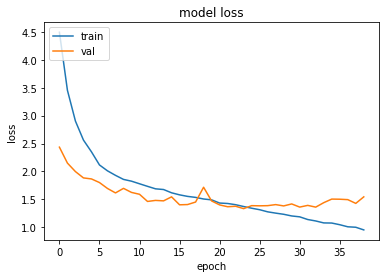

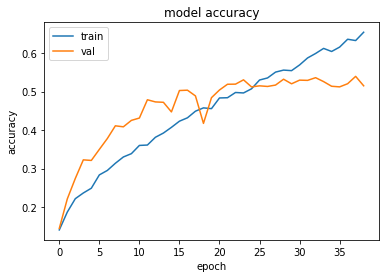

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.3338757753372192 , and Val Acc happened to be 0.5304999947547913
Additionally, the best val acc epoch happened to be  37 when val acc was:  0.5394999980926514 and Val Loss happened to be  1.4279762506484985
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


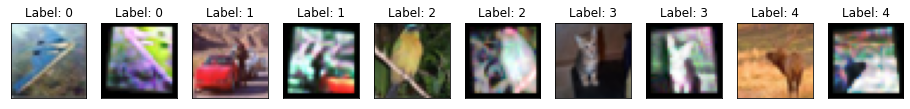

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


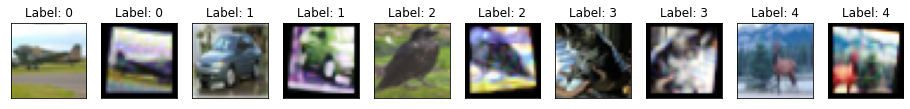

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


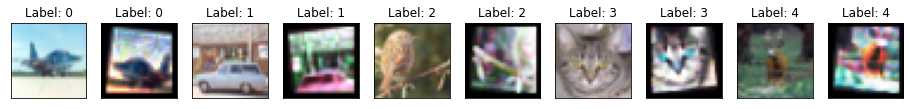

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


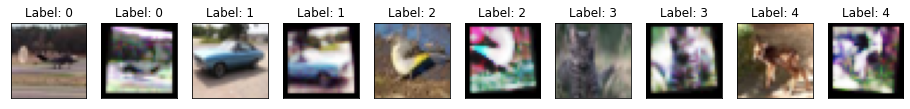

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


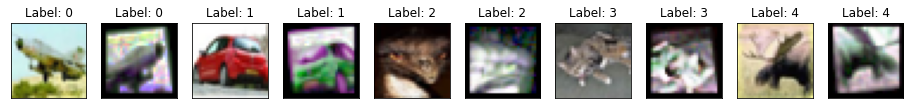

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3130241632461548  TestAcc: 0.534500002861023
frog 0.747
automobile 0.713
horse 0.626
truck 0.602
ship 0.566
airplane 0.559
dog 0.534
deer 0.443
cat 0.367
bird 0.188


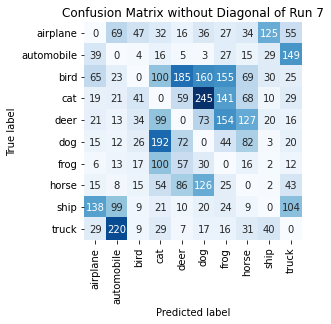

Summing down the rows, for Predictions of each Class that were wrong:  [347. 478. 202. 643. 497. 710. 613. 451. 261. 453.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  185.0 times
Summing across the columns, for total number of that True Class misidentified:  [441. 287. 812. 633. 557. 466. 253. 374. 434. 398.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  154.0 times

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 

   Begin Run:  8 on Dataset TrainB_Zipped

 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   ( 0.0 , 0.0 )
Noise:    ( 24 , 24 )
blur:     ( 7 , 7 )
sharp:    ( 0.0 , 0.0 )
Contrast: ( 

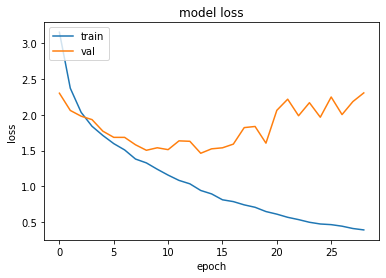

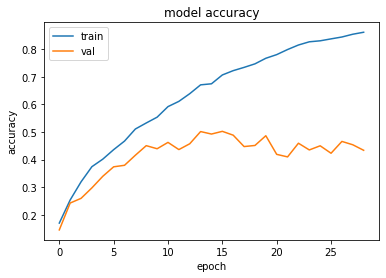

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  13 when  Val Loss was:  1.4617817401885986 , and Val Acc happened to be 0.5015000104904175
Additionally, the best val acc epoch happened to be  15 when val acc was:  0.5023000240325928 and Val Loss happened to be  1.5379568338394165
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


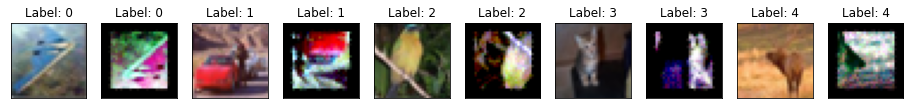

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


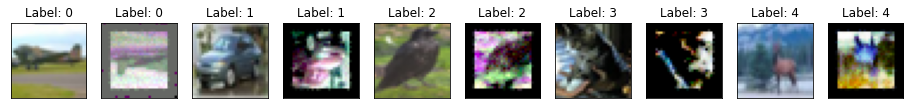

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


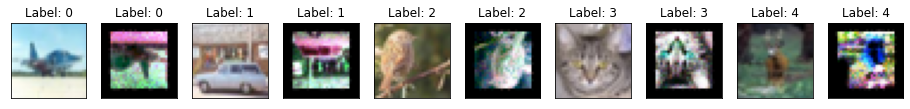

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


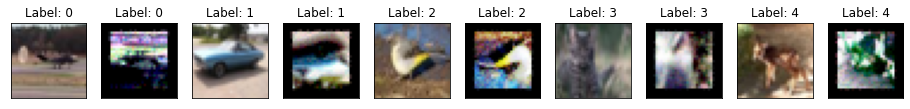

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


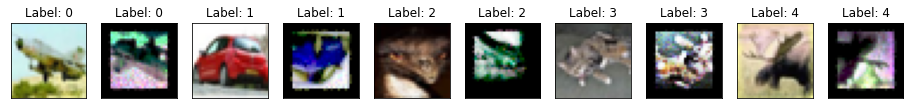

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4265053272247314  TestAcc: 0.4993000030517578
truck 0.656
airplane 0.575
frog 0.566
automobile 0.554
ship 0.525
cat 0.506
deer 0.489
horse 0.444
dog 0.435
bird 0.243


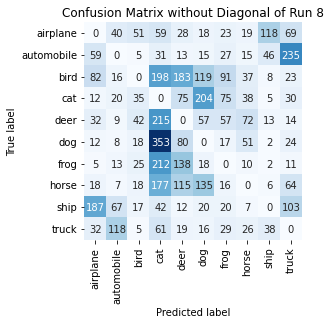

Summing down the rows, for Predictions of each Class that were wrong:  [ 439.  298.  216. 1348.  663.  602.  355.  275.  238.  573.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  183.0 times
Summing across the columns, for total number of that True Class misidentified:  [425. 446. 757. 494. 511. 565. 434. 556. 475. 344.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  215.0 times

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 

   Begin Run:  9 on Dataset TrainB_Zipped

 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0625 , 0.0625 )or ( -0.0625 , -0.0625 )
Gamma:    ( 110 , 110 )
ZoomOut:  ( -0.08 , -0.08 )
ZoomIn:   ( 0.08 , 0.08 )
Noise:    ( 12 , 12 )
blur:     ( 3 , 3 )
sharp: 

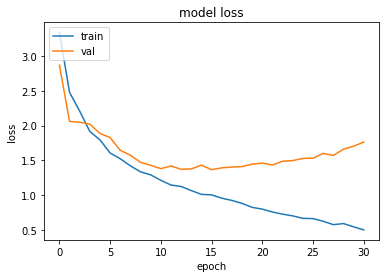

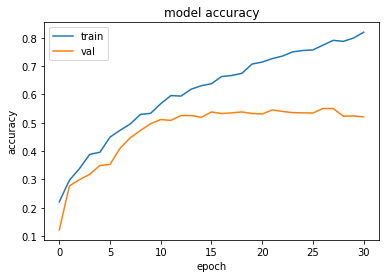

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  15 when  Val Loss was:  1.3657418489456177 , and Val Acc happened to be 0.5379999876022339
Additionally, the best val acc epoch happened to be  26 when val acc was:  0.5501999855041504 and Val Loss happened to be  1.599885106086731
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


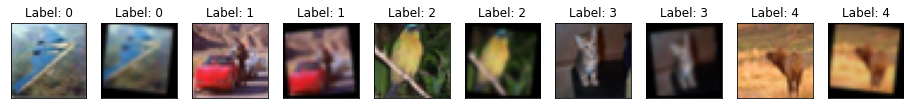

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


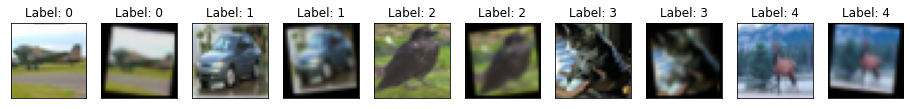

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


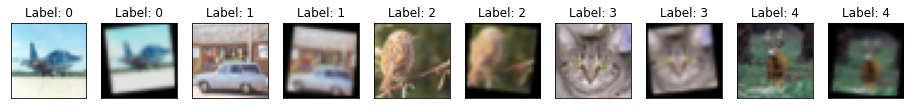

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


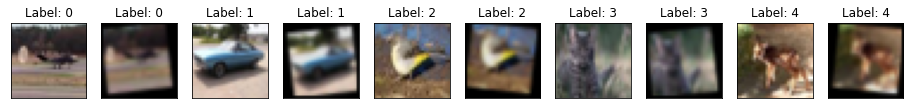

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


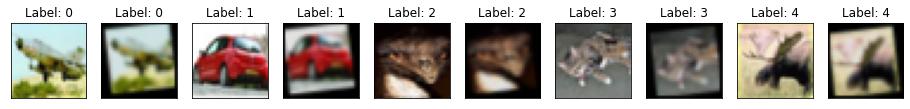

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3454532623291016  TestAcc: 0.5354999899864197
automobile 0.765
airplane 0.653
frog 0.622
horse 0.616
ship 0.538
dog 0.523
truck 0.476
bird 0.401
deer 0.391
cat 0.37


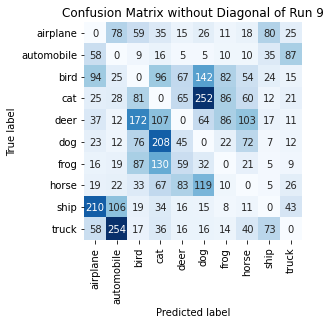

Summing down the rows, for Predictions of each Class that were wrong:  [540. 556. 553. 729. 371. 671. 329. 389. 258. 249.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  83.0 times
Summing across the columns, for total number of that True Class misidentified:  [347. 235. 599. 630. 609. 477. 378. 384. 462. 524.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  172.0 times

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 

   Begin Run:  10 on Dataset TrainB_Zipped

 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10 10  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn:   

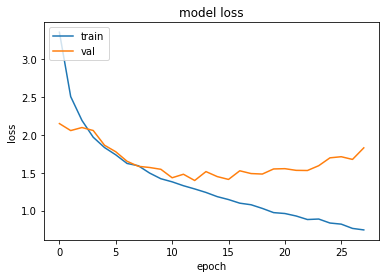

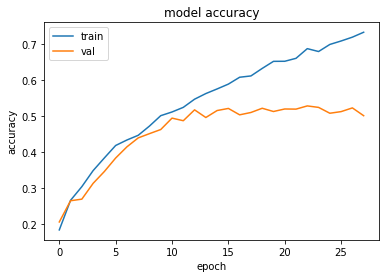

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.3979548215866089 , and Val Acc happened to be 0.5174999833106995
Additionally, the best val acc epoch happened to be  22 when val acc was:  0.5284000039100647 and Val Loss happened to be  1.5303031206130981
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


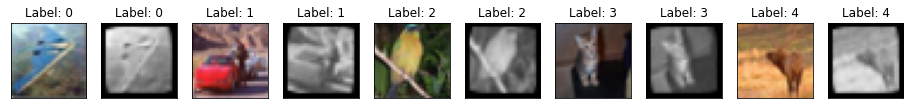

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


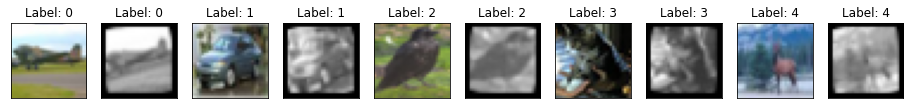

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


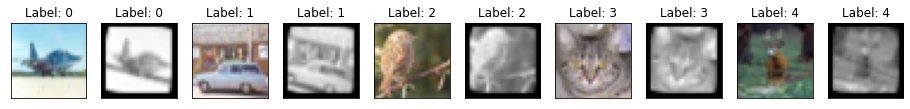

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


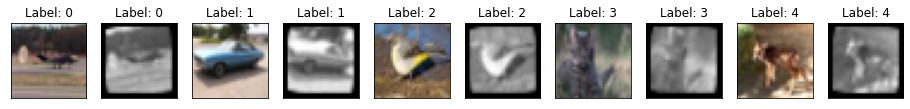

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


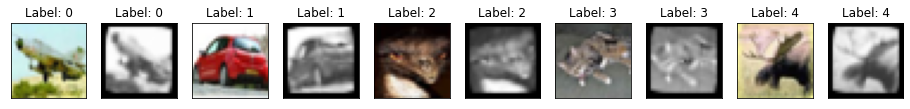

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3699705600738525  TestAcc: 0.5159000158309937
horse 0.678
automobile 0.662
frog 0.613
airplane 0.598
truck 0.595
ship 0.559
dog 0.475
deer 0.467
cat 0.331
bird 0.181


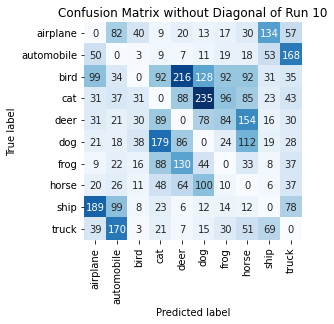

Summing down the rows, for Predictions of each Class that were wrong:  [489. 509. 180. 558. 624. 636. 386. 587. 359. 513.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  216.0 times
Summing across the columns, for total number of that True Class misidentified:  [402. 338. 819. 669. 533. 525. 387. 322. 441. 405.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  154.0 times

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 

   Begin Run:  11 on Dataset TrainB_Zipped

 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11 11  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn

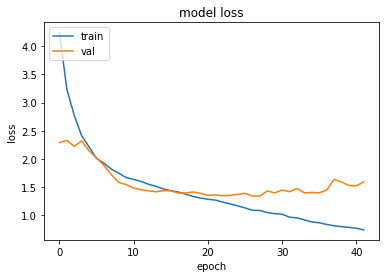

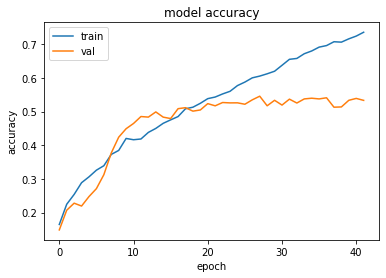

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.344240427017212 , and Val Acc happened to be 0.5349000096321106
Additionally, the best val acc epoch happened to be  27 when val acc was:  0.5457000136375427 and Val Loss happened to be  1.344940185546875
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


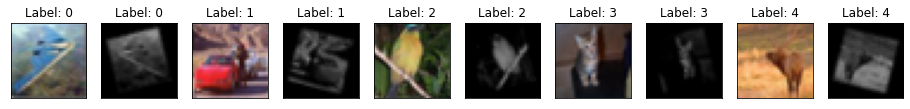

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


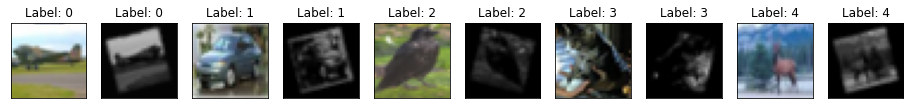

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


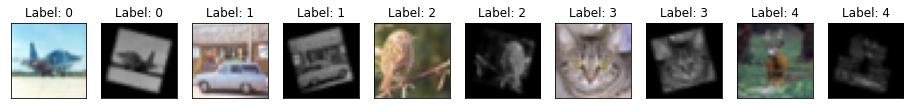

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


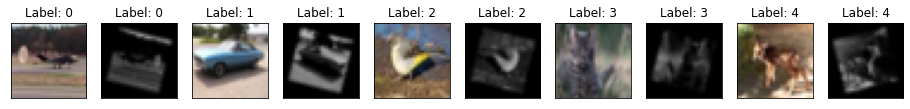

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


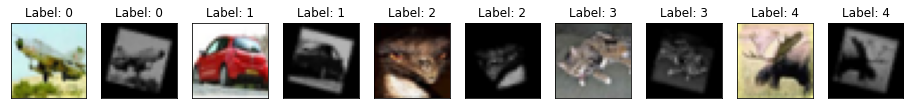

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.311874270439148  TestAcc: 0.5375999808311462
automobile 0.711
frog 0.702
airplane 0.66
horse 0.621
dog 0.572
ship 0.547
deer 0.492
truck 0.492
bird 0.361
cat 0.218


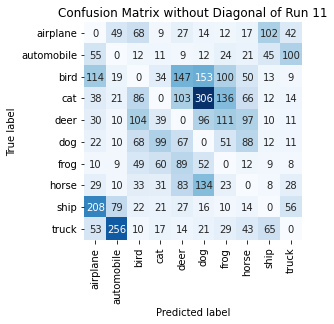

Summing down the rows, for Predictions of each Class that were wrong:  [559. 463. 452. 321. 566. 804. 496. 408. 276. 279.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  147.0 times
Summing across the columns, for total number of that True Class misidentified:  [340. 289. 639. 782. 508. 428. 298. 379. 453. 508.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  111.0 times

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 

   Begin Run:  12 on Dataset TrainB_Zipped

 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12 12  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.08 , -0.08 )

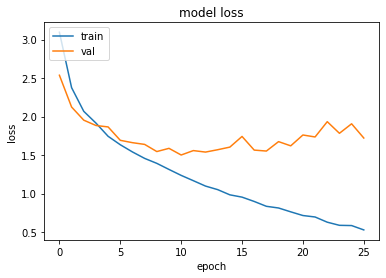

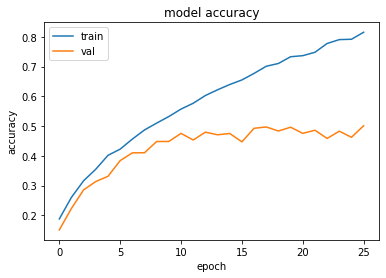

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.5016249418258667 , and Val Acc happened to be 0.47540000081062317
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.5011000037193298 and Val Loss happened to be  1.7220464944839478
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


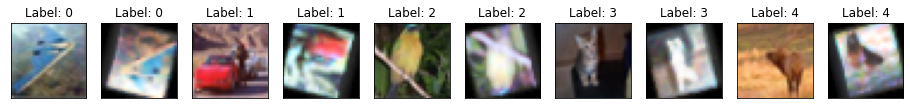

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


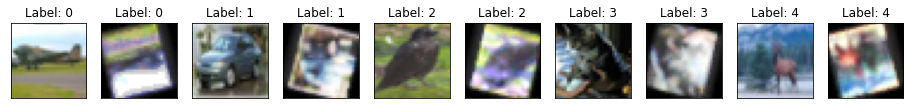

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


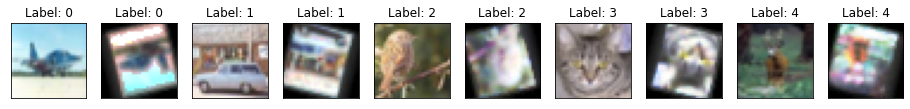

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


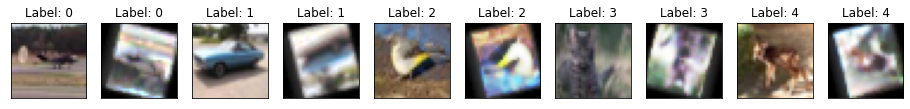

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


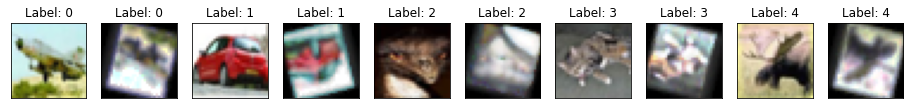

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4663020372390747  TestAcc: 0.4810999929904938
deer 0.579
frog 0.571
horse 0.532
truck 0.523
airplane 0.506
ship 0.505
automobile 0.503
cat 0.419
dog 0.405
bird 0.268


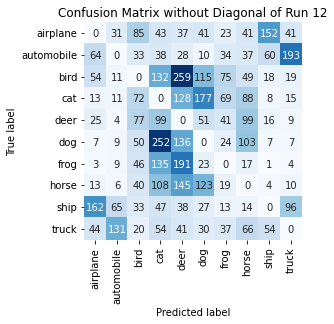

Summing down the rows, for Predictions of each Class that were wrong:  [ 385.  277.  456.  908. 1003.  597.  335.  514.  320.  394.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  259.0 times
Summing across the columns, for total number of that True Class misidentified:  [494. 497. 732. 581. 421. 595. 429. 468. 495. 477.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  99.0 times

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 

   Begin Run:  13 on Dataset TrainB_Zipped

 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13 13  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.08 ,

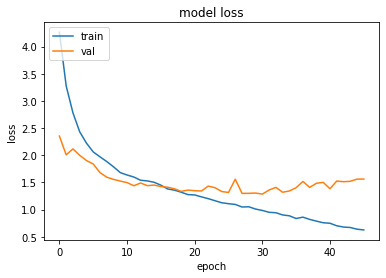

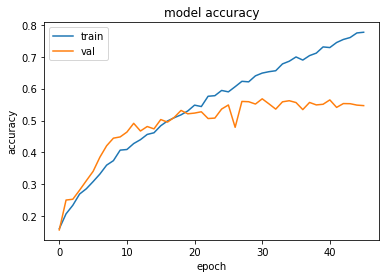

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  30 when  Val Loss was:  1.28518807888031 , and Val Acc happened to be 0.5680000185966492
Additionally, the best val acc epoch happened to be  30 when val acc was:  0.5680000185966492 and Val Loss happened to be  1.28518807888031
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


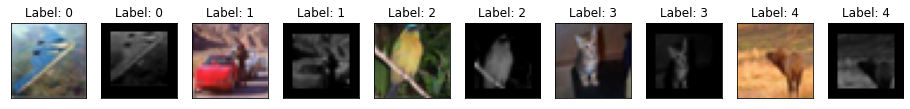

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


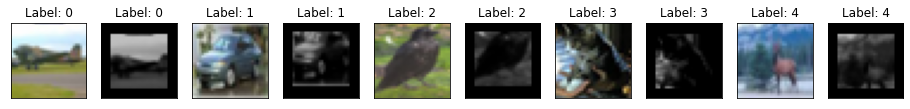

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


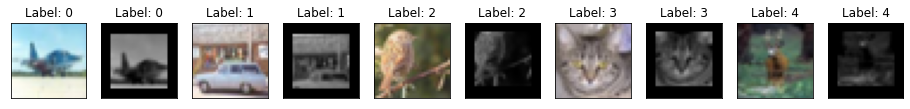

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


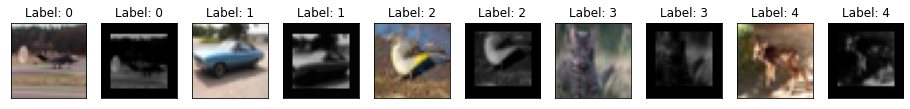

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


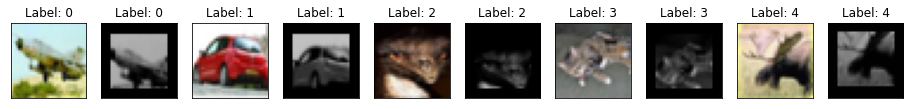

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.254931092262268  TestAcc: 0.5684000253677368
frog 0.748
ship 0.723
horse 0.691
truck 0.677
automobile 0.639
airplane 0.552
dog 0.521
deer 0.456
cat 0.383
bird 0.294


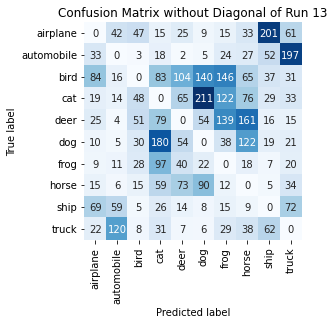

Summing down the rows, for Predictions of each Class that were wrong:  [286. 277. 235. 588. 384. 545. 540. 549. 428. 484.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  104.0 times
Summing across the columns, for total number of that True Class misidentified:  [448. 361. 706. 617. 544. 479. 252. 309. 277. 323.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  161.0 times

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 

   Begin Run:  14 on Dataset TrainB_Zipped

 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.

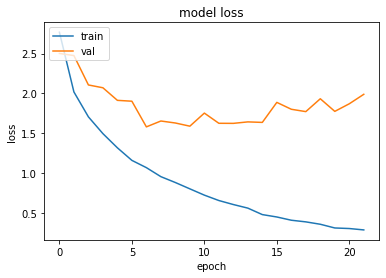

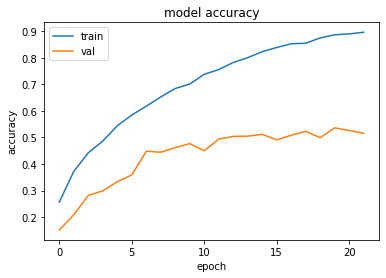

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  6 when  Val Loss was:  1.5804144144058228 , and Val Acc happened to be 0.4478999972343445
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5360000133514404 and Val Loss happened to be  1.7748093605041504
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


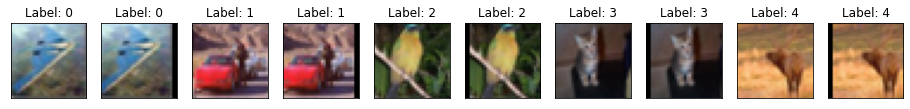

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


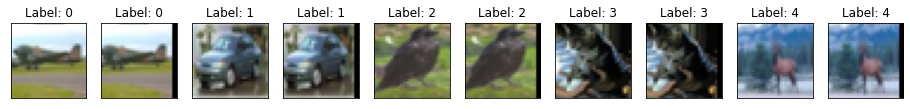

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


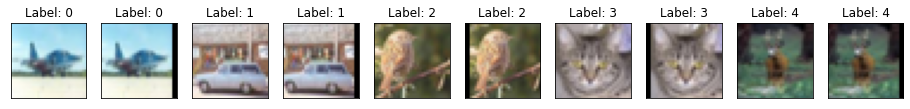

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


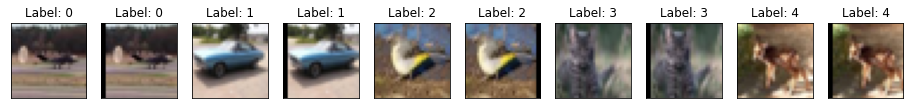

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


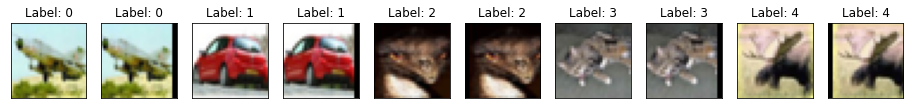

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.5466275215148926  TestAcc: 0.45890000462532043
deer 0.692
truck 0.593
horse 0.586
ship 0.575
cat 0.426
automobile 0.417
frog 0.416
airplane 0.395
dog 0.331
bird 0.158


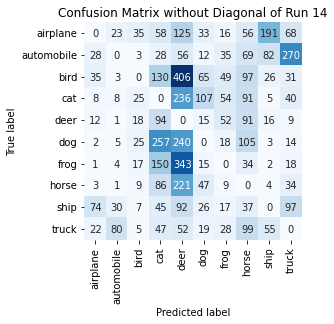

Summing down the rows, for Predictions of each Class that were wrong:  [ 185.  155.  144.  895. 1771.  339.  278.  679.  384.  581.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  406.0 times
Summing across the columns, for total number of that True Class misidentified:  [605. 583. 842. 574. 308. 669. 584. 414. 425. 407.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  94.0 times

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 

   Begin Run:  15 on Dataset TrainB_Zipped

 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15 15  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0625 , 0.0625 ) or ( -0.0625 , -0.0625 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut

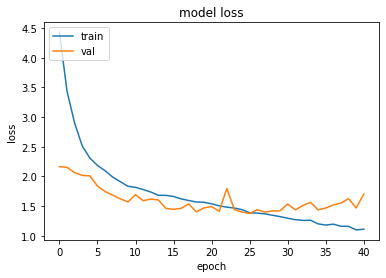

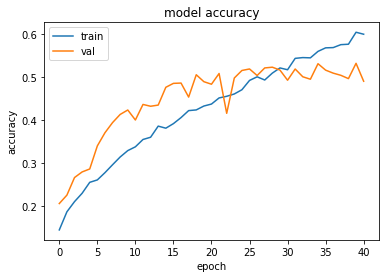

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.3759199380874634 , and Val Acc happened to be 0.5184000134468079
Additionally, the best val acc epoch happened to be  39 when val acc was:  0.531499981880188 and Val Loss happened to be  1.4690171480178833
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


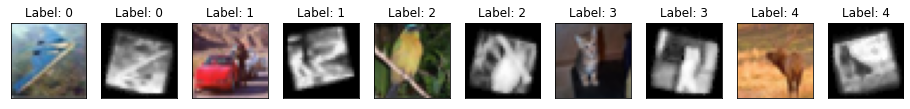

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


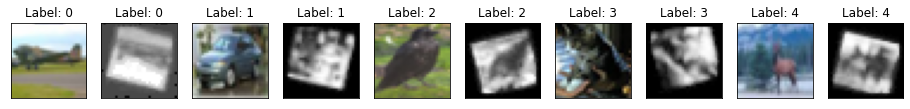

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


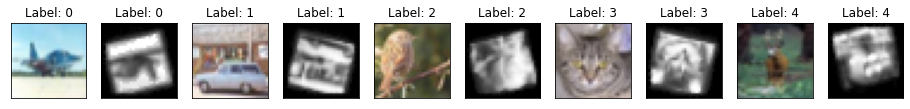

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


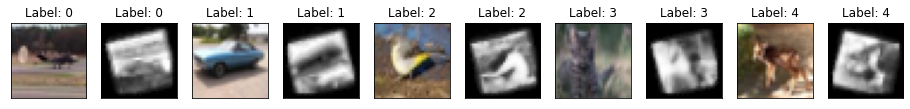

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


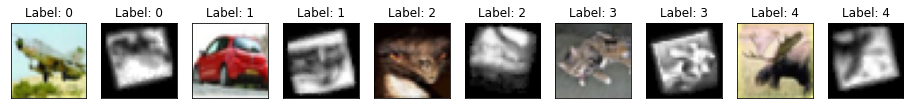

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.345901608467102  TestAcc: 0.5285000205039978
automobile 0.691
frog 0.683
airplane 0.627
ship 0.596
dog 0.551
truck 0.512
horse 0.489
bird 0.429
deer 0.414
cat 0.293


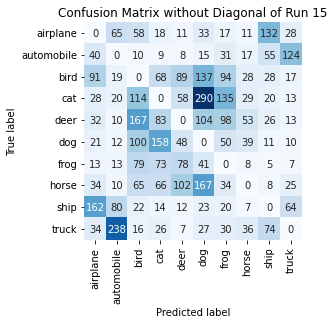

Summing down the rows, for Predictions of each Class that were wrong:  [455. 467. 631. 515. 413. 837. 509. 228. 359. 301.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  102.0 times
Summing across the columns, for total number of that True Class misidentified:  [373. 309. 571. 707. 586. 449. 317. 511. 404. 488.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  167.0 times

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 

   Begin Run:  16 on Dataset TrainB_Zipped

 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16 16  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )

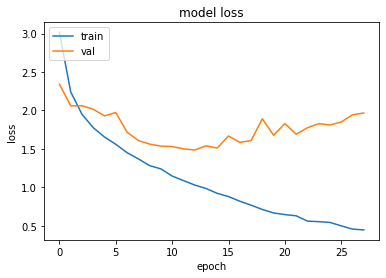

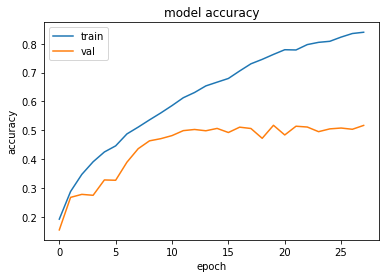

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.4857585430145264 , and Val Acc happened to be 0.5027999877929688
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.517300009727478 and Val Loss happened to be  1.6775606870651245
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


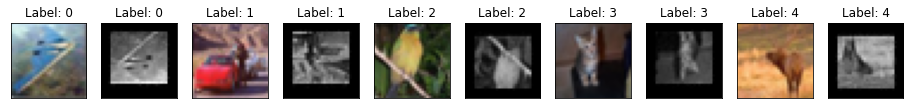

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


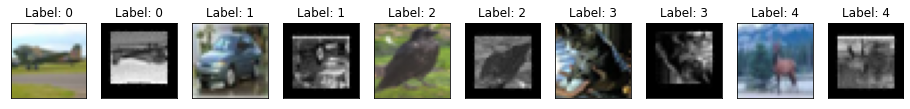

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


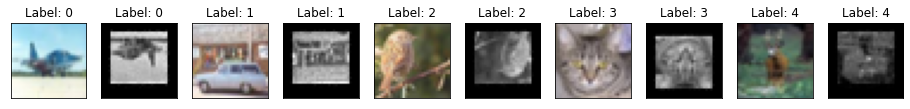

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


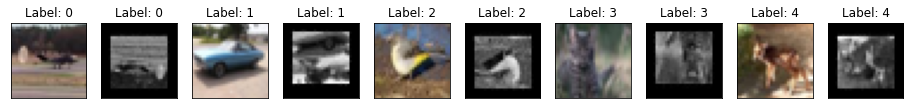

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


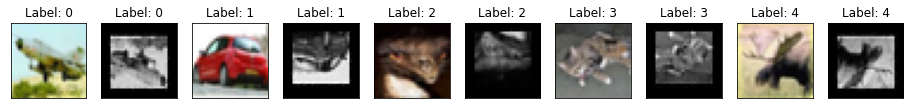

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4536000490188599  TestAcc: 0.5033000111579895
automobile 0.653
ship 0.635
deer 0.578
airplane 0.567
horse 0.564
truck 0.527
dog 0.522
frog 0.496
bird 0.259
cat 0.232


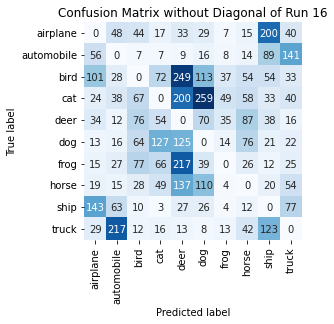

Summing down the rows, for Predictions of each Class that were wrong:  [ 434.  464.  385.  411. 1010.  670.  171.  384.  590.  448.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  249.0 times
Summing across the columns, for total number of that True Class misidentified:  [433. 347. 741. 768. 422. 478. 504. 436. 365. 473.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  87.0 times

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 

   Begin Run:  17 on Dataset TrainB_Zipped

 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17 17  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut: 

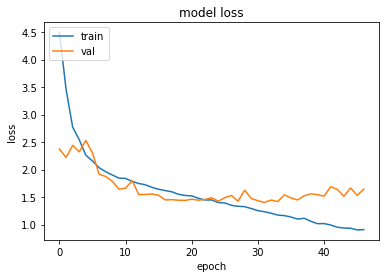

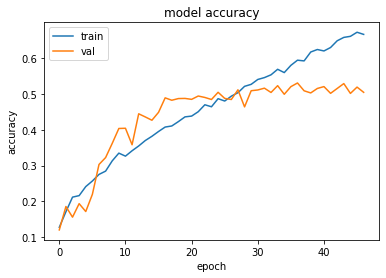

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  31 when  Val Loss was:  1.4035285711288452 , and Val Acc happened to be 0.5160999894142151
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.5306000113487244 and Val Loss happened to be  1.4479233026504517
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


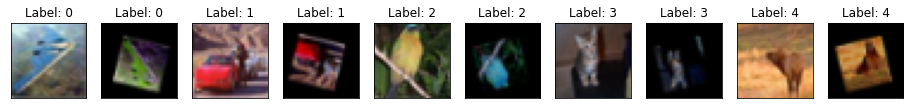

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


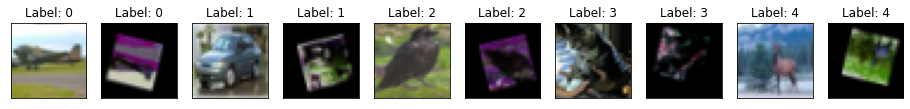

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


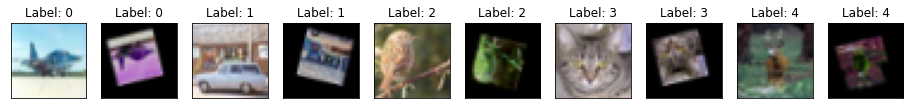

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


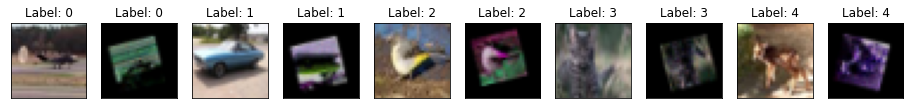

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


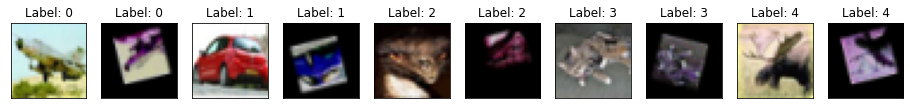

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3706008195877075  TestAcc: 0.5242999792098999
horse 0.642
airplane 0.638
frog 0.632
automobile 0.614
dog 0.578
truck 0.563
ship 0.502
deer 0.481
bird 0.369
cat 0.224


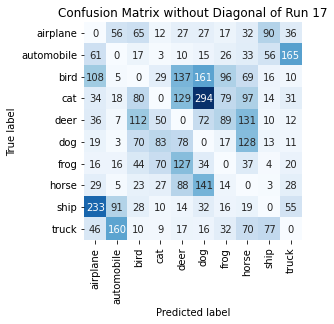

Summing down the rows, for Predictions of each Class that were wrong:  [582. 361. 449. 293. 627. 792. 386. 616. 283. 368.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  137.0 times
Summing across the columns, for total number of that True Class misidentified:  [362. 386. 631. 776. 519. 422. 368. 358. 498. 437.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  131.0 times

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 

   Begin Run:  18 on Dataset TrainB_Zipped

 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18 18  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn

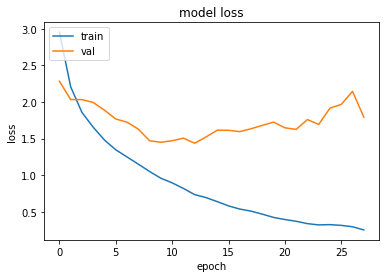

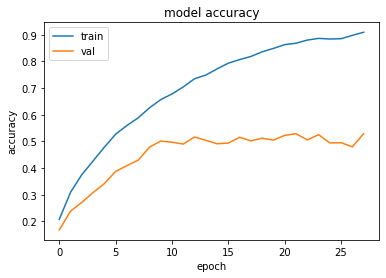

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.4375040531158447 , and Val Acc happened to be 0.516700029373169
Additionally, the best val acc epoch happened to be  21 when val acc was:  0.5291000008583069 and Val Loss happened to be  1.626375436782837
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


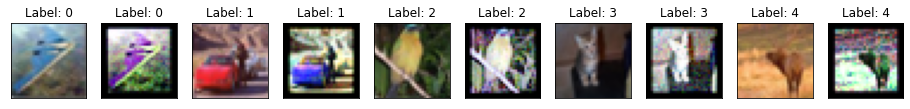

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


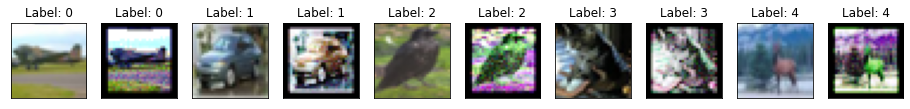

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


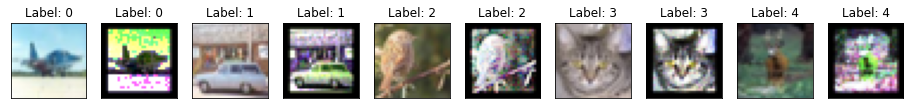

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


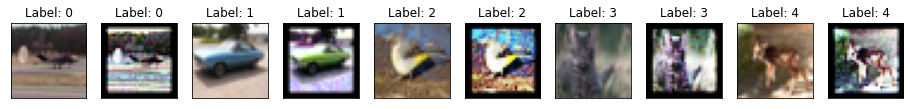

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


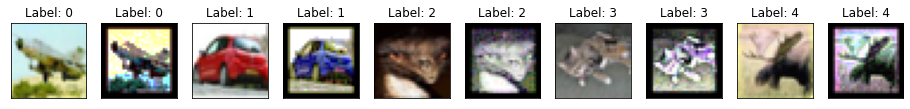

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.408352017402649  TestAcc: 0.5275999903678894
frog 0.673
truck 0.628
automobile 0.609
ship 0.6
horse 0.567
dog 0.503
bird 0.464
deer 0.445
airplane 0.434
cat 0.353


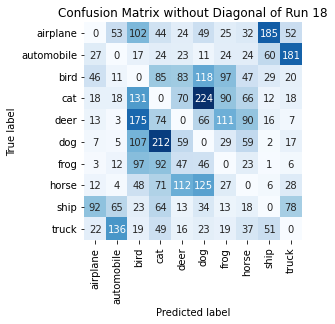

Summing down the rows, for Predictions of each Class that were wrong:  [240. 307. 719. 715. 447. 696. 435. 396. 362. 407.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  112.0 times
Summing across the columns, for total number of that True Class misidentified:  [566. 391. 536. 647. 555. 497. 327. 433. 400. 372.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  175.0 times

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 

   Begin Run:  19 on Dataset TrainB_Zipped

 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19 19  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )

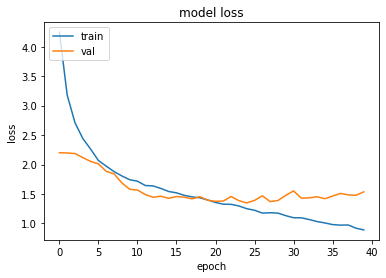

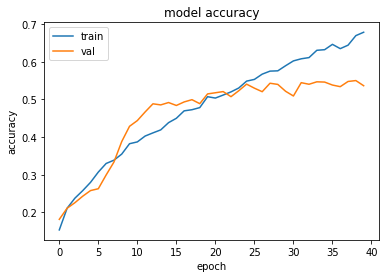

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.3483694791793823 , and Val Acc happened to be 0.5407999753952026
Additionally, the best val acc epoch happened to be  38 when val acc was:  0.5503000020980835 and Val Loss happened to be  1.4780497550964355
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


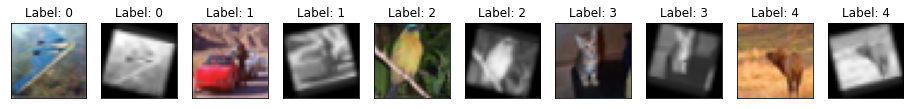

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


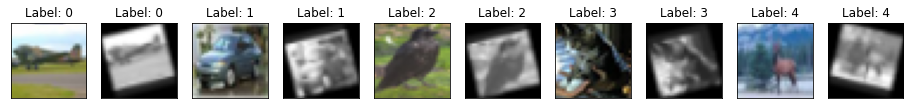

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


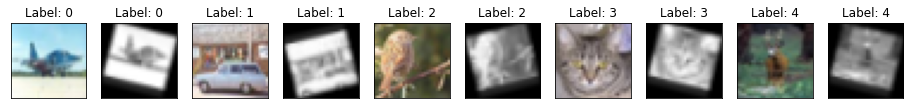

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


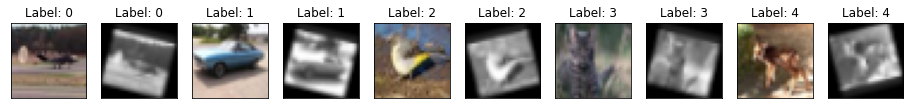

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


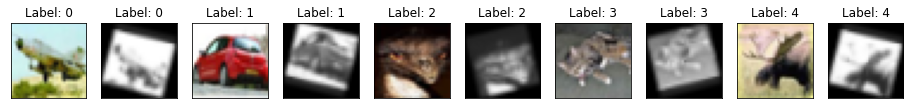

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3077783584594727  TestAcc: 0.5516999959945679
automobile 0.724
frog 0.713
horse 0.676
truck 0.647
ship 0.613
airplane 0.559
dog 0.5
deer 0.434
bird 0.367
cat 0.284


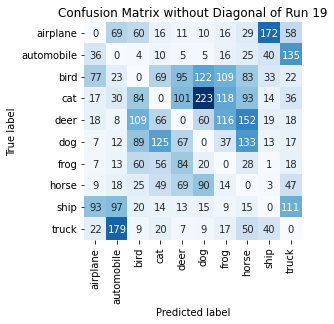

Summing down the rows, for Predictions of each Class that were wrong:  [286. 449. 460. 425. 452. 554. 452. 608. 335. 462.]
For example, the model predicted a  label 4 (deer) on a true   3  a total of  101.0 times
Summing across the columns, for total number of that True Class misidentified:  [441. 276. 633. 716. 566. 500. 287. 324. 387. 353.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  152.0 times

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 

   Begin Run:  20 on Dataset TrainB_Zipped

 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20 20  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn

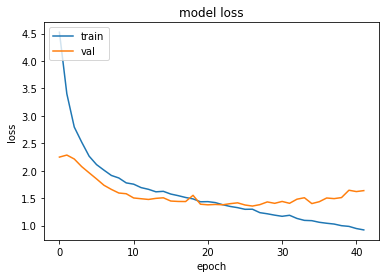

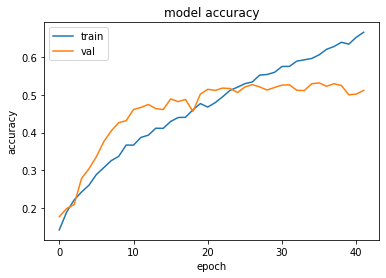

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  26 when  Val Loss was:  1.3550783395767212 , and Val Acc happened to be 0.5267999768257141
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5313000082969666 and Val Loss happened to be  1.4341692924499512
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


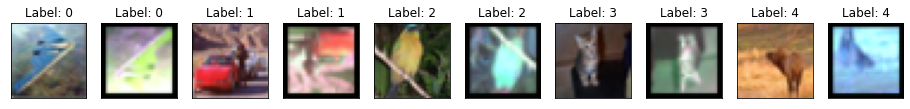

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


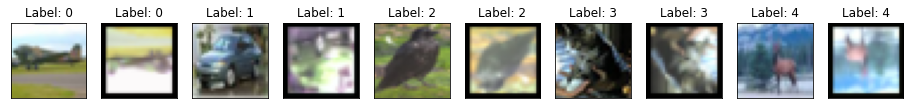

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


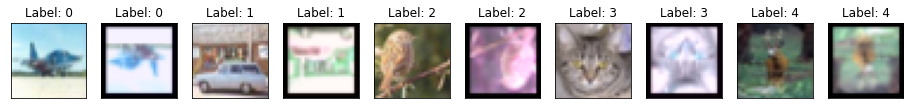

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


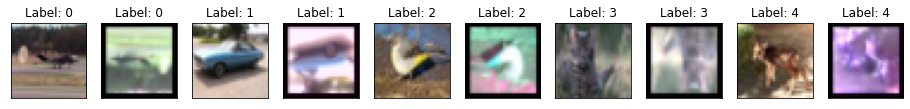

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


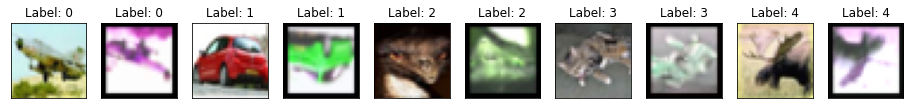

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3333849906921387  TestAcc: 0.5242999792098999
automobile 0.785
frog 0.658
airplane 0.622
horse 0.598
truck 0.515
dog 0.503
ship 0.465
cat 0.404
deer 0.362
bird 0.331


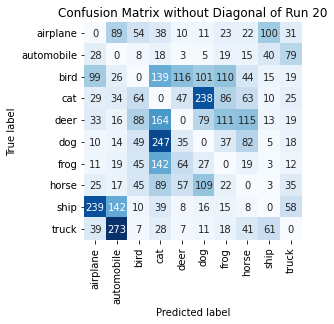

Summing down the rows, for Predictions of each Class that were wrong:  [513. 630. 370. 904. 347. 597. 441. 409. 250. 296.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  116.0 times
Summing across the columns, for total number of that True Class misidentified:  [378. 215. 669. 596. 638. 497. 342. 402. 535. 485.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  164.0 times

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 

   Begin Run:  21 on Dataset TrainB_Zipped

 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21 21  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -

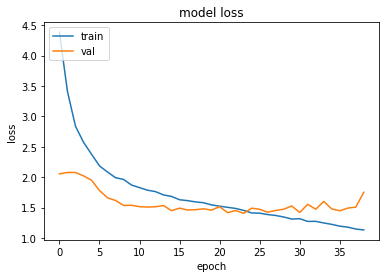

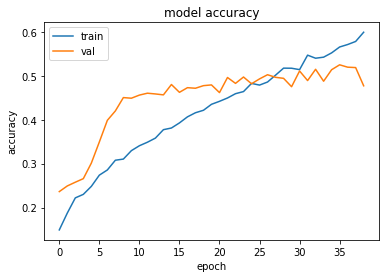

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.4045594930648804 , and Val Acc happened to be 0.4973999857902527
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5252000093460083 and Val Loss happened to be  1.4468402862548828
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


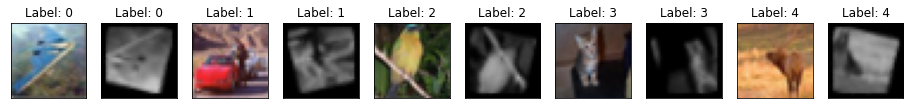

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


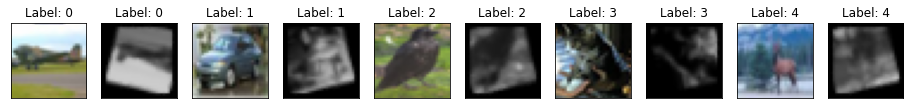

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


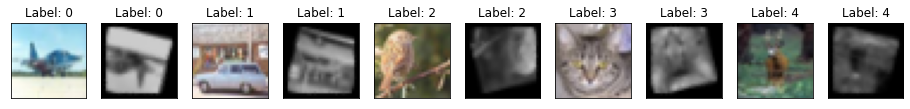

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


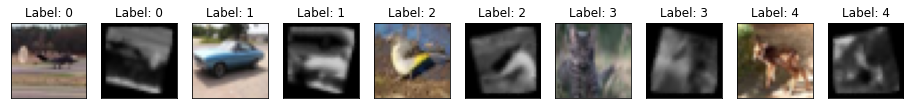

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


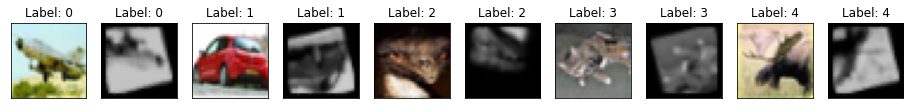

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3765754699707031  TestAcc: 0.5133000016212463
automobile 0.726
horse 0.692
frog 0.662
airplane 0.592
truck 0.555
dog 0.503
deer 0.49
ship 0.477
cat 0.251
bird 0.185


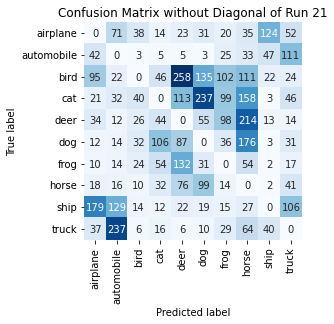

Summing down the rows, for Predictions of each Class that were wrong:  [448. 547. 193. 329. 722. 620. 438. 872. 256. 442.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  258.0 times
Summing across the columns, for total number of that True Class misidentified:  [408. 274. 815. 749. 510. 497. 338. 308. 523. 445.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  214.0 times

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 

   Begin Run:  22 on Dataset TrainB_Zipped

 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22 22  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
ZoomIn: 

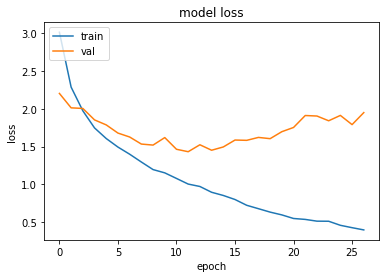

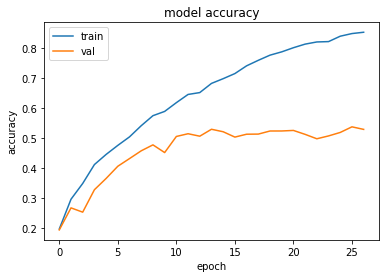

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  11 when  Val Loss was:  1.4324251413345337 , and Val Acc happened to be 0.5145999789237976
Additionally, the best val acc epoch happened to be  25 when val acc was:  0.5375999808311462 and Val Loss happened to be  1.7900636196136475
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


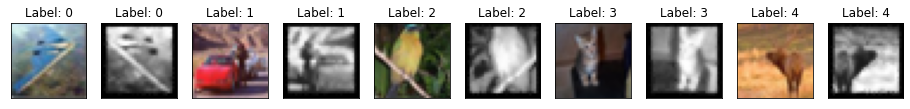

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


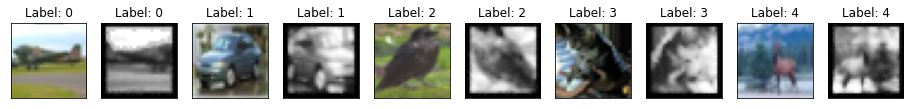

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


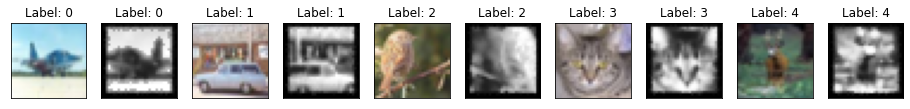

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


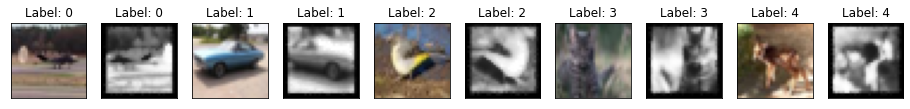

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


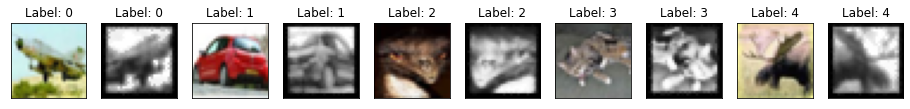

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.398923397064209  TestAcc: 0.521399974822998
ship 0.675
automobile 0.601
truck 0.583
horse 0.579
deer 0.574
airplane 0.524
frog 0.49
cat 0.481
dog 0.458
bird 0.249


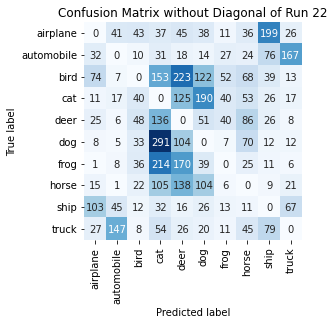

Summing down the rows, for Predictions of each Class that were wrong:  [ 296.  277.  252. 1053.  865.  604.  207.  418.  477.  337.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  223.0 times
Summing across the columns, for total number of that True Class misidentified:  [476. 399. 751. 519. 426. 542. 510. 421. 325. 417.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  136.0 times

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 

   Begin Run:  23 on Dataset TrainB_Zipped

 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23 23  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 ,

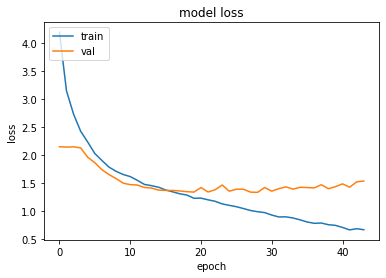

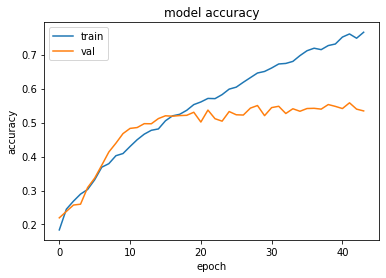

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  28 when  Val Loss was:  1.3328546285629272 , and Val Acc happened to be 0.5501000285148621
Additionally, the best val acc epoch happened to be  41 when val acc was:  0.5580999851226807 and Val Loss happened to be  1.4244894981384277
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


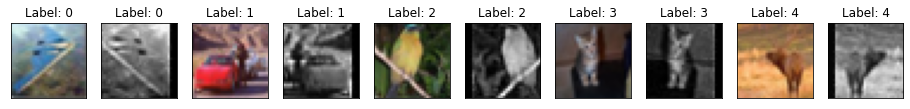

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


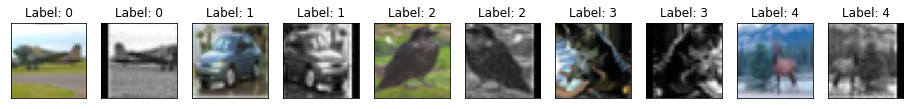

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


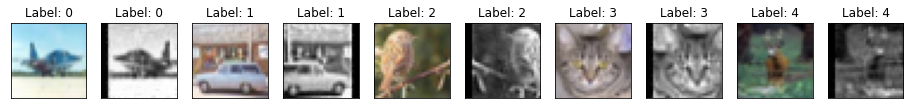

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


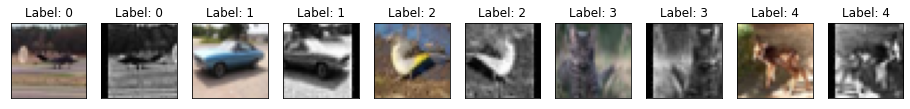

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


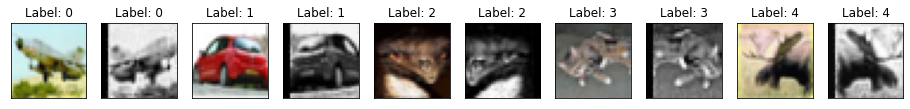

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.279268741607666  TestAcc: 0.5569000244140625
ship 0.742
automobile 0.692
horse 0.666
frog 0.642
deer 0.608
airplane 0.596
truck 0.587
dog 0.458
cat 0.346
bird 0.232


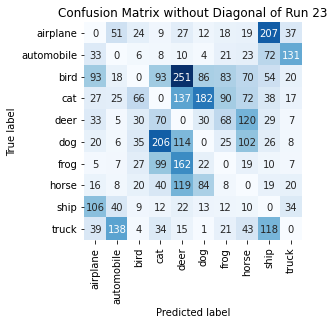

Summing down the rows, for Predictions of each Class that were wrong:  [372. 298. 221. 571. 857. 434. 346. 478. 573. 281.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  251.0 times
Summing across the columns, for total number of that True Class misidentified:  [404. 308. 768. 654. 392. 542. 358. 334. 258. 413.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  120.0 times

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 

   Begin Run:  24 on Dataset TrainB_Zipped

 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn

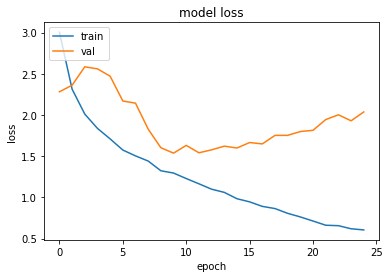

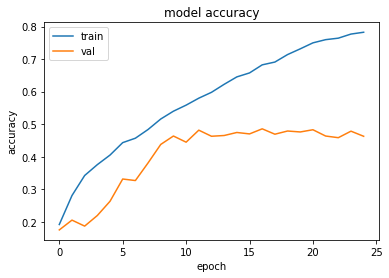

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  9 when  Val Loss was:  1.536102294921875 , and Val Acc happened to be 0.4634999930858612
Additionally, the best val acc epoch happened to be  16 when val acc was:  0.48559999465942383 and Val Loss happened to be  1.6482768058776855
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


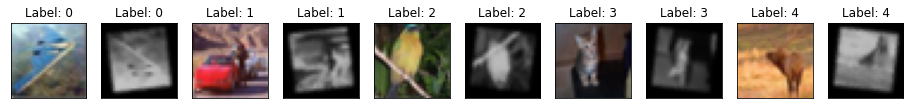

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


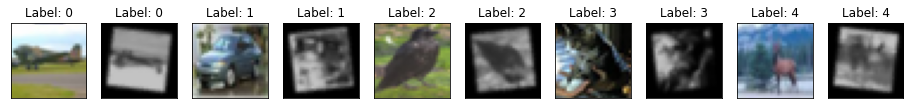

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


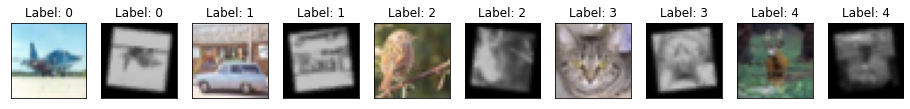

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


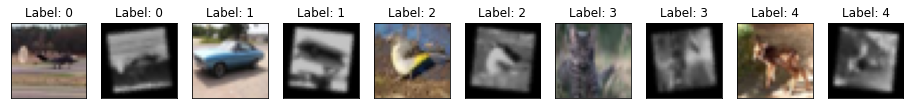

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


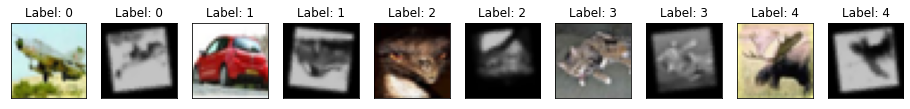

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4820889234542847  TestAcc: 0.478300005197525
ship 0.639
frog 0.629
airplane 0.565
automobile 0.508
horse 0.451
dog 0.436
deer 0.435
cat 0.39
truck 0.383
bird 0.347


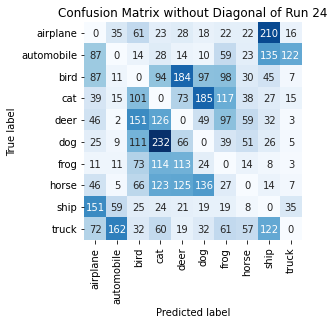

Summing down the rows, for Predictions of each Class that were wrong:  [564. 309. 634. 824. 643. 570. 539. 302. 619. 213.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  184.0 times
Summing across the columns, for total number of that True Class misidentified:  [435. 492. 653. 610. 565. 564. 371. 549. 361. 617.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  151.0 times

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 

   Begin Run:  25 on Dataset TrainB_Zipped

 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25 25  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.5
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 ,

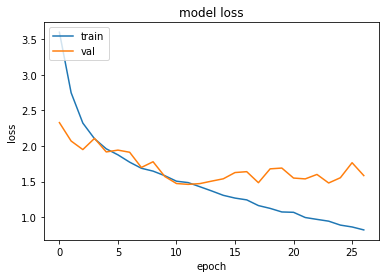

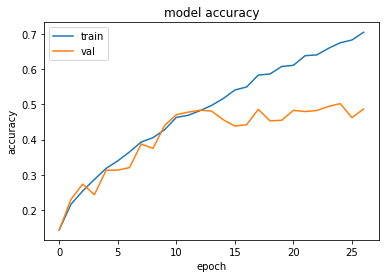

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  11 when  Val Loss was:  1.4616378545761108 , and Val Acc happened to be 0.47780001163482666
Additionally, the best val acc epoch happened to be  24 when val acc was:  0.5020999908447266 and Val Loss happened to be  1.5547441244125366
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


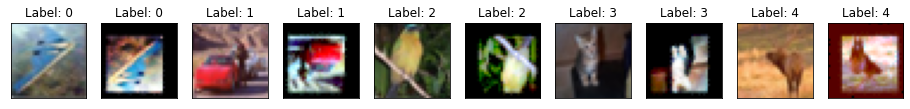

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


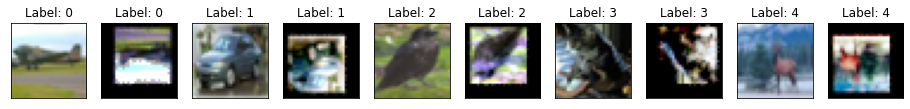

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


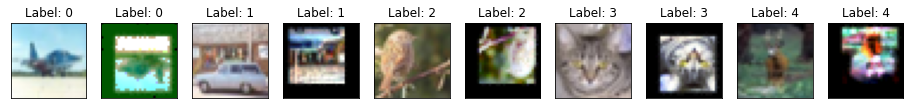

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


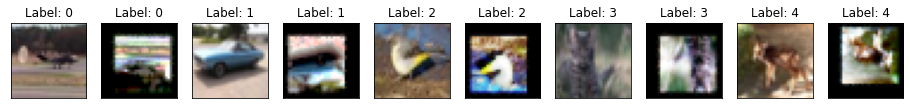

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


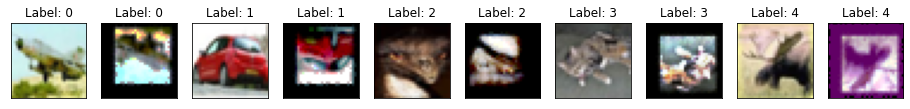

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4289153814315796  TestAcc: 0.48539999127388
frog 0.624
airplane 0.594
truck 0.558
automobile 0.531
ship 0.499
deer 0.492
dog 0.46
horse 0.406
bird 0.346
cat 0.344


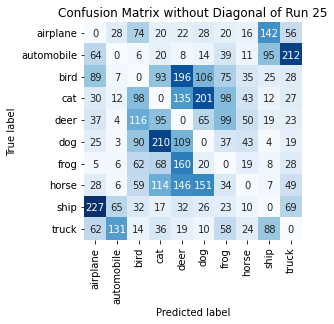

Summing down the rows, for Predictions of each Class that were wrong:  [567. 262. 551. 673. 827. 621. 483. 251. 400. 511.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  196.0 times
Summing across the columns, for total number of that True Class misidentified:  [406. 469. 654. 656. 508. 540. 376. 594. 501. 442.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  116.0 times

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 

   Begin Run:  26 on Dataset TrainB_Zipped

 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26 26  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , 

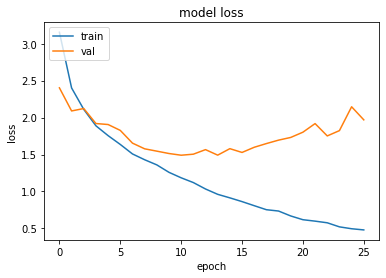

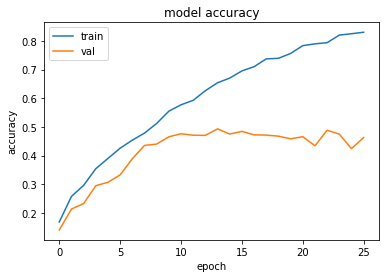

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.4903442859649658 , and Val Acc happened to be 0.47609999775886536
Additionally, the best val acc epoch happened to be  13 when val acc was:  0.49309998750686646 and Val Loss happened to be  1.4912809133529663
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


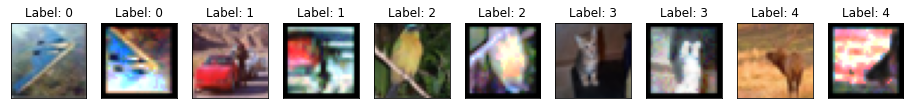

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


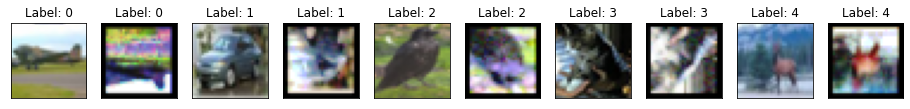

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


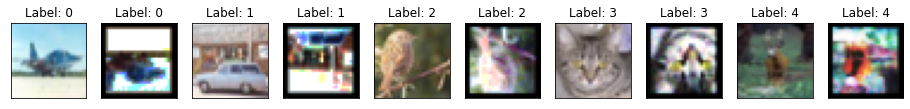

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


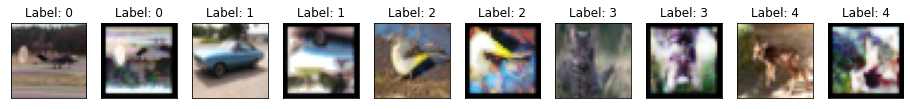

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


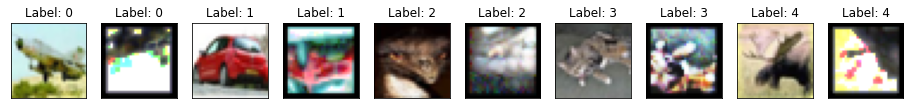

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4588909149169922  TestAcc: 0.4765999913215637
truck 0.654
frog 0.6
horse 0.583
automobile 0.563
ship 0.513
deer 0.472
cat 0.387
airplane 0.37
dog 0.344
bird 0.28


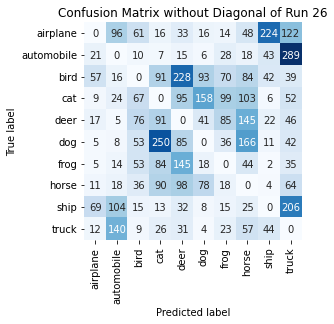

Summing down the rows, for Predictions of each Class that were wrong:  [206. 425. 380. 668. 762. 422. 388. 690. 398. 895.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  228.0 times
Summing across the columns, for total number of that True Class misidentified:  [630. 437. 720. 613. 528. 656. 400. 417. 487. 346.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  145.0 times

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 

   Begin Run:  27 on Dataset TrainB_Zipped

 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27 27  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 

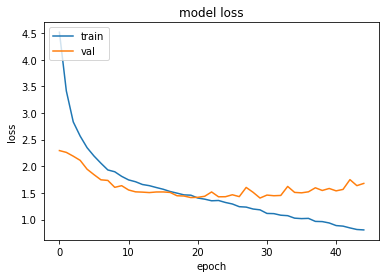

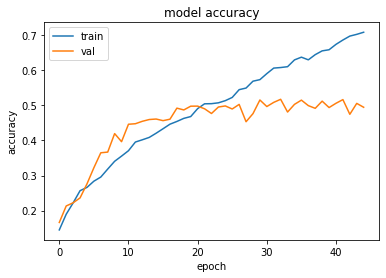

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  29 when  Val Loss was:  1.4033845663070679 , and Val Acc happened to be 0.5156999826431274
Additionally, the best val acc epoch happened to be  32 when val acc was:  0.5177000164985657 and Val Loss happened to be  1.4520128965377808
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


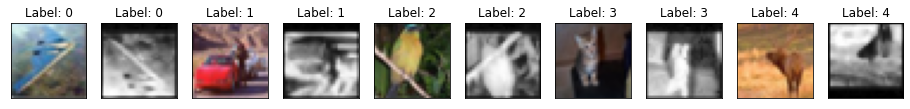

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


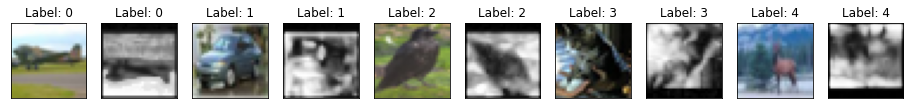

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


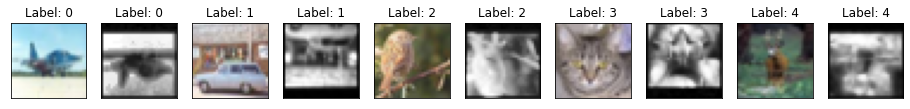

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


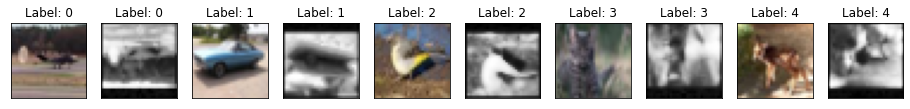

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


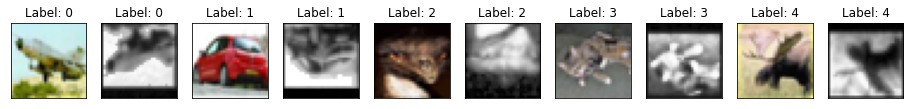

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3675134181976318  TestAcc: 0.515999972820282
automobile 0.626
ship 0.613
frog 0.589
truck 0.567
dog 0.558
horse 0.554
deer 0.503
airplane 0.453
bird 0.368
cat 0.329


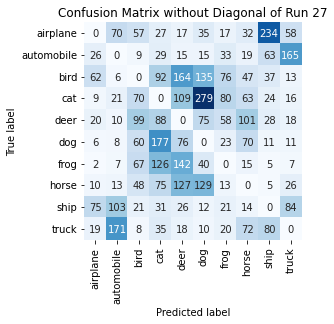

Summing down the rows, for Predictions of each Class that were wrong:  [229. 409. 439. 680. 694. 730. 341. 433. 487. 398.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  164.0 times
Summing across the columns, for total number of that True Class misidentified:  [547. 374. 632. 671. 497. 442. 411. 446. 387. 433.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  101.0 times

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 

   Begin Run:  28 on Dataset TrainB_Zipped

 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28 28  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 

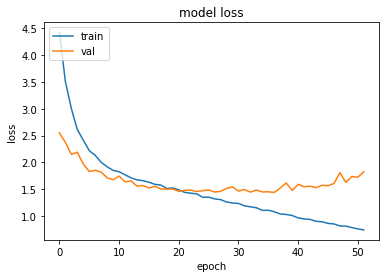

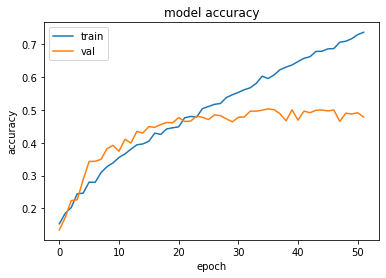

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  36 when  Val Loss was:  1.4383690357208252 , and Val Acc happened to be 0.5004000067710876
Additionally, the best val acc epoch happened to be  35 when val acc was:  0.5029000043869019 and Val Loss happened to be  1.4503090381622314
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


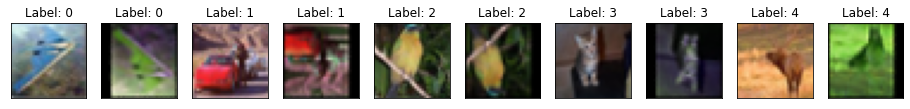

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


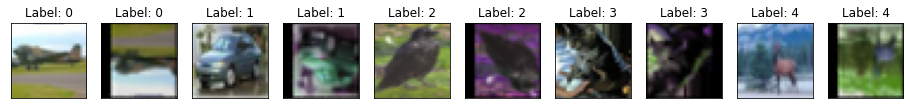

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


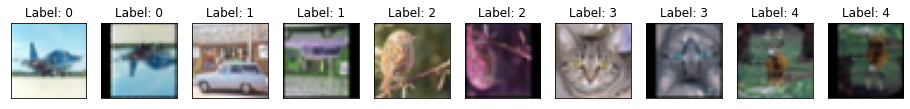

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


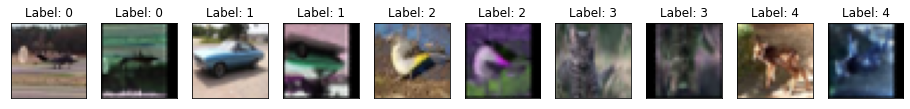

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


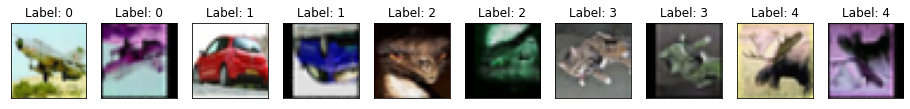

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4214370250701904  TestAcc: 0.501800000667572
automobile 0.698
airplane 0.658
frog 0.606
dog 0.576
horse 0.487
truck 0.467
ship 0.442
deer 0.416
bird 0.353
cat 0.315


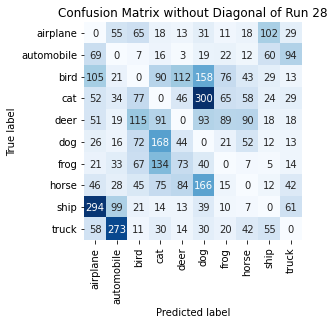

Summing down the rows, for Predictions of each Class that were wrong:  [722. 578. 480. 636. 402. 876. 329. 329. 317. 313.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  112.0 times
Summing across the columns, for total number of that True Class misidentified:  [342. 302. 647. 685. 584. 424. 394. 513. 558. 533.]
For example, the model misclassified true 4's (deer) as label   2 bird  a total of  115.0 times

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 

   Begin Run:  29 on Dataset TrainB_Zipped

 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29 29  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )
Z

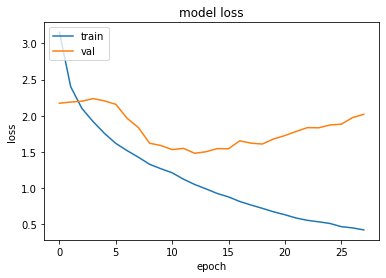

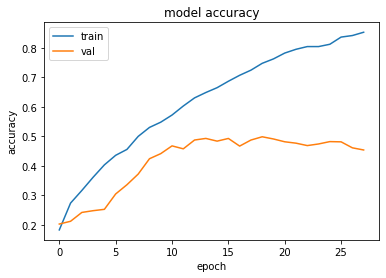

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.4807140827178955 , and Val Acc happened to be 0.4878999888896942
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.49889999628067017 and Val Loss happened to be  1.6084622144699097
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


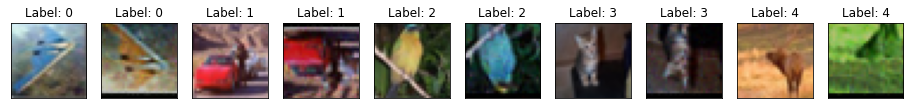

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


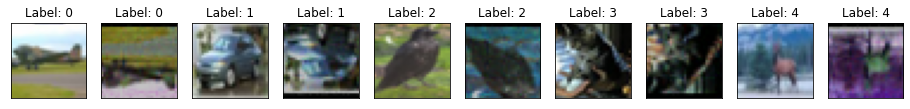

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


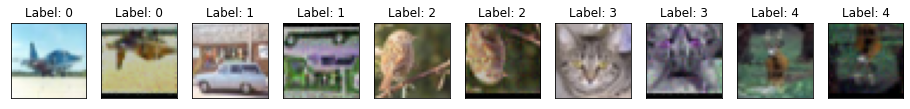

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


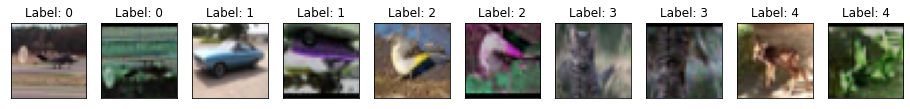

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


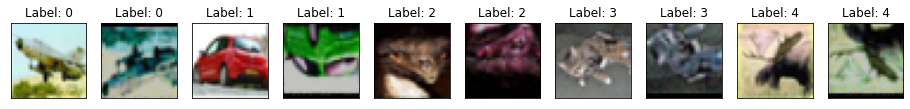

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4411038160324097  TestAcc: 0.49480000138282776
ship 0.673
truck 0.563
automobile 0.56
frog 0.546
horse 0.535
airplane 0.469
deer 0.442
dog 0.436
cat 0.39
bird 0.334


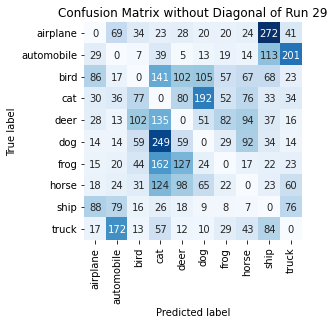

Summing down the rows, for Predictions of each Class that were wrong:  [325. 444. 383. 956. 529. 489. 318. 434. 686. 488.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  127.0 times
Summing across the columns, for total number of that True Class misidentified:  [531. 440. 666. 610. 558. 564. 454. 465. 327. 437.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  135.0 times

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 

   Begin Run:  30 on Dataset TrainB_Zipped

 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30 30  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn: 

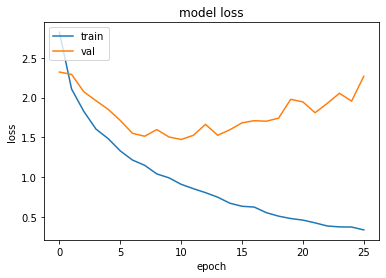

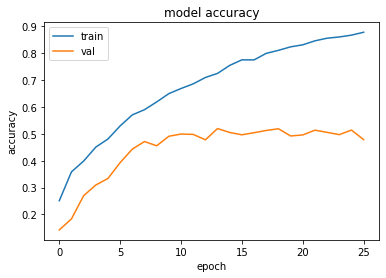

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.475356101989746 , and Val Acc happened to be 0.4991999864578247
Additionally, the best val acc epoch happened to be  13 when val acc was:  0.5196999907493591 and Val Loss happened to be  1.527669072151184
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


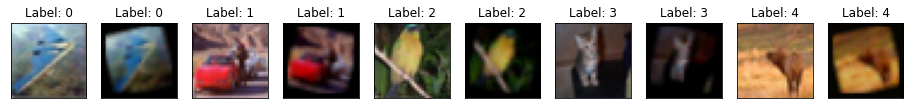

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


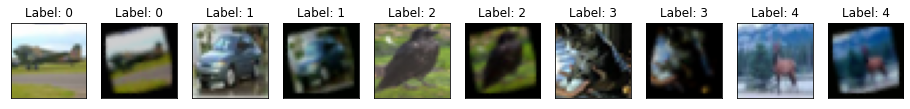

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


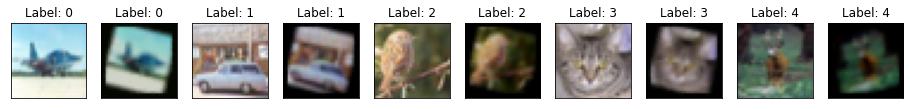

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


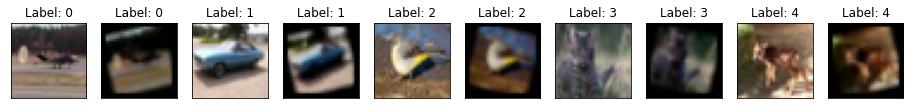

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


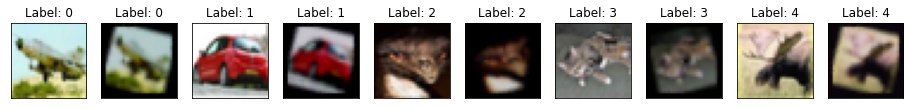

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4335074424743652  TestAcc: 0.508899986743927
automobile 0.713
airplane 0.658
horse 0.645
frog 0.636
deer 0.509
truck 0.433
ship 0.425
dog 0.408
cat 0.351
bird 0.311


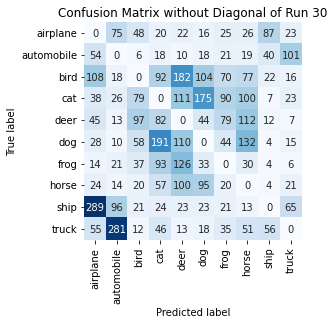

Summing down the rows, for Predictions of each Class that were wrong:  [655. 554. 378. 623. 697. 526. 405. 560. 236. 277.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  182.0 times
Summing across the columns, for total number of that True Class misidentified:  [342. 287. 689. 649. 491. 592. 364. 355. 575. 567.]
For example, the model misclassified true 4's (deer) as label   7 horse  a total of  112.0 times

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 

   Begin Run:  31 on Dataset TrainB_Zipped

 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 

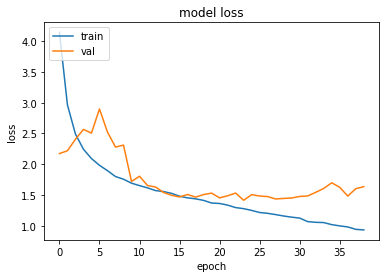

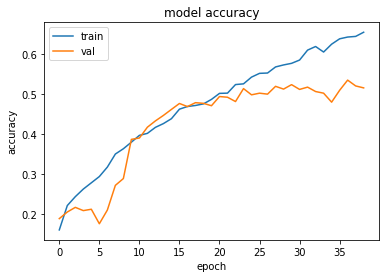

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  23 when  Val Loss was:  1.4138449430465698 , and Val Acc happened to be 0.5134999752044678
Additionally, the best val acc epoch happened to be  36 when val acc was:  0.5346999764442444 and Val Loss happened to be  1.48177969455719
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


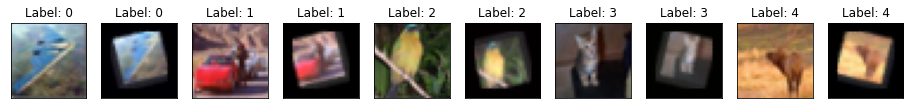

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


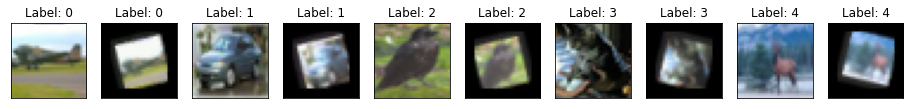

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


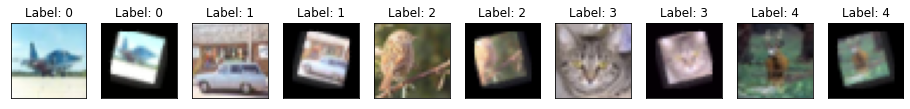

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


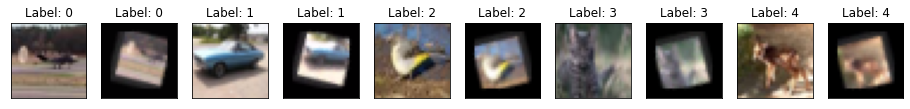

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


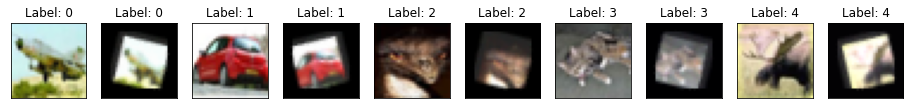

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.375084638595581  TestAcc: 0.5220000147819519
frog 0.791
automobile 0.681
ship 0.634
truck 0.591
horse 0.507
airplane 0.483
dog 0.45
cat 0.419
deer 0.348
bird 0.316


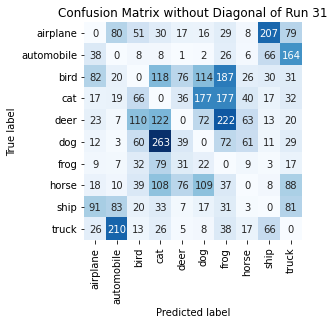

Summing down the rows, for Predictions of each Class that were wrong:  [316. 439. 399. 787. 288. 537. 819. 233. 421. 541.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  76.0 times
Summing across the columns, for total number of that True Class misidentified:  [517. 319. 684. 581. 652. 550. 209. 493. 366. 409.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  222.0 times

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 

   Begin Run:  32 on Dataset TrainB_Zipped

 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32 32  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )


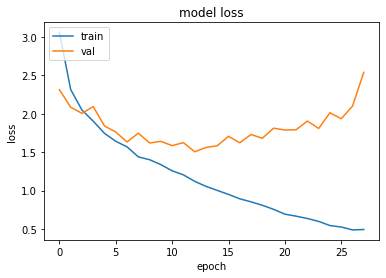

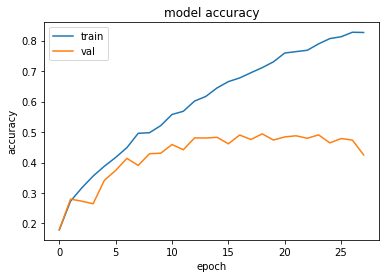

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  12 when  Val Loss was:  1.5044918060302734 , and Val Acc happened to be 0.48069998621940613
Additionally, the best val acc epoch happened to be  18 when val acc was:  0.49390000104904175 and Val Loss happened to be  1.6803531646728516
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


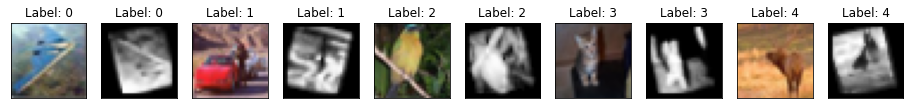

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


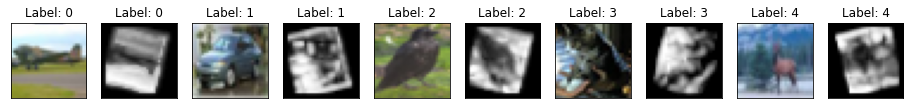

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


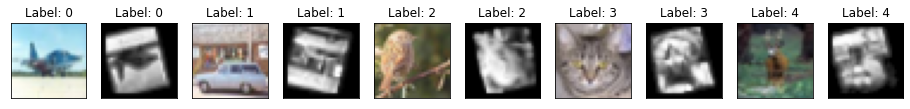

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


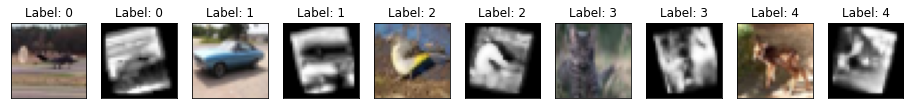

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


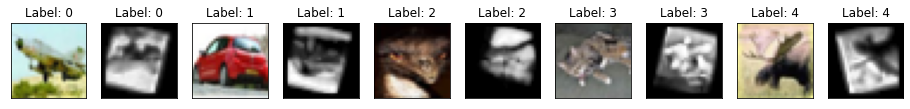

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.448760986328125  TestAcc: 0.4977000057697296
frog 0.727
deer 0.616
airplane 0.59
truck 0.569
automobile 0.556
ship 0.547
horse 0.528
dog 0.361
cat 0.266
bird 0.217


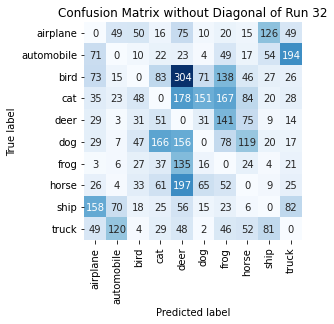

Summing down the rows, for Predictions of each Class that were wrong:  [ 473.  297.  268.  490. 1172.  365.  714.  438.  350.  456.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  304.0 times
Summing across the columns, for total number of that True Class misidentified:  [410. 444. 783. 734. 384. 639. 273. 472. 453. 431.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  141.0 times

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 

   Begin Run:  33 on Dataset TrainB_Zipped

 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33 33  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , -0.0 )

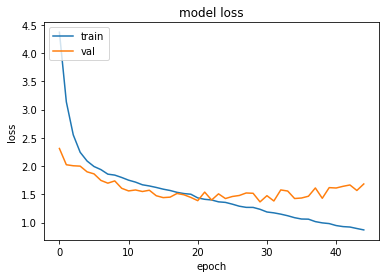

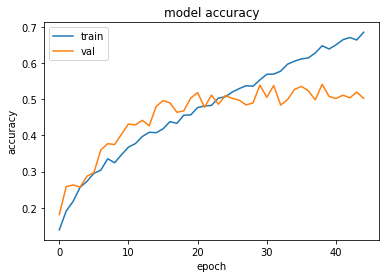

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  29 when  Val Loss was:  1.3661738634109497 , and Val Acc happened to be 0.5393000245094299
Additionally, the best val acc epoch happened to be  38 when val acc was:  0.541700005531311 and Val Loss happened to be  1.4298609495162964
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


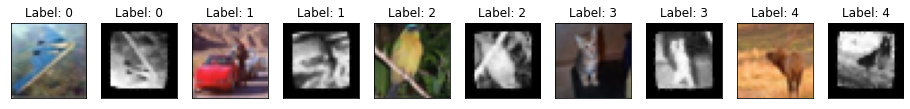

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


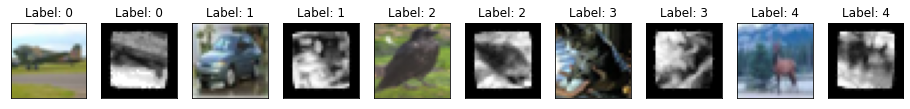

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


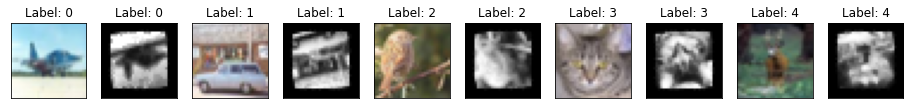

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


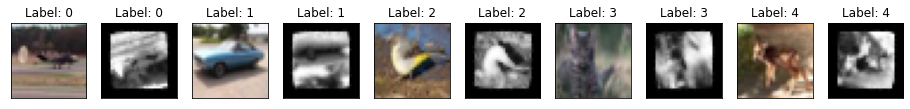

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


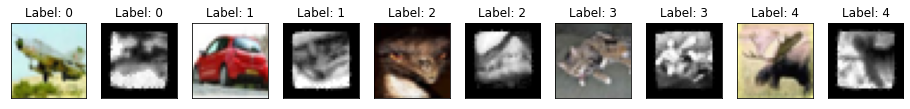

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3334349393844604  TestAcc: 0.5357999801635742
automobile 0.709
ship 0.662
horse 0.611
truck 0.559
frog 0.539
dog 0.537
airplane 0.513
deer 0.501
cat 0.381
bird 0.346


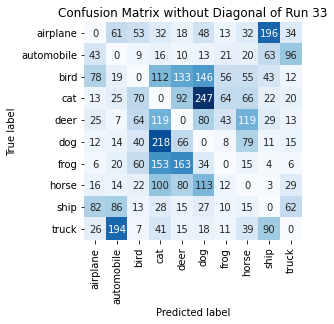

Summing down the rows, for Predictions of each Class that were wrong:  [301. 440. 338. 819. 592. 726. 238. 440. 461. 287.]
For example, the model predicted a  label 4 (deer) on a true   6  a total of  163.0 times
Summing across the columns, for total number of that True Class misidentified:  [487. 291. 654. 619. 499. 463. 461. 389. 338. 441.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  119.0 times

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 

   Begin Run:  34 on Dataset TrainB_Zipped

 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34 34  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )
ZoomIn: 

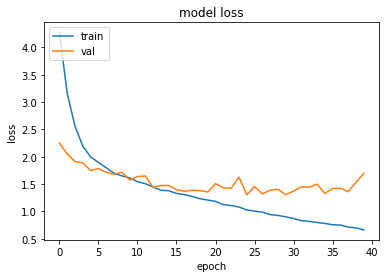

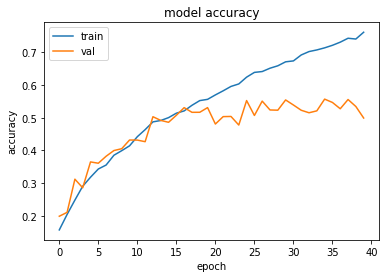

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  24 when  Val Loss was:  1.3043943643569946 , and Val Acc happened to be 0.5526999831199646
Additionally, the best val acc epoch happened to be  34 when val acc was:  0.5570999979972839 and Val Loss happened to be  1.3299061059951782
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


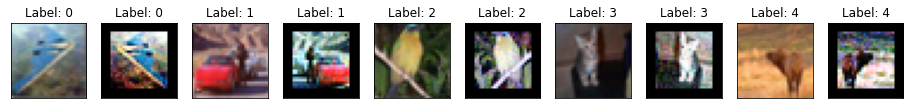

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


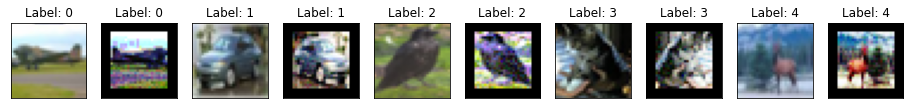

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


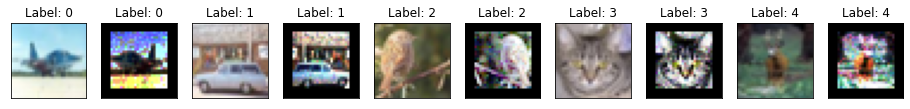

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


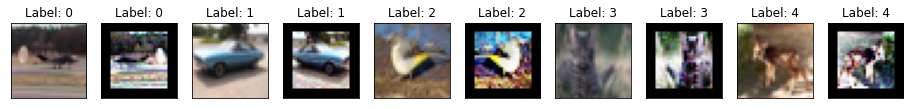

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


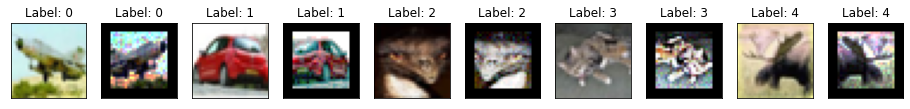

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.2911795377731323  TestAcc: 0.5457000136375427
ship 0.756
automobile 0.732
frog 0.647
horse 0.608
truck 0.572
dog 0.559
airplane 0.518
deer 0.442
cat 0.384
bird 0.239


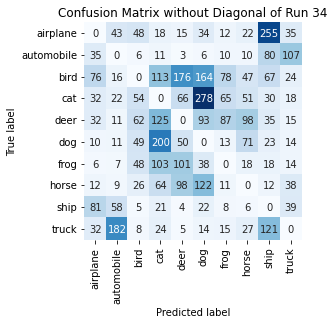

Summing down the rows, for Predictions of each Class that were wrong:  [316. 359. 306. 679. 518. 771. 299. 350. 641. 304.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  176.0 times
Summing across the columns, for total number of that True Class misidentified:  [482. 268. 761. 616. 558. 441. 353. 392. 244. 428.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  125.0 times

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 

   Begin Run:  35 on Dataset TrainB_Zipped

 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35 35  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.16 , -0.16 )


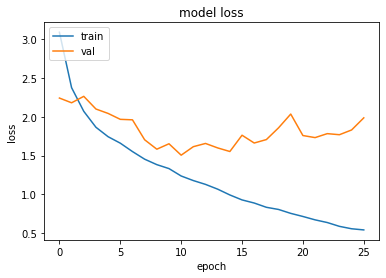

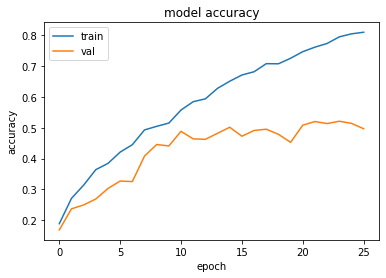

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.5043920278549194 , and Val Acc happened to be 0.4885999858379364
Additionally, the best val acc epoch happened to be  23 when val acc was:  0.521399974822998 and Val Loss happened to be  1.7685638666152954
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


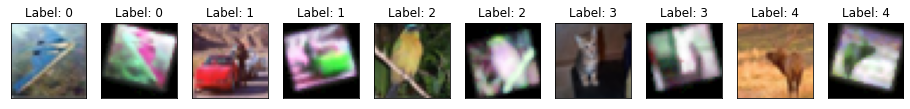

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


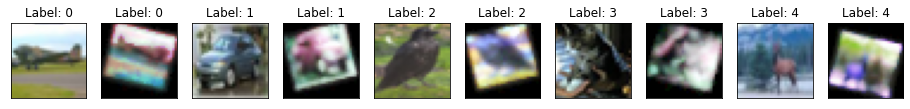

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


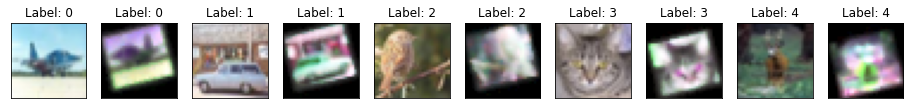

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


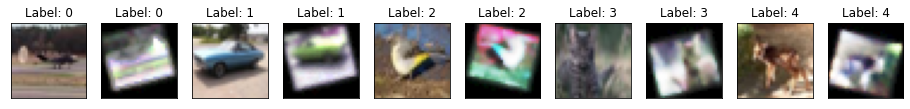

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


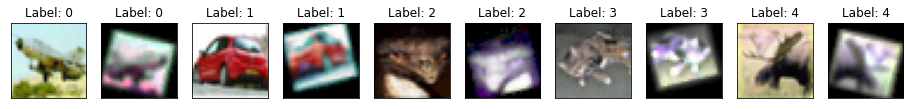

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4794018268585205  TestAcc: 0.49480000138282776
frog 0.794
ship 0.647
airplane 0.554
automobile 0.554
deer 0.5
truck 0.448
dog 0.426
horse 0.425
bird 0.319
cat 0.281


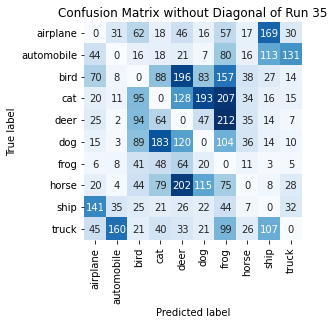

Summing down the rows, for Predictions of each Class that were wrong:  [ 386.  262.  487.  559.  836.  524. 1035.  220.  471.  272.]
For example, the model predicted a  label 4 (deer) on a true   7  a total of  202.0 times
Summing across the columns, for total number of that True Class misidentified:  [446. 446. 681. 719. 500. 574. 206. 575. 353. 552.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  212.0 times

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 

   Begin Run:  36 on Dataset TrainB_Zipped

 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.4
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.0 , 0.0 )or ( -0.0 , -0.0 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 

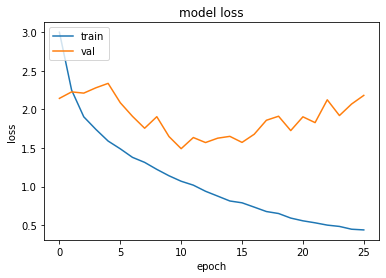

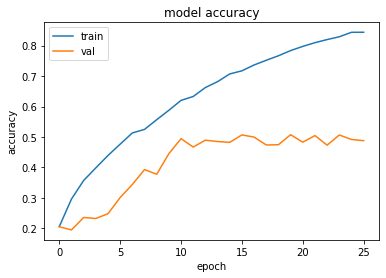

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  10 when  Val Loss was:  1.490593433380127 , and Val Acc happened to be 0.4945000112056732
Additionally, the best val acc epoch happened to be  19 when val acc was:  0.5076000094413757 and Val Loss happened to be  1.724671721458435
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


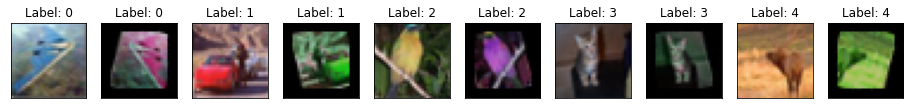

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


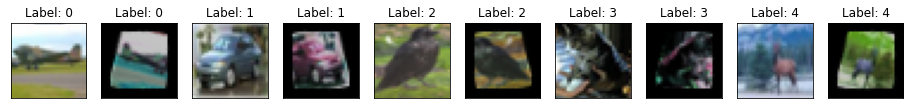

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


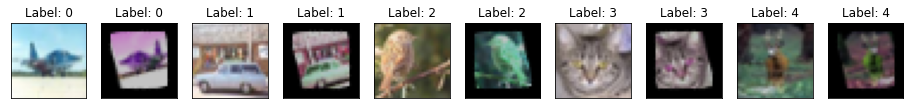

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


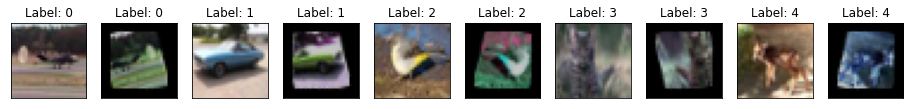

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


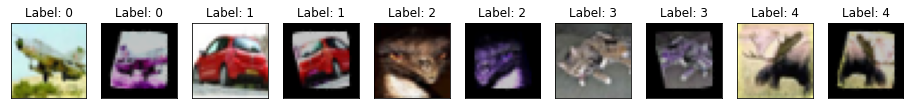

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.4171388149261475  TestAcc: 0.5026999711990356
frog 0.686
automobile 0.614
airplane 0.575
deer 0.575
ship 0.545
dog 0.522
horse 0.435
truck 0.43
bird 0.328
cat 0.317


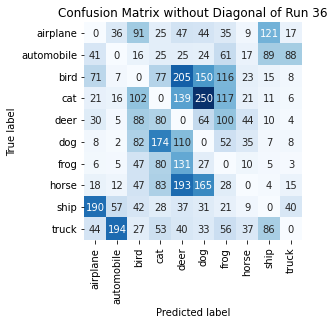

Summing down the rows, for Predictions of each Class that were wrong:  [429. 334. 542. 625. 927. 788. 586. 205. 348. 189.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  205.0 times
Summing across the columns, for total number of that True Class misidentified:  [425. 386. 672. 683. 425. 478. 314. 565. 455. 570.]
For example, the model misclassified true 4's (deer) as label   6 frog  a total of  100.0 times

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 

   Begin Run:  37 on Dataset TrainB_Zipped

 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37 37  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.125 , 0.125 ) or ( -0.125 , -0.125 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 120 , 120 )
ZoomOut:  ( -0.0 , 

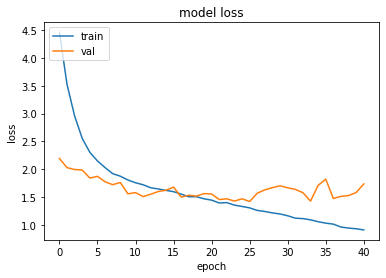

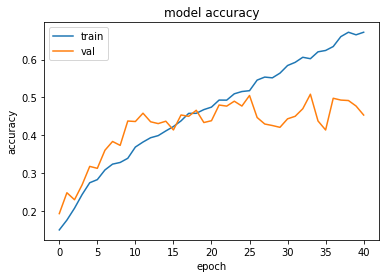

Early-Stop is on Val-Loss with patience = 15
Early Stop Epoch was:  25 when  Val Loss was:  1.416187047958374 , and Val Acc happened to be 0.5051000118255615
Additionally, the best val acc epoch happened to be  33 when val acc was:  0.5084999799728394 and Val Loss happened to be  1.4243710041046143
num: 250
Total:  250  batches in this dataset: newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
Showing first 10 images of the first five batches of  newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))
********************            Batch1 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


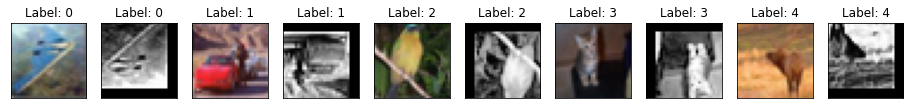

Batch  1 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch2 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


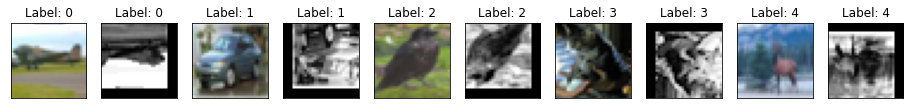

Batch  2 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch3 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


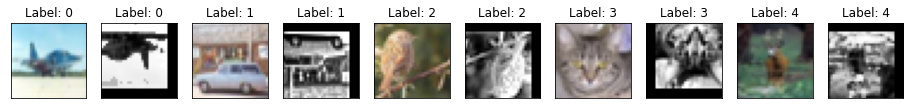

Batch  3 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch4 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


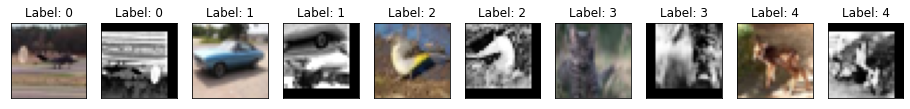

Batch  4 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

********************            Batch5 of newTrainX with zip2sets then passed to pp(make_zipped_batched(newTrainX))            ********************


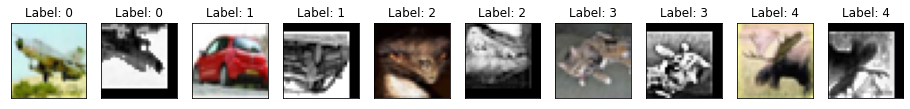

Batch  5 Class Count: (2, 2, 2, 2, 2, 2, 2, 2, 2, 2) 

**********************************************************************************************
TestLoss:  1.3919318914413452  TestAcc: 0.5042999982833862
frog 0.687
airplane 0.617
truck 0.6
automobile 0.588
horse 0.528
dog 0.489
deer 0.484
cat 0.413
ship 0.4
bird 0.237


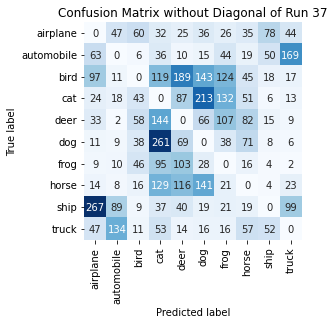

Summing down the rows, for Predictions of each Class that were wrong:  [565. 328. 287. 906. 653. 677. 529. 395. 235. 382.]
For example, the model predicted a  label 4 (deer) on a true   2  a total of  189.0 times
Summing across the columns, for total number of that True Class misidentified:  [383. 412. 763. 587. 516. 511. 313. 472. 600. 400.]
For example, the model misclassified true 4's (deer) as label   3 cat  a total of  144.0 times

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 

   Begin Run:  38 on Dataset TrainB_Zipped

 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38 38  

 ~ ~ ~  List of Run-Specific Parameters  ~ ~ ~ 
Dropout:   0.6
Shift X:  ( 0.0 , 0.0 ) or ( -0.0 , -0.0 )
Shift Y:  ( 0.125 , 0.125 )or ( -0.125 , -0.125 )
Gamma:    ( 100 , 100 )
ZoomOut:  ( -0.0 , -0.0 )
Zo

KeyboardInterrupt: ignored

In [ ]:
run_through_runs(ds=trainB, ds_noalb=trainB_noalb, dstitle = "TrainB_Zipped", showpictures=True)

In [ ]:
run_through_runs(ds=trainC, ds_noalb=trainC_noalb, dstitle = "TrainC_Zipped", showpictures=False)

NameError: ignored

In [ ]:
run_through_runs(ds=trainD, ds_noalb=trainD_noalb, dstitle = "TrainD_Zipped", showpictures=False)

In [ ]:
run_through_runs(ds=trainE, ds_noalb=trainE_noalb, dstitle = "TrainE_Zipped", showpictures=False)

In [ ]:
run_through_runs(ds=trainF, ds_noalb=trainF_noalb, dstitle = "TrainF_Zipped", showpictures=False)

In [ ]:
run_through_runs(ds=trainG, ds_noalb=trainG_noalb, dstitle = "TrainG_Zipped", showpictures=False)

In [ ]:
run_through_runs(ds=trainH, ds_noalb=trainH_noalb, dstitle = "TrainH_Zipped", showpictures=False)

## 4.2:  Groups of two: AB, CD, EF, GH, 

Merged Groups of 2 
1. Group1_A_B
2. Group2_C_D
3. Group3_E_F
4. Group4_G_H

then later.. 

Merged Groups of 4
1. Group1_a_b_c_d
2. Group2_e_f_g_h

and finally

1. Group_all



In [ ]:
# trainA_noalb + trainB_noalb
# combine datasets I believe I need to add trainA_noalb, and trainB_noalb or just trainA+trainB and then send through no_augmentations...

# pretty_display_of_dataset(trainAB, "AB", opttext="trainAB pictures") # works


# ~~~~~~~~~~ No Augment Versions: ~~~~~~~~~~~~~~~~~~~~~~
trainAB_noalb = make_noalb(trainAB, "AB")           # just testing AB now

 
# Uncomment when ready to run
trainCD_noalb = make_noalb(trainCD, "CD")
trainEF_noalb = make_noalb(trainEF, "EF")
trainGH_noalb = make_noalb(trainGH, "GH")

# # ---  Larger Groups of Four Single Groups ---
 

# # ~~~~~~~~~~ No Augment Versions: ~~~~~~~~~~~~~~~~~~~~~~
trainABCD_noalb = make_noalb(trainABCD, "ABCD")
trainEFGH_noalb = make_noalb(trainEFGH, "EFGH")

# # --- Largest Groups of Eight single Groups ---
trainALL = trainABCD.concatenate(trainEFGH, "ABCDEFGH")
trainALL_noalb = make_noalb(trainALL, "ABCDEFGH")
# groupnum=2
# new_trainX_batch = 10*groupnum  # to ensure you get all 10 categories  
# tot_new_trainX =   5000*groupnum # should be 250*10*2 = 5000  #for FIRST groups but not COMBINED GROUP RUNS = 10000
    

# pretty_display_of_dataset(trainAB_noalb, "AB_noalb") #works
# trainAB_alb = augment_data(dataset = trainAB, process= process_data, dataset_text = "Augmented Dataset", )
# new_trainAB = zip_2_sets(tuple_of_2_subsets_to_zip=(trainAB_noalb, trainAB_alb), opttext="NoAlb+Alb")
# new_trainAB_batched_shuffle = minibatch_shuffle_unbatch_cache_prefetch_bigbatch(new_trainAB, batch=new_trainX_batch, groupnum=2, SEED = 42)
# print(new_trainAB_batched_shuffle)  #prints 500.. batches of 10?
# count_images(new_trainAB_batched_shuffle)
# run_through_runs(ds=trainAB, ds_noalb=trainAB_noalb, dstitle = "TrainAB", groupnum = 2, showpictures=True, troubleshooting=True) #stops at batch2
# view_40_images(new_trainAB_batched_shuffle)
# view_40_images(make_unbatched(new_trainAB_batched_shuffle))  ##WORKS
# pretty_display_of_dataset(ds = make_unbatched(new_trainAB_batched_shuffle), dstitle="trainAB", opttext= str(("newTrainX batched and shuffled using groupnum=") + str(groupnum)), troubleshooting=True) 



trainAB_noalb made
NoAlb+Alb
<BatchDataset shapes: ((None, 32, 32, 3), (None,)), types: (tf.float32, tf.int64)>


In [ ]:
hasattr(trainAB, '_input_dataset')

# hasattr(trainA, '_input_dataset._input_dataset') 

<ConcatenateDataset shapes: ((32, 32, 3), ()), types: (tf.uint8, tf.int64)>

So far in my effort to concatenate groupA and groupB and run it through the model, it's taken at least 20 minutes to just count the number of images in each class, display the images, and another 5 minutes to run Run0 through the CNN.   At ~25 minutes per run it would take about ~1275 minutes per Group.  There are 7 more groups, that's 8925 minutes, or 148 hours.  Obviously I cant display images for each run or that would take forever.  At 33 minutes I'm not even done running Run 1.

Looking for a faster way to count the dataset, SO, user says \\
`ds.map(lambda x: 1, num_parallel_calls=tf.data.experimental.AUTOTUNE).reduce(tf.constant(0), lambda x,_: x+1) `

In [ ]:
# ds.map(lambda x: 1, num_parallel_calls=AUTOTUNE).reduce(tf.constant(0), lambda x: 1)

# 5. Post-Test: Process Results

After the 51 runs for the single groups have been run, its time to load the results into JMP to Fit the Definitive Screening Design and find which Main Effects have the most compeling effect.   

* I need to get my pickle files unloaded into a dataframe to put in a CSV.

* I had unintentionally created an effect that was captured by my blocking variable (early October?), but have since fixed it.  Original results here -- "[GroupA_Test1](https://github.com/RachelRamirez/CIFAR-10/blob/main/CollectionofTests/Test1GroupA.ipynb)" 



---



as of 11/11/21 its  ** ~9 hours** to run   9 Groups with 51 Runs, at about 45 epochs each.  If I ran it again with GroupA (10th GRoup) it would probably be about 10.5 hours total to this point.  Also note that is just training and capturing results, not diplaying any images thru augmentations, as displaying images and counting the number in each batch is extremely time consuming.  I think it makes one experimental run take at least 20 minutes, so  20times longer overall.

In [ ]:
import pickle
import numpy as np
import csv
# what does a flattened confuion matrix look like 


#define a list of the pickle files
list_of_pickle_file_names = ['runs_GroupB_final.pkl', 
                             'runs_GroupC_final.pkl', 
                             'runs_GroupD_final.pkl', 
                             'runs_GroupE_final.pkl', 
                             'runs_GroupF_final.pkl', 
                             'runs_GroupG_final.pkl', 
                             'runs_GroupH_final.pkl', 
                             'runs_GroupI_final.pkl', 
                             'runs_GroupJ_final.pkl']

list_of_group_names = ["B", "C", "D", "E", "F", "G", "H", "I", "J"]

# runsA, runsB, runsC, runsD, runsE, runsF, runsG, runsH, runsI, runsJ = {}, {} , {}, {}, {}, {}, {}, {}, {}, {} #is there a better way to define these many variables? 
# polease notice i left out runsA because I don't have the pickle file from the day B-G were run

runsA = runsB =  runsC = runsD = runsE = runsF =  runsG =  runsH =  runsI =  runsJ = []

# list_of_unpickled_names = [runsB, runsC, runsD, runsE, runsF, runsG, runsH, runsI, runsJ]
# Later? Create a dictionary by zipping together two lists itno tuples
# fields = ["Seed", "Group", "Run", "TestAcc", "TestLoss", "ConfusionMatrix"]
# values = [42, "Z", 999, 0.0, 0.0, [range(100)]]
# a_dict = dict(zip(fields, values))
# a_dict
 
ds = {}

#for enumerate () zip the 9 pickle files:
for Z, pkl, in zip(list_of_group_names, list_of_pickle_file_names): #list_of_unpickled_names):
  
  with open(pkl, 'rb') as fid:
     ds[Z] = pickle.load(fid)
  print("dataset", Z, " loaded from", pkl)

#To reference a Group say ds["Letter"][RunInt]["Metric"]
 
#can i just replace it Group , and each run, with this function? It'd be ice if i could map it.. versus a for loop of doomr
rows = []
for i in (list_of_group_names):
  for run in range(0,51):             #<!!---------------------------------------------------------------------------------- change back to 51
    cm_flat = (ds[i][run]["CM"]).flatten(order="C")
    # cm_norm_flat = (ds[i][run]["CM_norm"]).flatten(order="C")
    print(cm_flat)
    cm_flat_new = cm_flat.flatten()
    # print("new", cm_flat_new)
    # row = [i, run, ds[i][run]["CM"], ds[i][run]["CM_norm"] ]
    # rows.append(row)


print(rows)

#Check ds["B"][23]["CM_norm"] #yup
 
# -------------------------------------------------------------------------------------- 
# How to put information in a CSV file?
# Try this: https://www.tutorialspoint.com/How-to-save-a-Python-Dictionary-to-CSV-file
#
# --------------------------------------------------------------------------------------

counter = 0
import csv
# my dictionary is ds
with open('allgroups_allruns_seed42.csv', 'w') as f:
  for key in ds.keys():
    for key2 in ds[key].keys():
      (key3, key4, key5, key6)  = ds[key][key2].keys()
      


      # Working Code don't tinker wth!
      cm_flat = np.array(ds[key][key2][key5]).flatten()
      cm_norm_flat = np.array(ds[key][key2][key6]).flatten()
      csvwriter=csv.writer(f, delimiter="," )
      # the prob with below is it doesnt give each item in the cm its own column 
      # so i refere to SO and found this https://stackoverflow.com/questions/67125762/convert-an-array-column-into-multiple-columns-python
      csvwriter.writerow([key, key2, ds[key][key2][key3], ds[key][key2][key4],  cm_flat, cm_norm_flat   ])

# https://stackoverflow.com/questions/67125762/convert-an-array-column-into-multiple-columns-python


#to save space i need key3 to all print on one line, otherwise excel csv file will be 10*51*4*10*10 rows = ~20,000 rows? bc flatten hasnt yet worked on cm and cm_norm

# Create Data frame?

# import pandas as pd
# df_B = pd.DataFrame( data=ds['B'],   )
 
break



# new_dictionary = {'Group':                 
#                   {'Run': 
#                    {
#                   'TestAcc': 'Value',
#                   'TestLoss': 'Value',
#                   'CM': [],
#                   'CM_norm': []}}}

# new_dictionary['Group']
# new_dictionary_list_of_metrics = 'TestAcc', 'TestLoss', 'CM', 'CM_norm'
# ds["B"][3]




# my dictionary is ds
with open('allgroups_allruns_seed42.csv', 'w') as f:


counter = 0
new_dataframe = []

for key1_group in ds.keys():
    for key2_run in ds[key1_group].keys():
      for key3_metrics, newdict_metric in zip(ds[key1_group][key2_run].keys(), new_dictionary_list_of_metrics):
        # new_dictionary[key1_group][key2_run][newdict_metric] = ds[key1_group][key2_run][key3_metrics]
        counter +=1
        #ok now i realize i did things correctly after all because this is an exact replicate of what I already have... arrrrrrrrrggggggg
    print(counter)





#the first key of "key3" is TestAccuracy


# from collections import defaultdict
# d = defaultdict(list)
# for k, v in ds['B'].items():
#     d[v].append(k)
# printdict(d))

break

files.download("allgroups_allruns_seed42.csv")
# Desire the following format 1-SeedCol, 2-GroupCol, 3-RunCol, 4-TestAcc-Col, 5-TestLossCol, (6,105)100 Columns CM, (106, 205) 100 Columns CM_norm 
#[Seed#] [Group_Letter {A-J}] [Run#] [TestAccuracy] [TestLoss] [Flatten 10X10 Confusion Matrix into 1x100]
 
 #lets see how close... oh good lord that's ugly... 





  #this file originally saved 11-5-2021 from 1 each testset

# lastruns_groupA_loaded

# string_of_cm = " "
# y = {}

# # test
# # string_of_cm = string_of_cm + np.array2string(lastruns_groupA_loaded[0]["CM"][0][0]) + " "
# print("Run ,", "Test Accuracy ,", "Test Loss,", "Confusion Matrix Diagonals," "Normalized Confusion Matrix" )
 
# CM_digit = []

# for i in range(0,ENDRUNS):
#   for x in range(0,10):
#     #string_of_cm = string_of_cm + np.array2string(lastruns_groupA_loaded[i]["CM"][x][x]) + ", "
#     CM_digit = lastruns_groupA_loaded[i]["CM"][x][x] + CM_digit
#   y[i] = lastruns_groupA_loaded[i]['TestAccuracy'], lastruns_groupA_loaded[i]["TestLoss"], CM_digit 
#   print(y[i])
#   CM_digit = [] #clear?

# lastruns_groupA_loaded[1]["TestAccuracy"]
# lastruns_groupA_loaded[1]["CM"][:,0].sum()  #666 Predicted Class 0?
# lastruns_groupA_loaded[1]["CM"][0,:].sum()  #1000 True Class 0?
# lastruns_groupA_loaded[1]["CM"][1,:].sum()  #1000 True Class 1?

# sum_of_cm_diagonals = 0
# for i in range(10):
#   sum_of_cm_diagonals = sum_of_cm_diagonals + lastruns_groupA_loaded[1]["CM"][i,i]    

# print("Sum of Diagonals on Confusion Matrix of Run 1: ", sum_of_cm_diagonals) #checks with TestAccuracy


# #I want to find the area of greatest confusion

# #create a new matrix to not ruin previious CM
# confusion_matrix_wo_diagonal = lastruns_groupA_loaded[1]["CM"].copy()
 
# for i in range(10):
#   confusion_matrix_wo_diagonal[i,i] = 0 # set the diagonal equal to zero
# print(confusion_matrix_wo_diagonal)
# # for i in range(10):
# #   print(i, "is most often miscategorized as ", np.argmax(confusion_matrix_wo_diagonal[:,i]), " ", max(confusion_matrix_wo_diagonal[:,i]), " times")

# for i in range(10):
#   print("The algorithm predicted a ", np.argmax(confusion_matrix_wo_diagonal[i,:]),"instead of a ",  i, " ", max(confusion_matrix_wo_diagonal[i,:]), "times")



# print("Summing down the rows, for COLUMN total: ", confusion_matrix_wo_diagonal.sum(axis=0))
# print("Summing across the columns, for ROW total: ", confusion_matrix_wo_diagonal.sum(axis=1))

In [ ]:
# https://www.tutorialspoint.com/python-convert-list-of-nested-dictionary-into-pandas-dataframe
# Example
import pandas as pd


#print(list)
rows = []

# appending rows
for key in dictionary_fruit.keys():
   data_row = dictionary_fruit[key]
   n = data['Name']

   for row in data_row:
      row['Name'] = n
      rows.append(row)

   # using data frame
df = pd.DataFrame(rows)

df = df.pivot_table(index='Name', columns=['Quality'],
               values=['Price']).reset_index()
print(df)


something weird about the above code.  My confusion matrix looks like its lost the diagonals. I think copying to confusion_matrix_wo_diagonal didn't do a separate copy, it is just linked, so when I cleared the diagonal of confusion_matrix_wo_diagonal, it also cleared it from lastruns_groupsA_loaded[1]["CM"]


In [ ]:
lastruns_groupA_loaded[0]["CM"]

In [ ]:
confusion_matrix_wo_diagonal.sum() + sum_of_cm_diagonals

In [ ]:
# string_of_cm = ""

# for i in range(1,2):  # goes through first n runs with CMs
#   for x in range(10): # goes through the n items in diagonal of each run.CM
#     string_of_cm = string_of_cm + np.array2string(lastruns_groupA_loaded[i]["CM"][x][x]) + ","
#     y[i] = lastruns_groupA_loaded[i]['TestAccuracy'], lastruns_groupA_loaded[i]["TestLoss"], string_of_cm 
#   print(y[i])
  

# lastruns_groupA_loaded[1]["TestAccuracy"]
# lastruns_groupA_loaded[1]["CM"][:,0].sum()  #666 Predicted Class 0
# lastruns_groupA_loaded[1]["CM"][0,:].sum()  #1000 True Class 0
# lastruns_groupA_loaded[1]["CM"][1,:].sum()  #1000 True Class 1

# sum_of_cm_diagonals = 0
# for i in range(10):
#   sum_of_cm_diagonals = sum_of_cm_diagonals + lastruns_groupA_loaded[1]["CM"][i,i]    

# print("Sum of Diagonals on Confusion Matrix of Run 1: ", sum_of_cm_diagonals) #checks with TestAccuracy


# #I want to find the area of greatest confusion

# #create a new matrix to not ruin previious CM
# confusion_matrix_wo_diagonal = lastruns_groupA_loaded[1]["CM"].copy()
 
# for i in range(10):
#   confusion_matrix_wo_diagonal[i,i] = 0 # set the diagonal equal to zero
# print(confusion_matrix_wo_diagonal)
# # for i in range(10):
# #   print(i, "is most often miscategorized as ", np.argmax(confusion_matrix_wo_diagonal[:,i]), " ", max(confusion_matrix_wo_diagonal[:,i]), " times")

# for i in range(10):
#   print("The algorithm predicted a ", np.argmax(confusion_matrix_wo_diagonal[i,:]),"instead of a ",  i, " ", max(confusion_matrix_wo_diagonal[i,:]), "times")



# print("Summing down the rows, for COLUMN total: ", confusion_matrix_wo_diagonal.sum(axis=0))
# print("Summing across the columns, for ROW total: ", confusion_matrix_wo_diagonal.sum(axis=1))



---



## Time Required: 10 hours



In [ ]:
stop_testing = time.time()
print((stop_testing - tic) , "secs to  run everything start to end, or... ")
print((stop_testing - tic)/60, "minutes ... or ")
print((stop_testing - tic)/3600, "hours ")